# People counting project
## Gloria Desideri & Julie Aguilar

 How to run:
 - Create a folder in your drive with the dataset
 - change the datapath if needed with the path to that the folder



In [1]:
from google.colab import drive
drive.mount('/content/drive') #mounting google drive
DATAPATH= "/PerceptionAI/data"
DS1= 'CROSS_X-F1-B1_P880043_20200625111459_225'
DS2= 'CROSS_X-F1-B1_P880043_20200625111459_225_2'
DS3= 'CROSS_X-F1-B1_P880043_20200625111459_225_3'

Mounted at /content/drive


In [ ]:
%ls

drive/  sample_data/


In [31]:
# imports
#from google.colab.patches import cv2_imshow
import cv2
import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt

from scipy import ndimage
from PIL import Image
import glob
import imutils

import os


0: ./depths/CROSS_X-F1-B1_P880043_20200625111459_225_cs001_00241.png
1: ./depths/CROSS_X-F1-B1_P880043_20200625111459_225_cs001_00136.png
2: ./depths/CROSS_X-F1-B1_P880043_20200625111459_225_cs001_00256.png
3: ./depths/CROSS_X-F1-B1_P880043_20200625111459_225_cs001_00121.png
4: ./depths/CROSS_X-F1-B1_P880043_20200625111459_225_cs001_00253.png
5: ./depths/CROSS_X-F1-B1_P880043_20200625111459_225_cs001_00247.png
6: ./depths/CROSS_X-F1-B1_P880043_20200625111459_225_cs001_00130.png
7: ./depths/CROSS_X-F1-B1_P880043_20200625111459_225_cs001_00124.png
8: ./depths/CROSS_X-F1-B1_P880043_20200625111459_225_cs001_00118.png
9: ./depths/CROSS_X-F1-B1_P880043_20200625111459_225_cs001_00244.png
10: ./depths/CROSS_X-F1-B1_P880043_20200625111459_225_cs001_00250.png
11: ./depths/CROSS_X-F1-B1_P880043_20200625111459_225_cs001_00127.png
12: ./depths/CROSS_X-F1-B1_P880043_20200625111459_225_cs001_00133.png
13: ./depths/CROSS_X-F1-B1_P880043_20200625111459_225_cs001_00154.png
14: ./depths/CROSS_X-F1-B1_P88

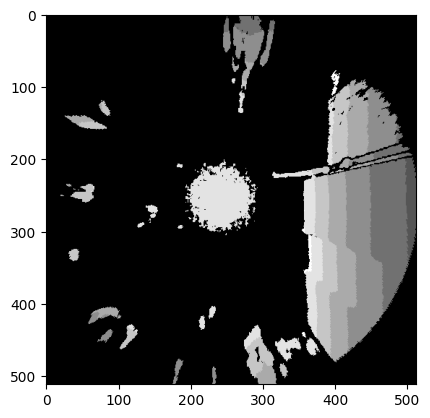

In [37]:
# Load ToF image
images_normalized=[]

#Gloria path
#for filename in glob.glob('/content/drive/MyDrive/PerceptionAI/data/depths/*.png'):
i=0
#Julie Path
for filename in glob.glob('./depths/*.png'):
    #print("here")
    frame = cv2.imread(filename)

    # Normalize the image
    img_normalized = cv2.normalize(frame, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    images_normalized.append(img_normalized)
    # Display the normalized image
    print(f"{i}: {filename}")
    
    plt.imshow(img_normalized)
    # if cv2.waitKey(1) & 0xFF == ord('q'):
    #         break
    i=i+1

# Close all windows
#cv2.destroyAllWindows()

In [3]:
cv2.destroyAllWindows()

#### Thresholding methods
The initial idea was to extract only the values between 254 and 170 but my code has been deleted

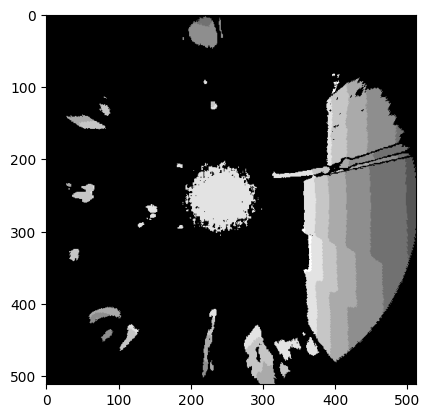

In [38]:
plt.imshow(images_normalized[48])

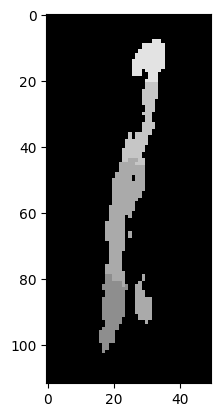

In [25]:

# Crop the image
cropped_image = images_normalized[48][400:512, 200:250]
plt.imshow(cropped_image)

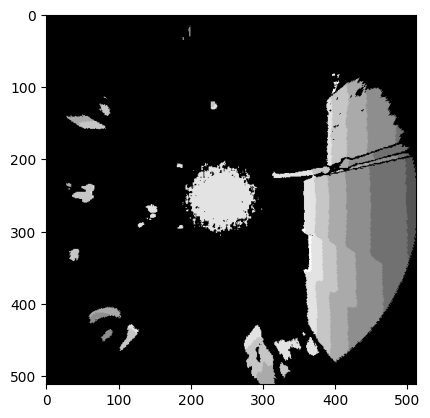

In [34]:
images_normalized[48][0:100, 200:250]=0
images_normalized[48][400:512, 200:250]=0
plt.imshow(images_normalized[48])

In [35]:
#bg
bg= images_normalized[48]


In [36]:
cv2.imwrite('./bg.png', bg)

True

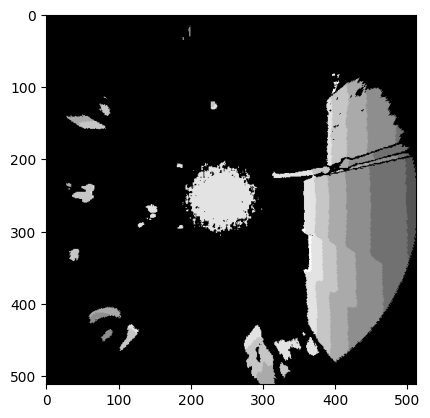

In [39]:
bg= cv2.imread('./bg.png')
plt.imshow(bg)

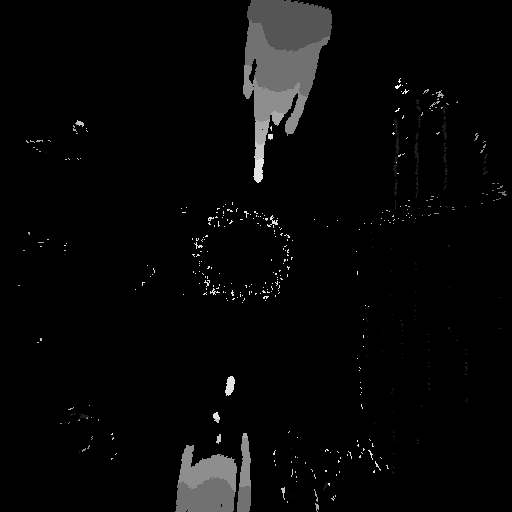

In [8]:
result=cv2.subtract(images_normalized[1], bg)
plt.imshow(result)

In [9]:
images_normalized.pop(36)

array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)

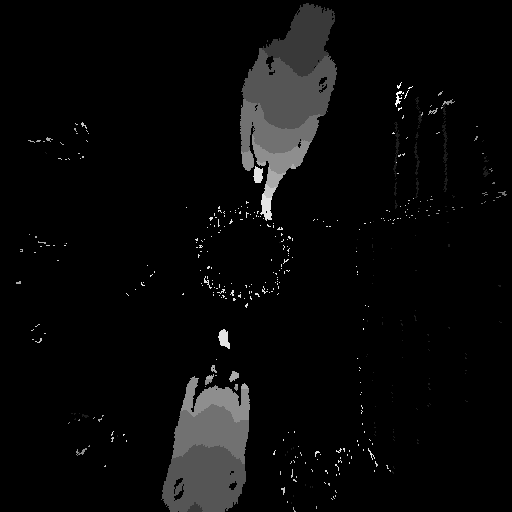

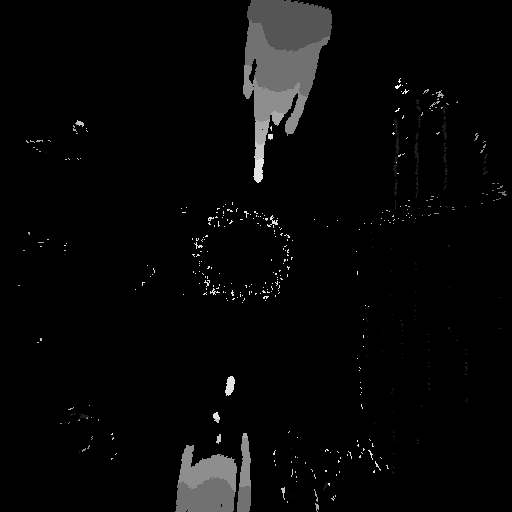

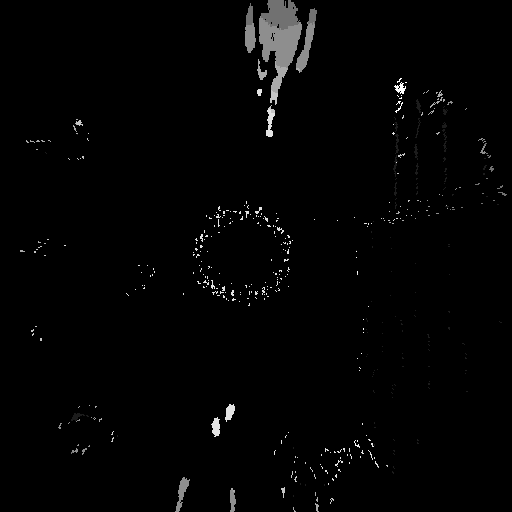

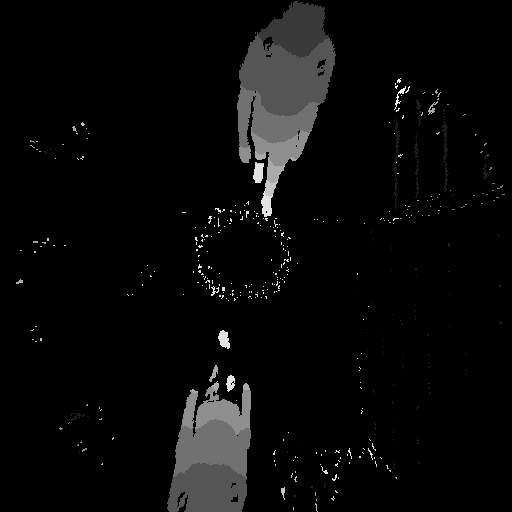

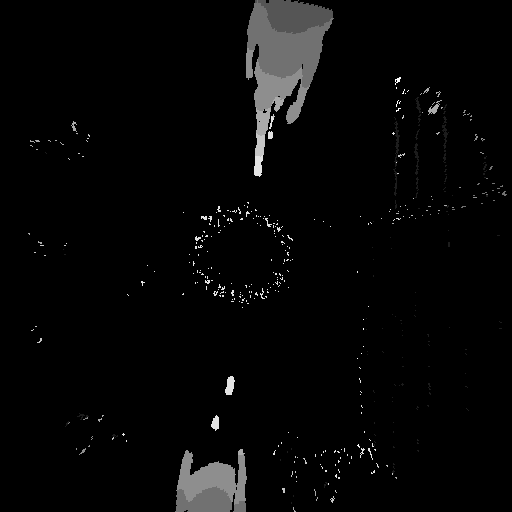

...

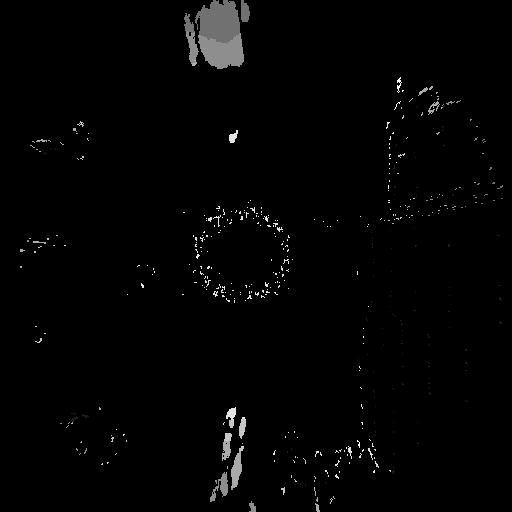

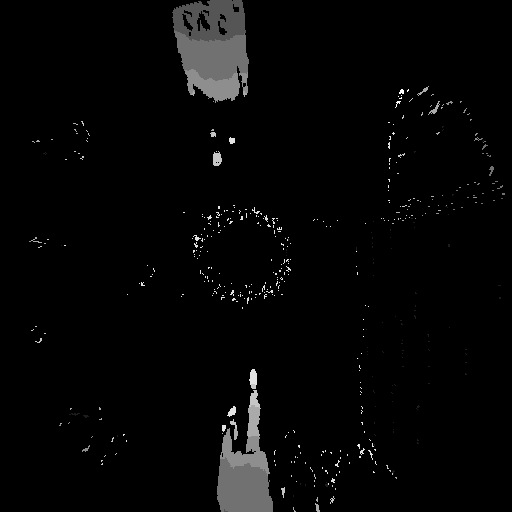

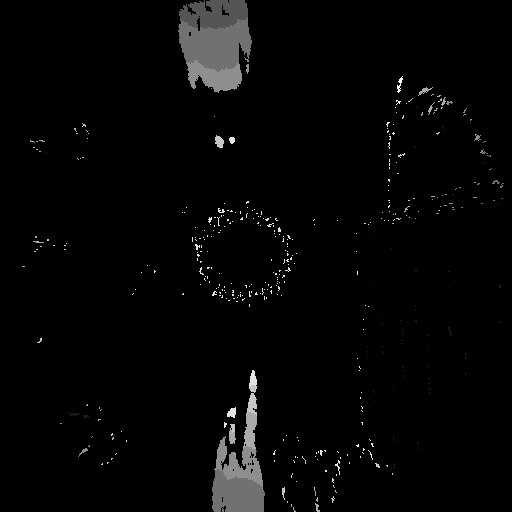

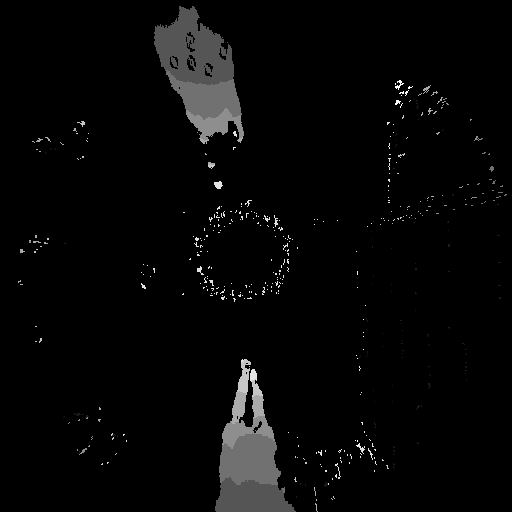

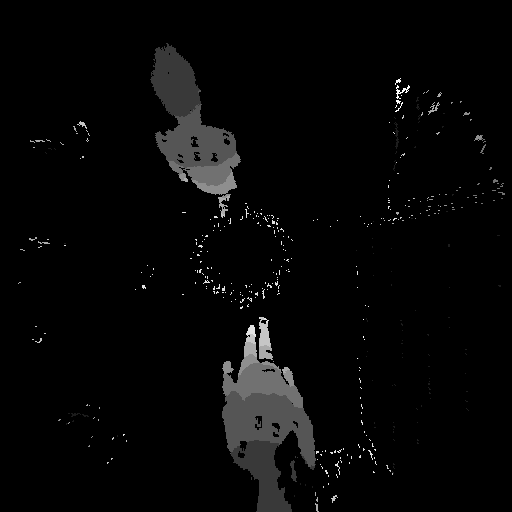

In [10]:
for i in range(len(images_normalized)):
  images_normalized[i]= cv2.subtract(images_normalized[i], bg)
for image_n in images_normalized:
  cv2_imshow(image_n)
  cv2.waitKey(0)

In [ ]:
#findcontours
#connected component labeling
images_normalized[0].shape

(512, 512, 3)

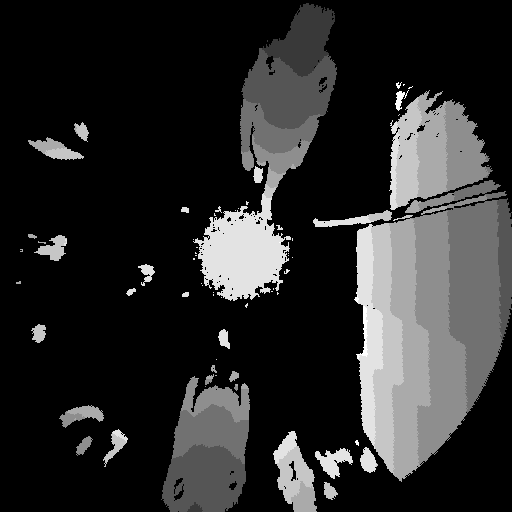

In [ ]:
cv2_imshow(images_normalized[0])

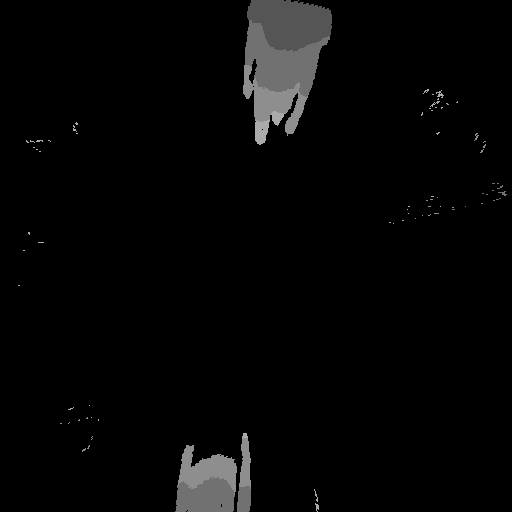

In [11]:
#first method I try is to retrieve with a single filter knowing that the camera is positioned at 255 centimeters from the ground I get everithing between 170 and 254
depth_map = images_normalized[1][:, :, 2]

# Set the lower and upper thresholds for filtering
lower_threshold = 30
upper_threshold = 180

# Create a binary mask based on the threshold values
binary_mask = cv2.inRange(depth_map, lower_threshold, upper_threshold)

# Apply the binary mask to the original image to extract the filtered pixels
filtered_image = cv2.bitwise_and(depth_map, depth_map, mask=binary_mask)

# Display the original and filtered images
#cv2_imshow(depth_map)
cv2_imshow( filtered_image)
cv2.waitKey(0)
cv2.destroyAllWindows()

In [12]:
#good but I still get the wall
contours, hierarchy  = cv2.findContours(filtered_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
contour_image = np.copy(images_normalized[0])
for i, contour in enumerate(contours):
    area = cv2.contourArea(contour)
    print(f"Area of Object {i + 1}: {area} square units")




Area of Object 1: 9.5 square units
Area of Object 2: 4.0 square units
Area of Object 3: 3.0 square units
Area of Object 4: 3052.0 square units
Area of Object 5: 1.5 square units
Area of Object 6: 0.0 square units
Area of Object 7: 693.0 square units
Area of Object 8: 0.0 square units
Area of Object 9: 0.0 square units
Area of Object 10: 0.0 square units
Area of Object 11: 0.5 square units
Area of Object 12: 0.0 square units
Area of Object 13: 0.5 square units
Area of Object 14: 1.0 square units
Area of Object 15: 0.0 square units
Area of Object 16: 0.0 square units
Area of Object 17: 0.0 square units
Area of Object 18: 0.0 square units
Area of Object 19: 1.5 square units
Area of Object 20: 0.0 square units
Area of Object 21: 0.0 square units
Area of Object 22: 0.0 square units
Area of Object 23: 0.0 square units
Area of Object 24: 0.0 square units
Area of Object 25: 0.0 square units
Area of Object 26: 0.0 square units
Area of Object 27: 0.0 square units
Area of Object 28: 0.0 square un

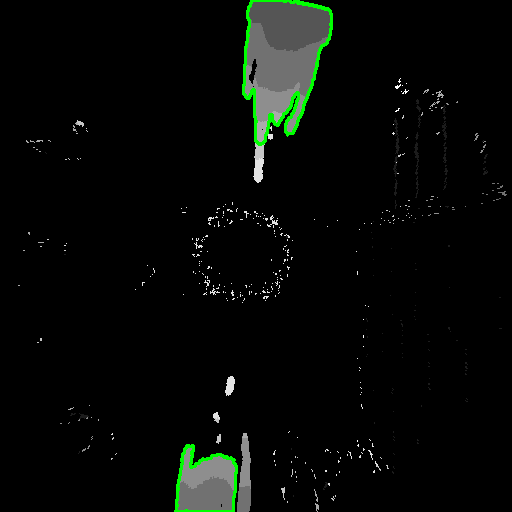

In [13]:
# Draw contours on the original image
contour_image = np.copy(images_normalized[1])
filtered_contours = [contour for contour in contours if 3000 < cv2.contourArea(contour) < 9000]

cv2.drawContours(contour_image, filtered_contours, -1, (0, 255, 0), 2)
cv2_imshow(contour_image)


In [14]:
def show_image(image):
    cv2_imshow(image)
    c = cv2.waitKey()
    if c >= 0 : return -1
    return 0

Area of Object 1 of image 0: 8644.0 square units
Area of Object 2 of image 0: 11258.5 square units
------------------------------------------------------------


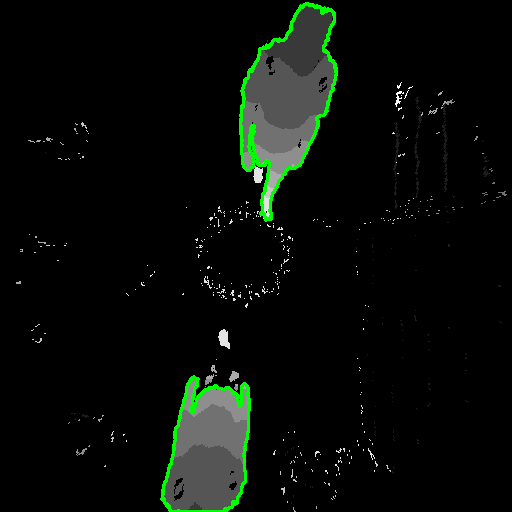

Area of Object 1 of image 1: 3052.0 square units
Area of Object 2 of image 1: 693.0 square units
Area of Object 3 of image 1: 8762.0 square units
------------------------------------------------------------


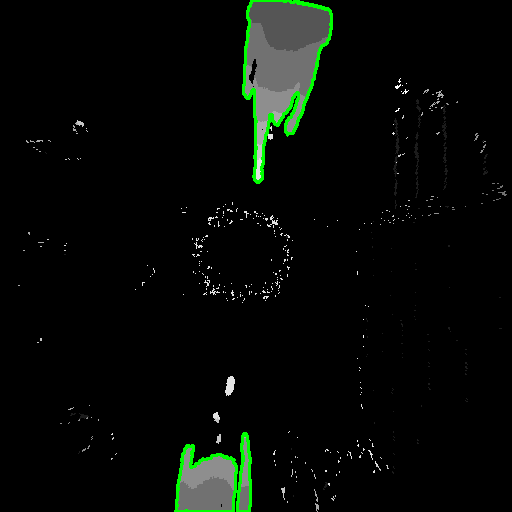

Area of Object 1 of image 2: 2295.0 square units
------------------------------------------------------------


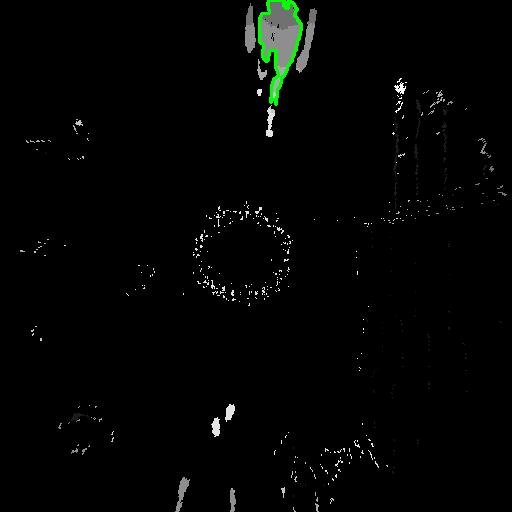

Area of Object 1 of image 3: 7876.0 square units
Area of Object 2 of image 3: 11623.5 square units
------------------------------------------------------------


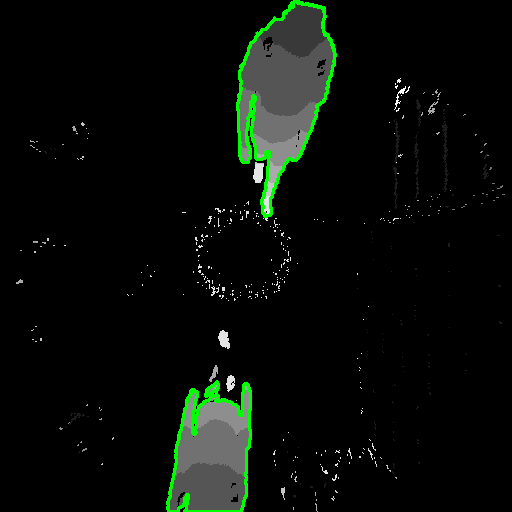

Area of Object 1 of image 4: 3080.0 square units
Area of Object 2 of image 4: 7457.0 square units
------------------------------------------------------------


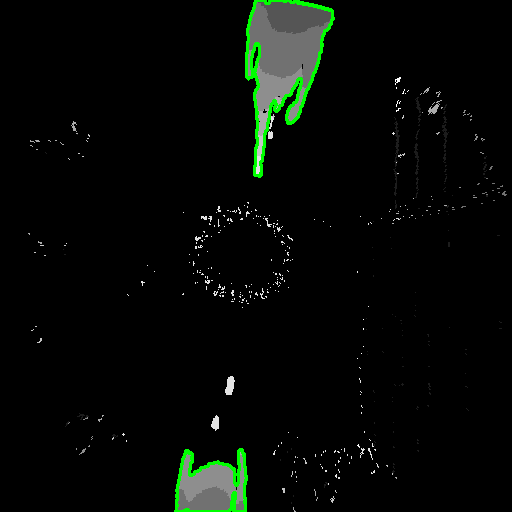

Area of Object 1 of image 5: 626.0 square units
Area of Object 2 of image 5: 3258.5 square units
------------------------------------------------------------


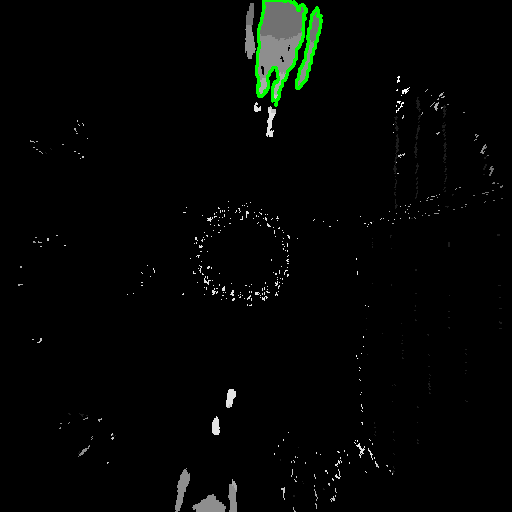

Area of Object 1 of image 6: 6046.0 square units
Area of Object 2 of image 6: 11732.5 square units
------------------------------------------------------------


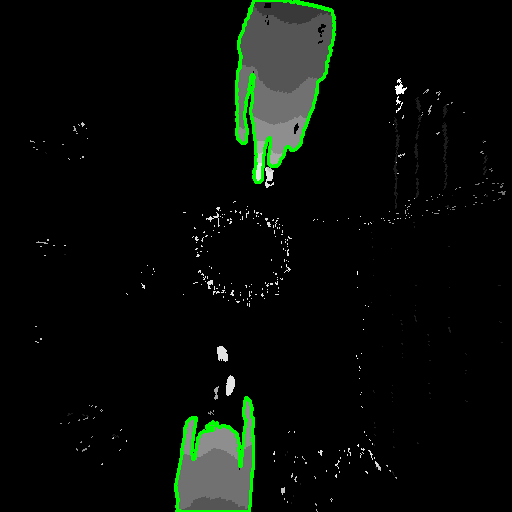

Area of Object 1 of image 7: 2446.5 square units
Area of Object 2 of image 7: 6308.5 square units
------------------------------------------------------------


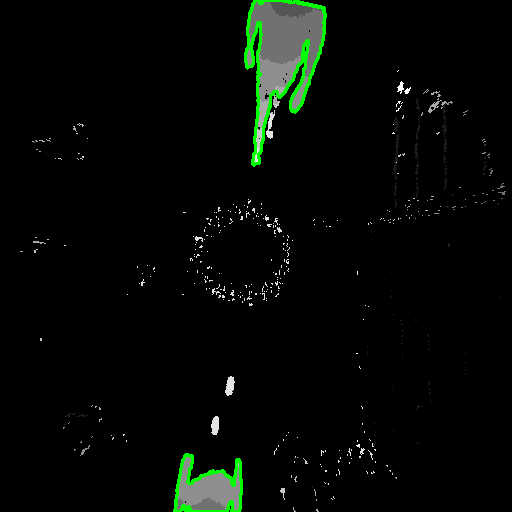

Area of Object 1 of image 8: 1716.0 square units
Area of Object 2 of image 8: 889.0 square units
Area of Object 3 of image 8: 3860.5 square units
------------------------------------------------------------


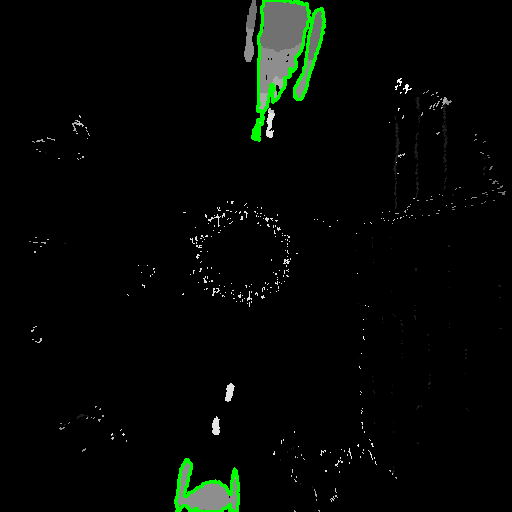

Area of Object 1 of image 9: 9492.0 square units
Area of Object 2 of image 9: 11632.5 square units
------------------------------------------------------------


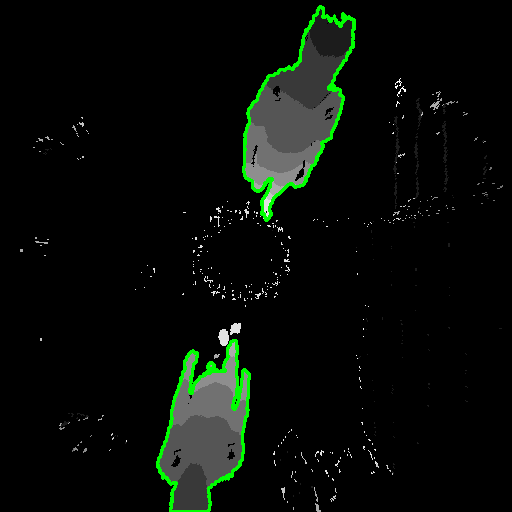

Area of Object 1 of image 10: 5141.0 square units
Area of Object 2 of image 10: 10939.5 square units
------------------------------------------------------------


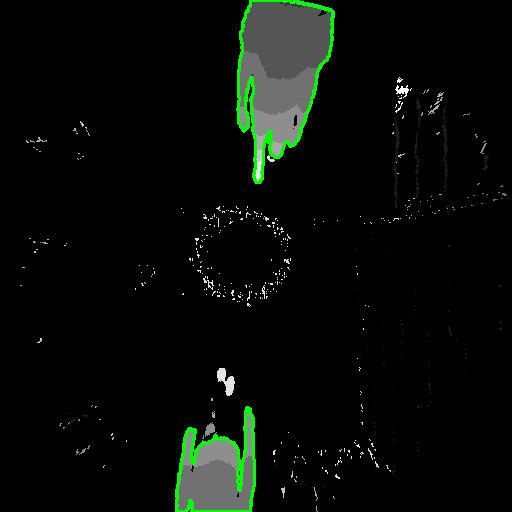

Area of Object 1 of image 11: 7030.5 square units
Area of Object 2 of image 11: 12238.5 square units
------------------------------------------------------------


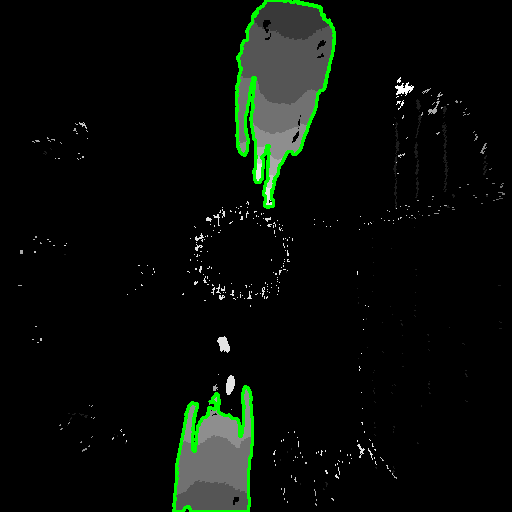

Area of Object 1 of image 12: 3563.0 square units
Area of Object 2 of image 12: 874.0 square units
Area of Object 3 of image 12: 9958.5 square units
------------------------------------------------------------


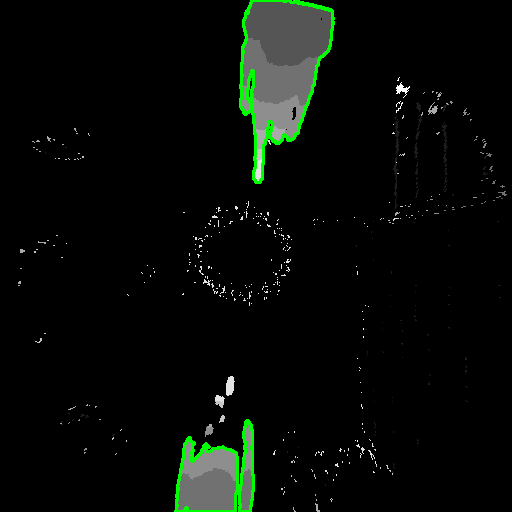

Area of Object 1 of image 13: 9247.0 square units
Area of Object 2 of image 13: 11396.5 square units
------------------------------------------------------------


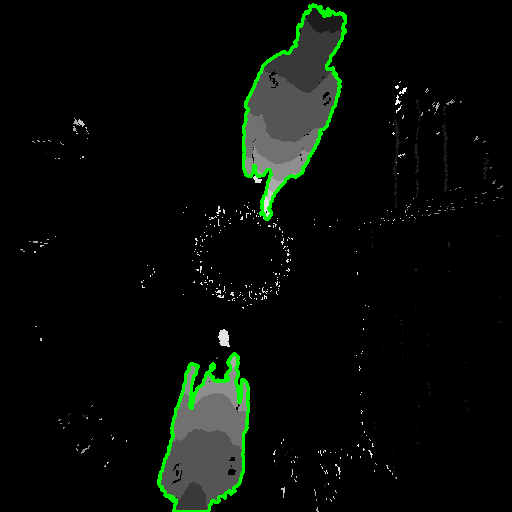

Area of Object 1 of image 14: 3140.0 square units
Area of Object 2 of image 14: 3812.5 square units
------------------------------------------------------------


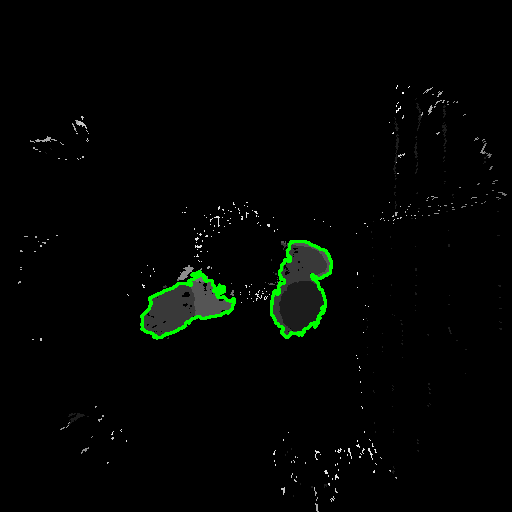

Area of Object 1 of image 15: 3466.0 square units
Area of Object 2 of image 15: 3314.5 square units
------------------------------------------------------------


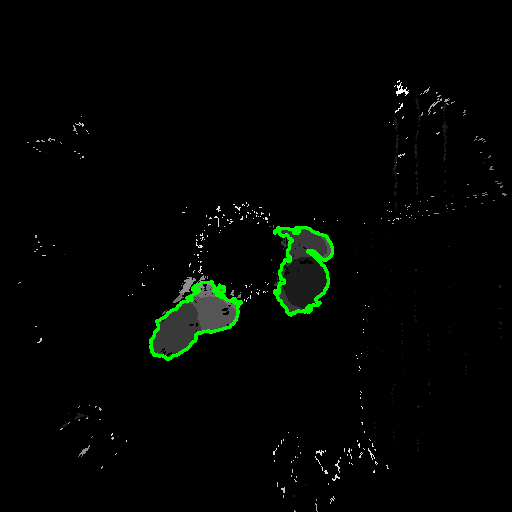

Area of Object 1 of image 16: 6942.5 square units
Area of Object 2 of image 16: 3752.5 square units
------------------------------------------------------------


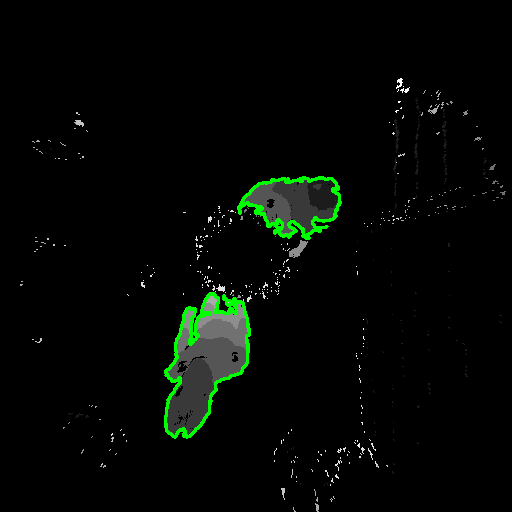

Area of Object 1 of image 17: 5777.5 square units
Area of Object 2 of image 17: 2379.5 square units
------------------------------------------------------------


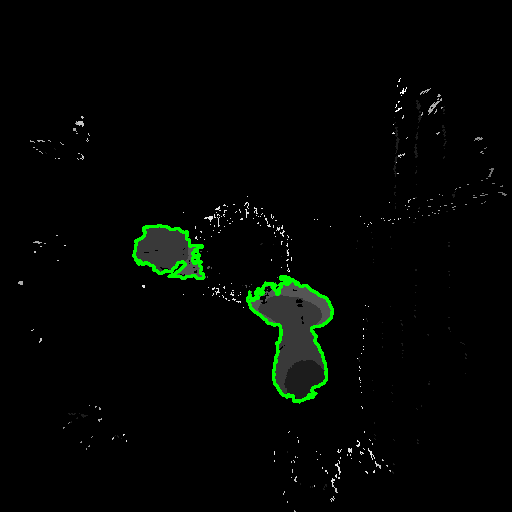

Area of Object 1 of image 18: 8945.5 square units
Area of Object 2 of image 18: 6908.0 square units
------------------------------------------------------------


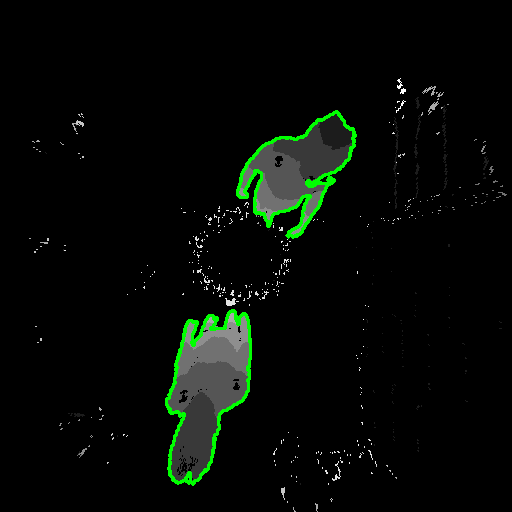

Area of Object 1 of image 19: 4368.5 square units
Area of Object 2 of image 19: 2954.5 square units
------------------------------------------------------------


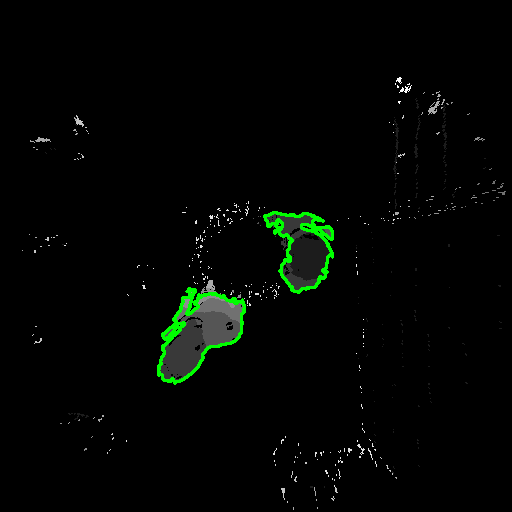

Area of Object 1 of image 20: 9454.0 square units
Area of Object 2 of image 20: 11535.0 square units
------------------------------------------------------------


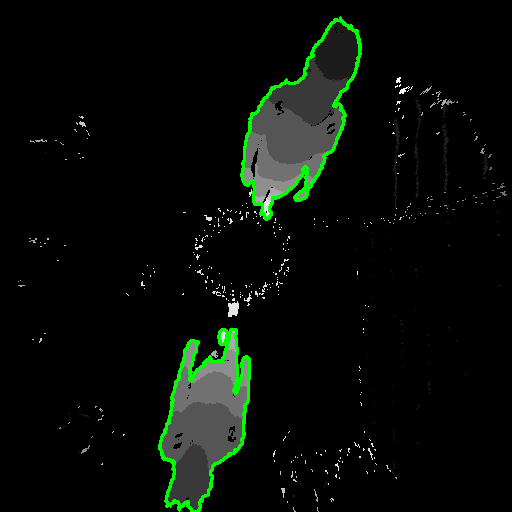

Area of Object 1 of image 21: 9042.0 square units
Area of Object 2 of image 21: 9992.5 square units
------------------------------------------------------------


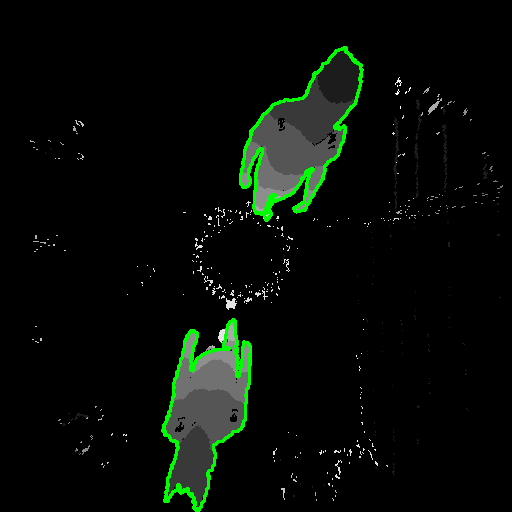

Area of Object 1 of image 22: 7999.0 square units
Area of Object 2 of image 22: 3015.0 square units
------------------------------------------------------------


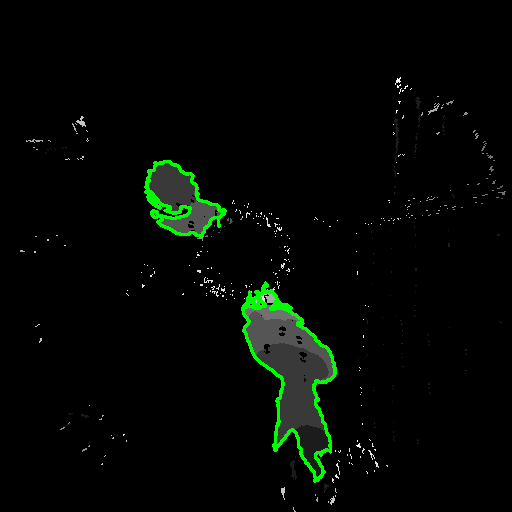

Area of Object 1 of image 23: 672.5 square units
Area of Object 2 of image 23: 6771.0 square units
Area of Object 3 of image 23: 5122.0 square units
------------------------------------------------------------


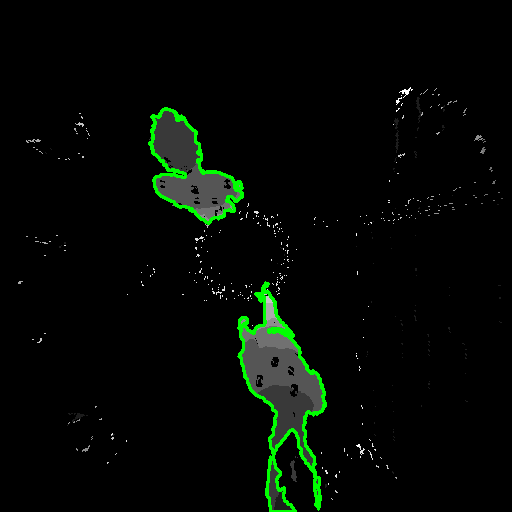

Area of Object 1 of image 24: 9040.5 square units
Area of Object 2 of image 24: 8607.0 square units
------------------------------------------------------------


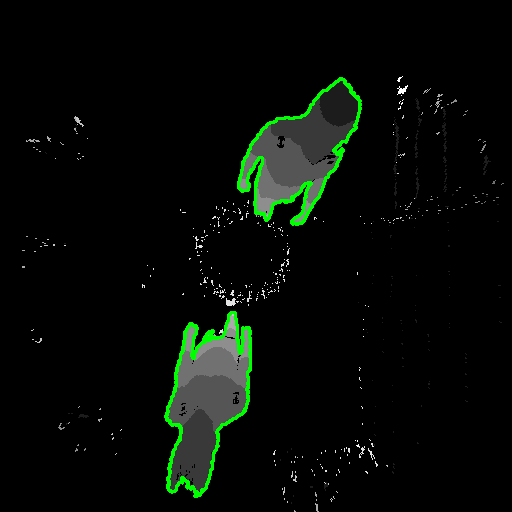

Area of Object 1 of image 25: 7493.0 square units
Area of Object 2 of image 25: 4155.0 square units
------------------------------------------------------------


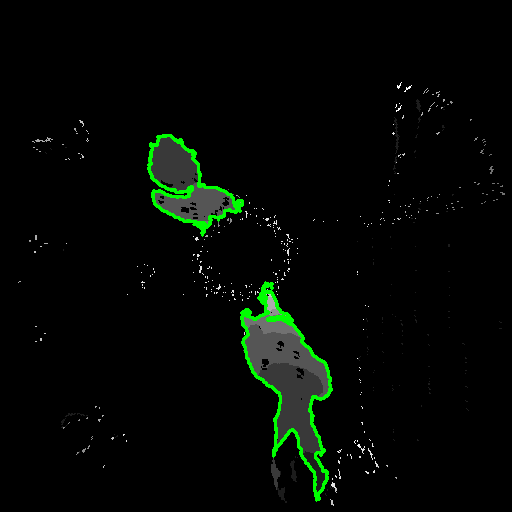

Area of Object 1 of image 26: 7658.0 square units
Area of Object 2 of image 26: 5865.0 square units
------------------------------------------------------------


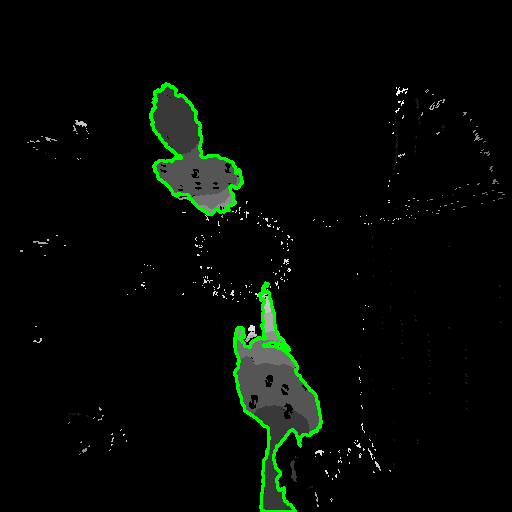

Area of Object 1 of image 27: 2789.0 square units
Area of Object 2 of image 27: 4360.5 square units
------------------------------------------------------------


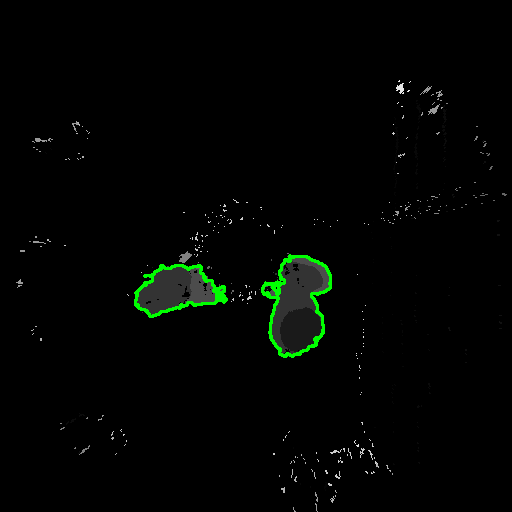

Area of Object 1 of image 28: 4877.5 square units
Area of Object 2 of image 28: 2645.5 square units
------------------------------------------------------------


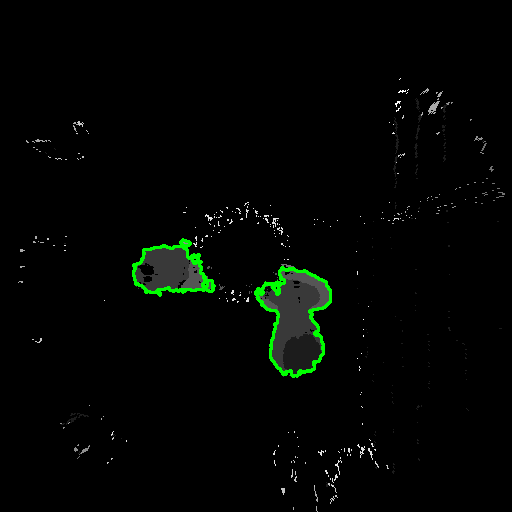

Area of Object 1 of image 29: 5407.5 square units
Area of Object 2 of image 29: 2873.0 square units
------------------------------------------------------------


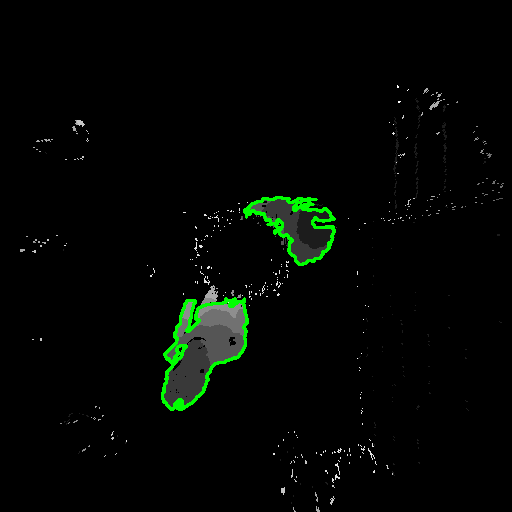

Area of Object 1 of image 30: 7210.5 square units
Area of Object 2 of image 30: 2385.5 square units
------------------------------------------------------------


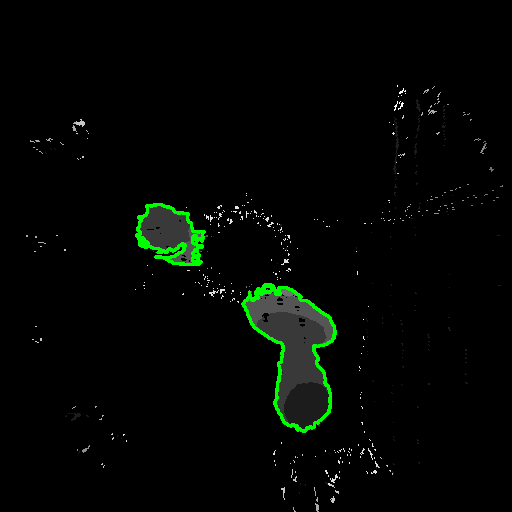

Area of Object 1 of image 31: 8162.0 square units
Area of Object 2 of image 31: 4931.5 square units
------------------------------------------------------------


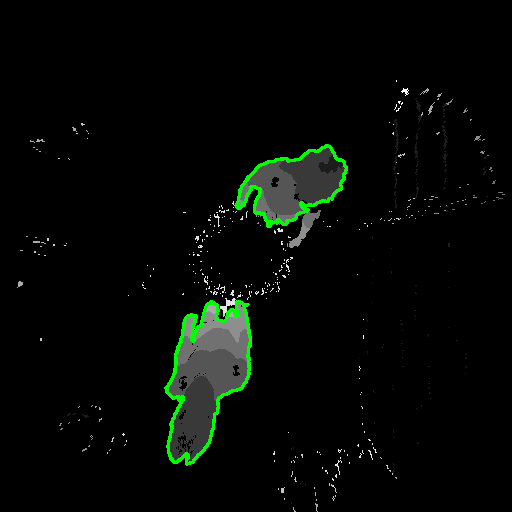

Area of Object 1 of image 32: 7946.5 square units
Area of Object 2 of image 32: 2526.0 square units
------------------------------------------------------------


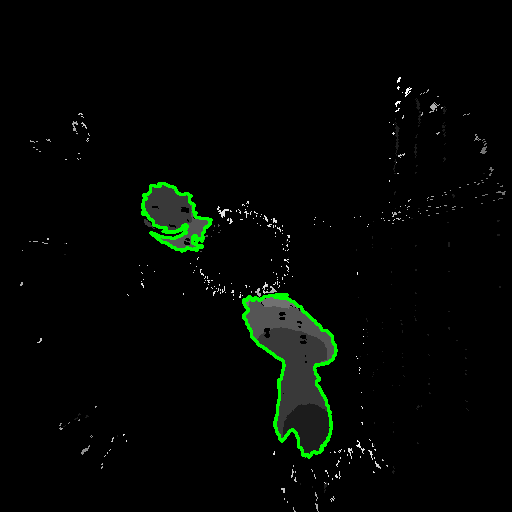

Area of Object 1 of image 33: 1821.0 square units
------------------------------------------------------------


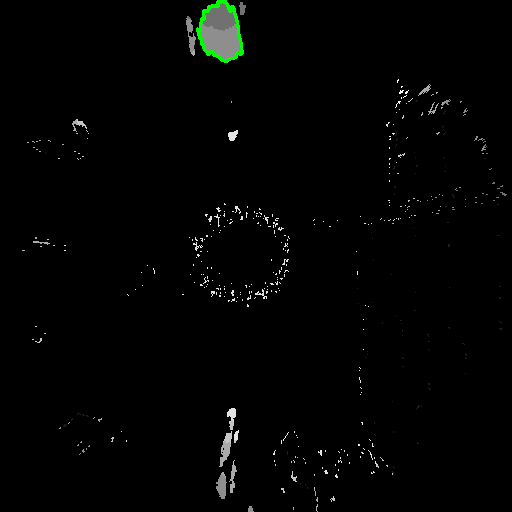

Area of Object 1 of image 34: 1673.5 square units
Area of Object 2 of image 34: 4506.5 square units
------------------------------------------------------------


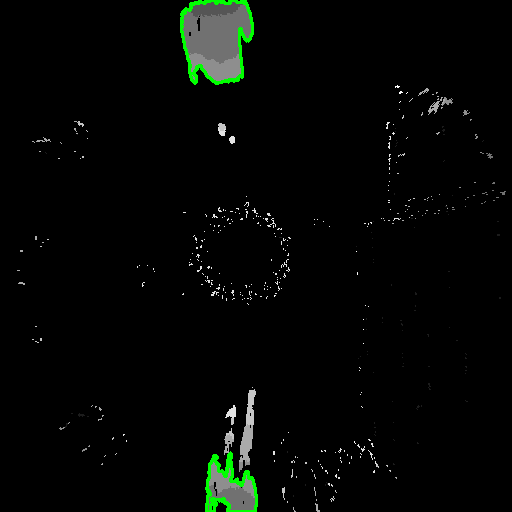

Area of Object 1 of image 35: 8422.5 square units
Area of Object 2 of image 35: 6306.5 square units
------------------------------------------------------------


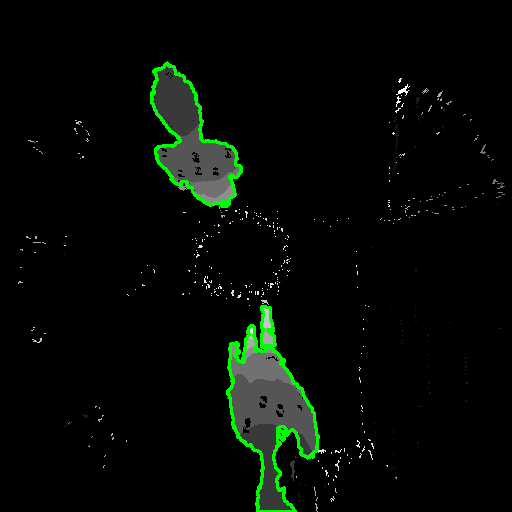

Area of Object 1 of image 36: 5073.5 square units
Area of Object 2 of image 36: 6620.0 square units
------------------------------------------------------------


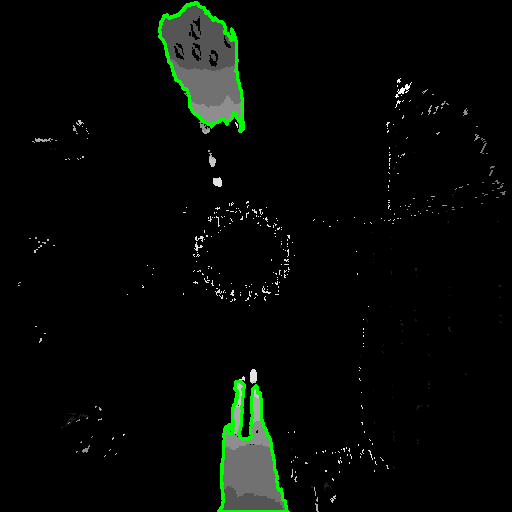

Area of Object 1 of image 37: 9153.5 square units
Area of Object 2 of image 37: 6787.5 square units
------------------------------------------------------------


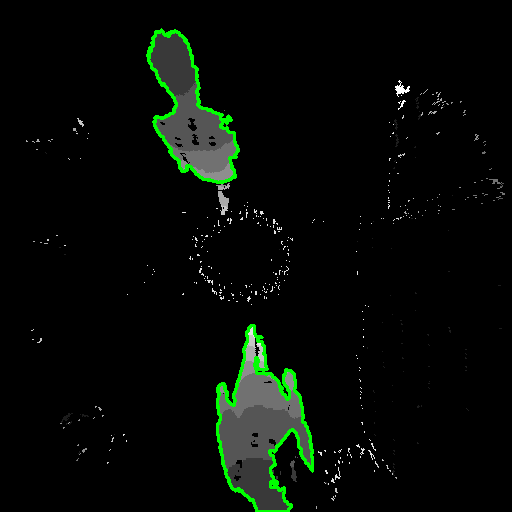

Area of Object 1 of image 38: 4101.0 square units
Area of Object 2 of image 38: 6433.0 square units
------------------------------------------------------------


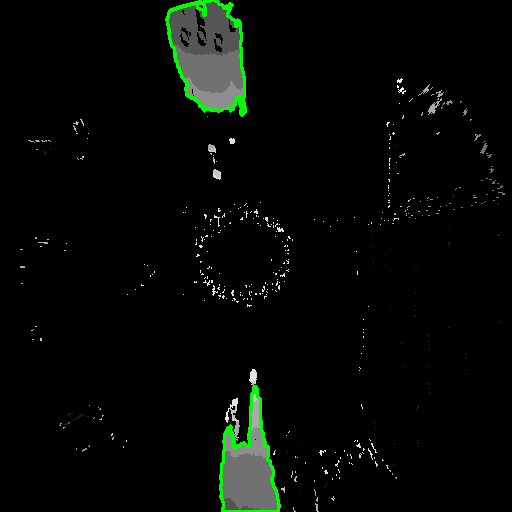

Area of Object 1 of image 39: 8732.0 square units
Area of Object 2 of image 39: 7085.0 square units
------------------------------------------------------------


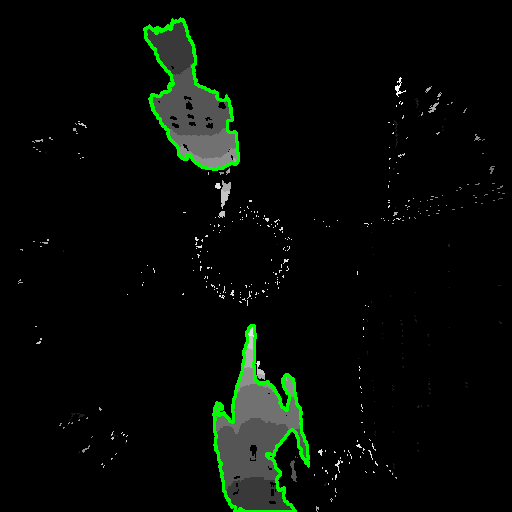

Area of Object 1 of image 40: 8012.0 square units
Area of Object 2 of image 40: 7001.5 square units
------------------------------------------------------------


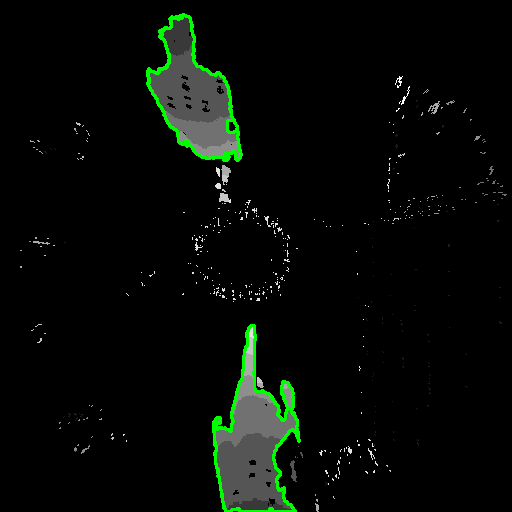

Area of Object 1 of image 41: 6738.0 square units
Area of Object 2 of image 41: 6898.5 square units
------------------------------------------------------------


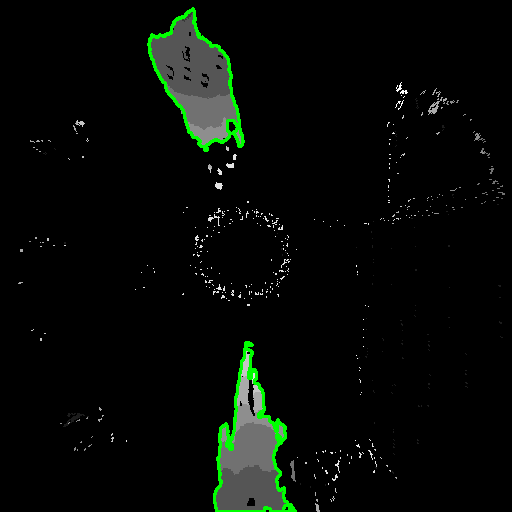

Area of Object 1 of image 42: 638.0 square units
Area of Object 2 of image 42: 3834.0 square units
------------------------------------------------------------


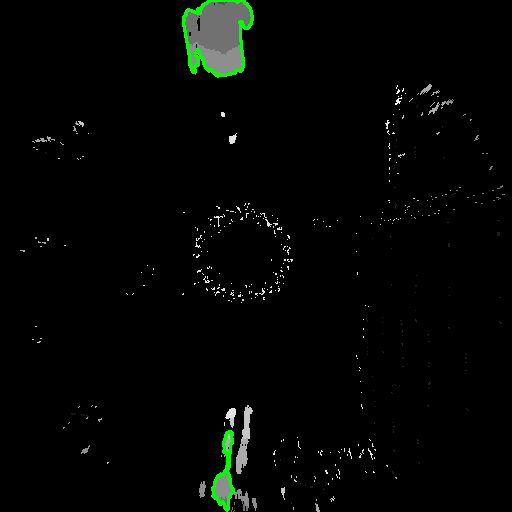

Area of Object 1 of image 43: 7290.5 square units
Area of Object 2 of image 43: 6925.5 square units
------------------------------------------------------------


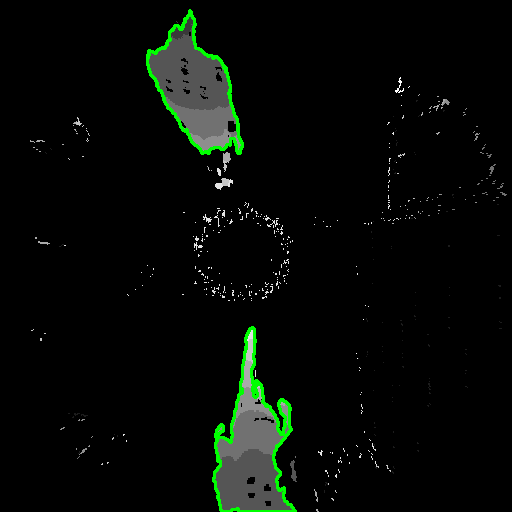

Area of Object 1 of image 44: 2424.5 square units
------------------------------------------------------------


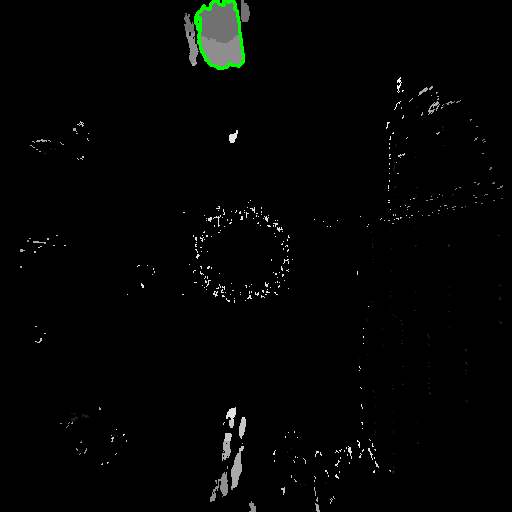

Area of Object 1 of image 45: 3627.5 square units
Area of Object 2 of image 45: 5980.0 square units
------------------------------------------------------------


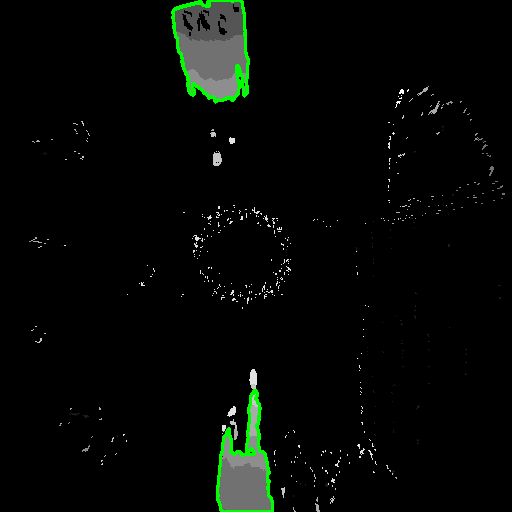

Area of Object 1 of image 46: 3230.5 square units
Area of Object 2 of image 46: 5084.0 square units
------------------------------------------------------------


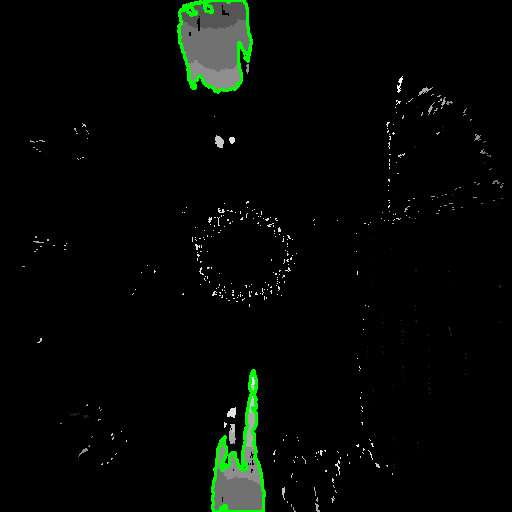

Area of Object 1 of image 47: 6008.0 square units
Area of Object 2 of image 47: 6762.5 square units
------------------------------------------------------------


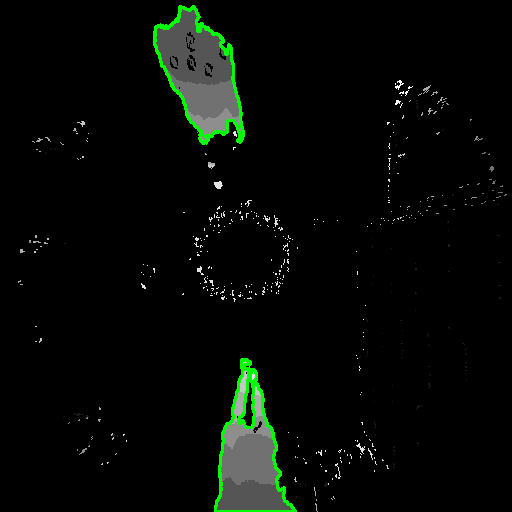

Area of Object 1 of image 48: 8616.0 square units
Area of Object 2 of image 48: 6722.5 square units
------------------------------------------------------------


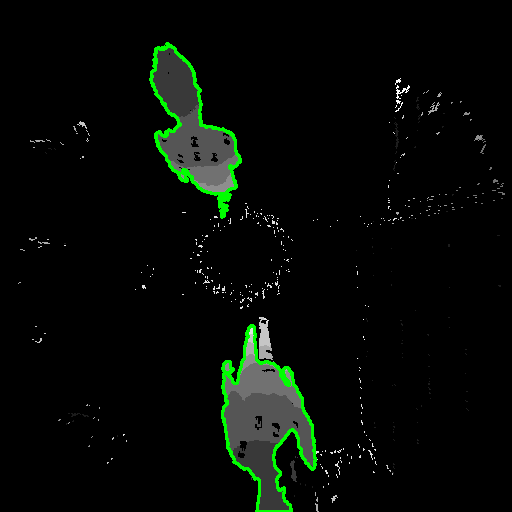

In [17]:
for i in range(len(images_normalized)):
  depth_map = images_normalized[i][:, :, 2]
  # Apply the binary mask to the original image to extract the filtered pixels
  filtered_image = cv2.bitwise_and(depth_map, depth_map, mask=binary_mask)
  contours, hierarchy  = cv2.findContours(depth_map, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
  contour_image = np.copy(images_normalized[i])
  #contour_image = np.copy(images_normalized[i])
  filtered_contours = [contour for contour in contours if 600 < cv2.contourArea(contour) < 13000]
  for j, filtered_contour in enumerate(filtered_contours):
    area = cv2.contourArea(filtered_contour)
    print(f"Area of Object {j + 1} of image {i}: {area} square units")
  print("------------------------------------------------------------")

  cv2.drawContours(contour_image, filtered_contours, -1, (0, 255, 0), 2)
  show_image(contour_image)

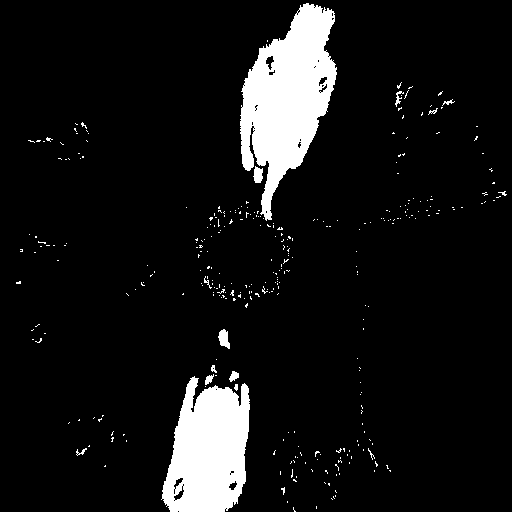

In [18]:
threshold_value = 30

# Apply thresholding to create a binary image
_, binary_image = cv2.threshold(images_normalized[0], threshold_value, 255, cv2.THRESH_BINARY)
cv2_imshow(binary_image)

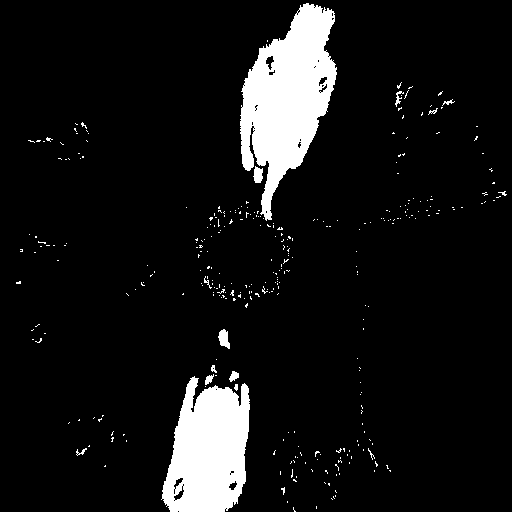

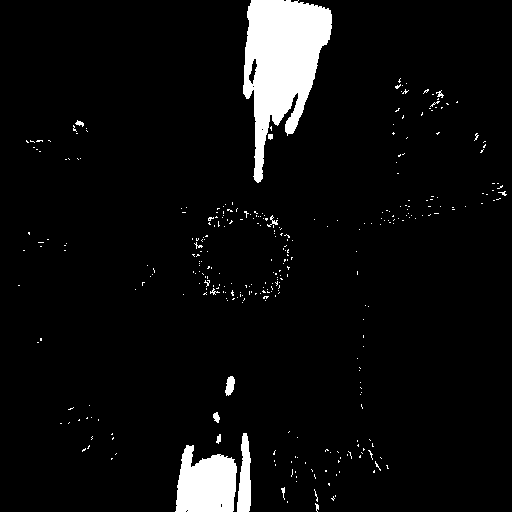

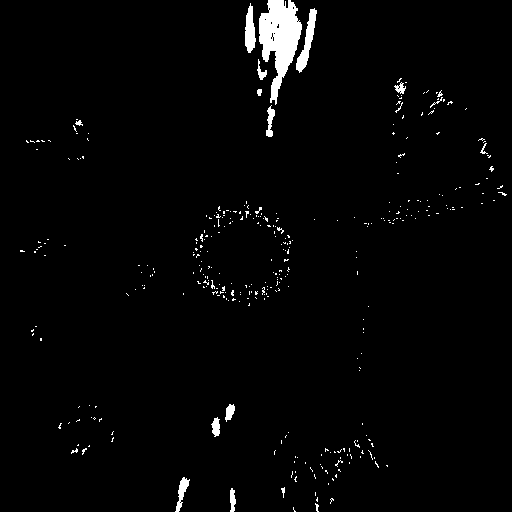

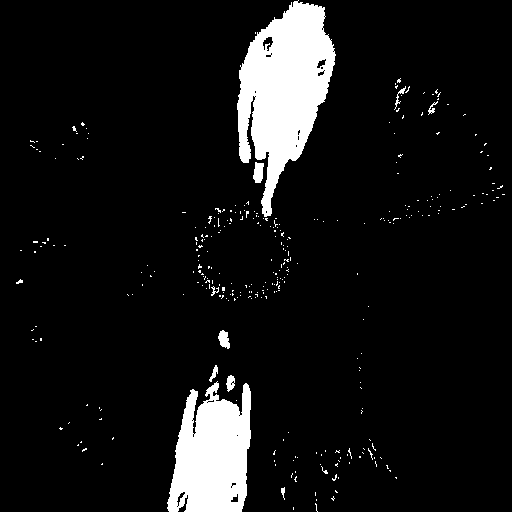

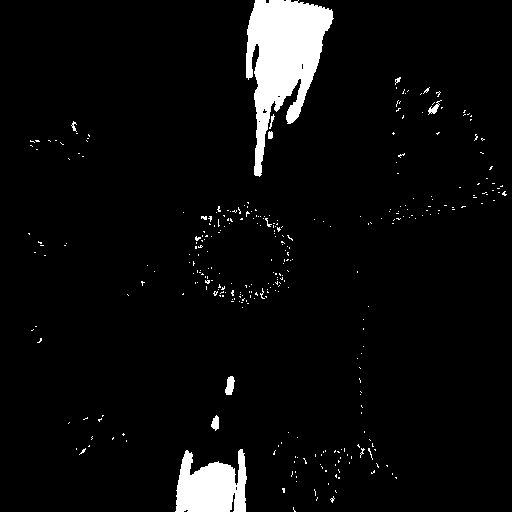

...

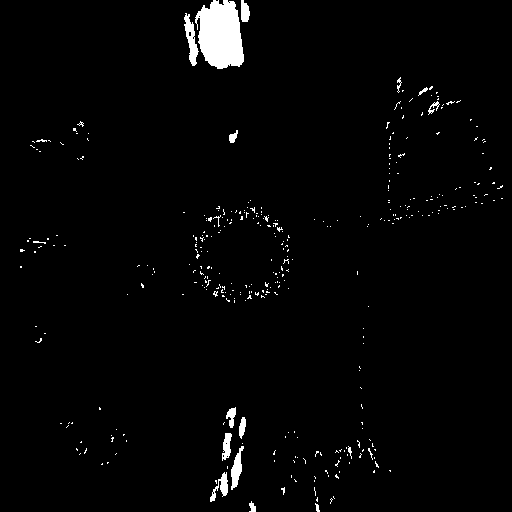

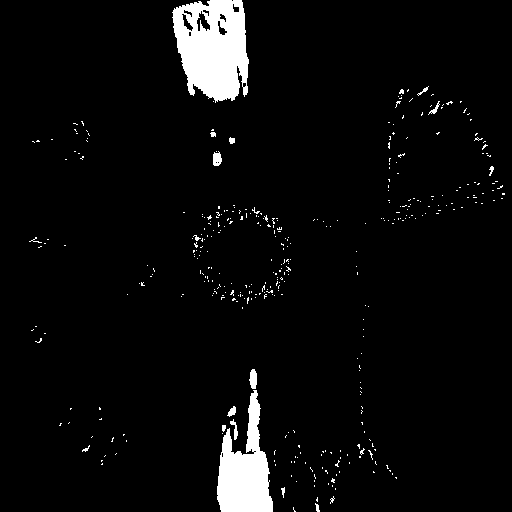

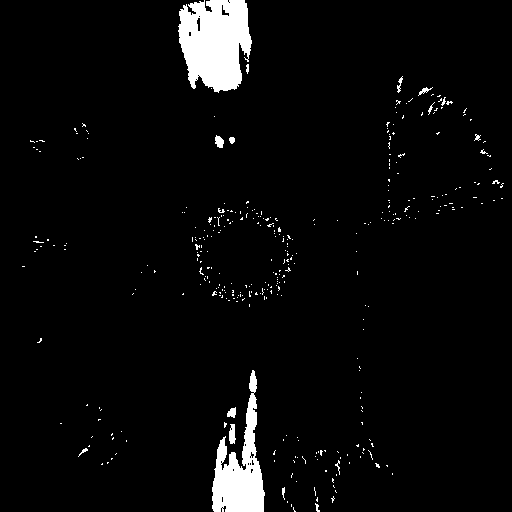

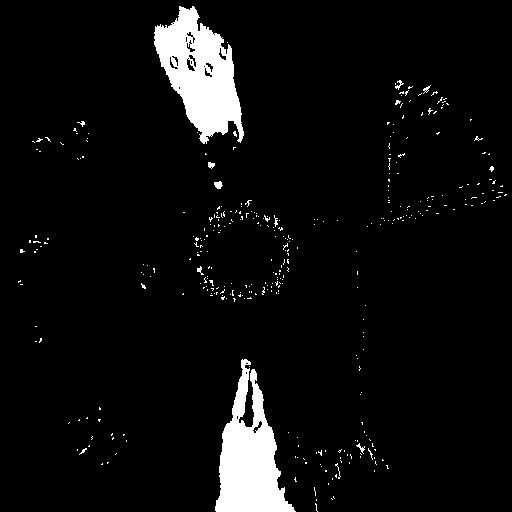

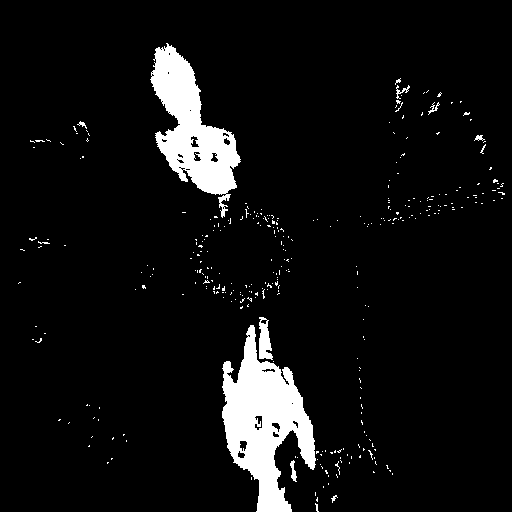

In [21]:
binary_images=[]
for i in range(len(images_normalized)):
  _, binary_image = cv2.threshold(images_normalized[i], threshold_value, 255, cv2.THRESH_BINARY)
  cv2_imshow(binary_image)
  binary_images.append(binary_image)

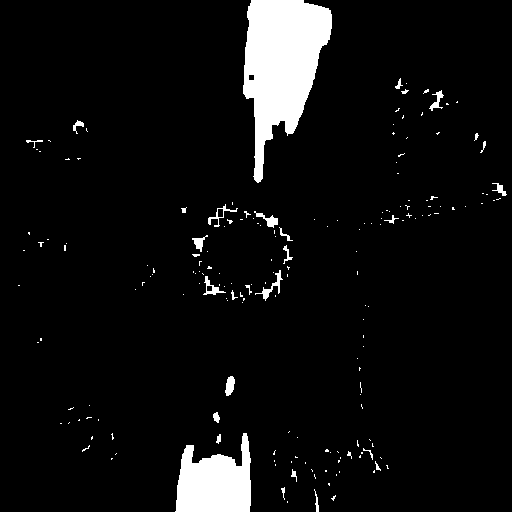

In [23]:
# loop over the kernels sizes again
kernelSizes = [(5, 5)]
for kernelSize in kernelSizes:
	# construct a rectangular kernel form the current size, but this
	# time apply a "closing" operation
	kernel = cv2.getStructuringElement(cv2.MORPH_RECT, kernelSize)
	closing = cv2.morphologyEx(binary_images[1], cv2.MORPH_CLOSE, kernel)
	cv2_imshow( closing)
	cv2.waitKey(0)

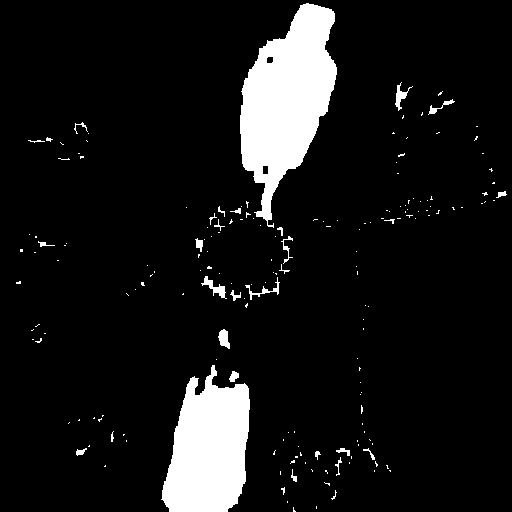

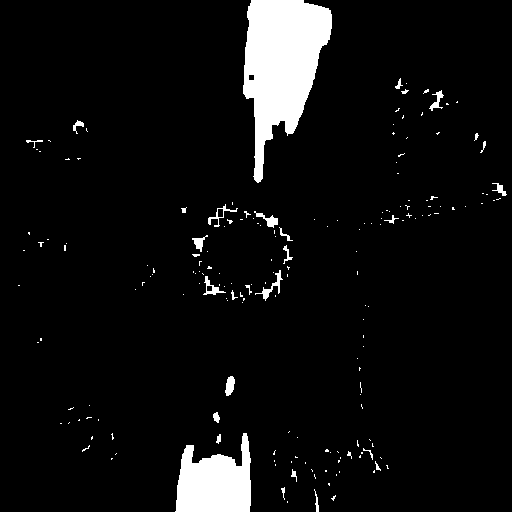

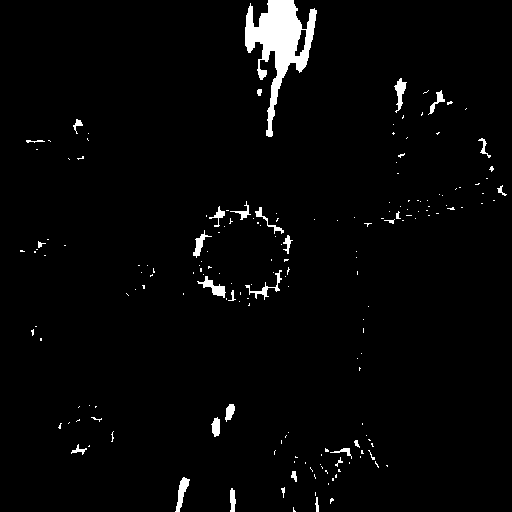

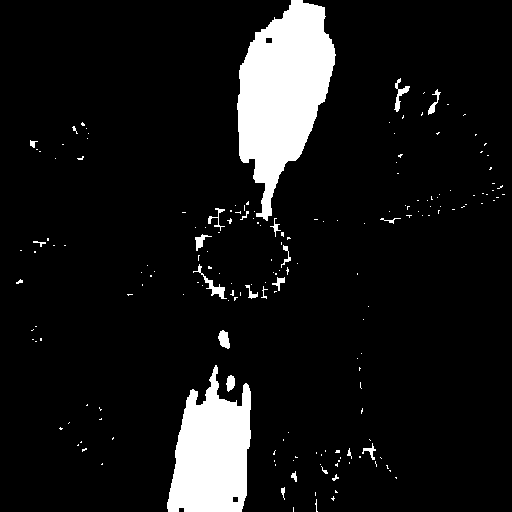

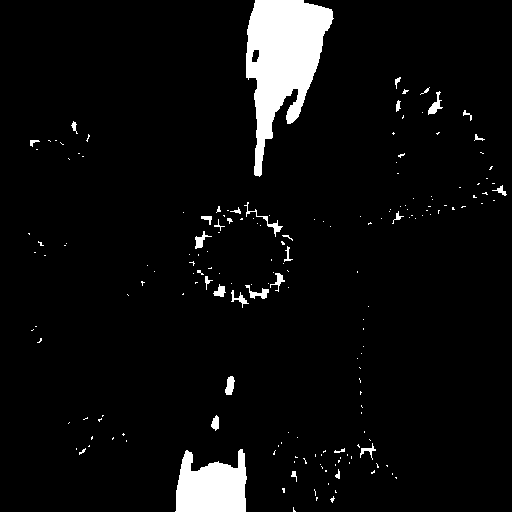

...

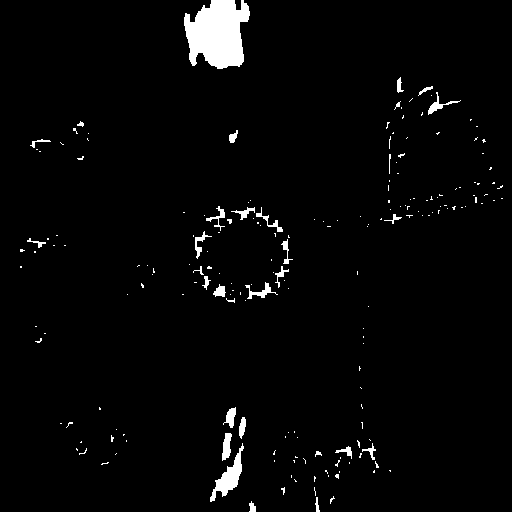

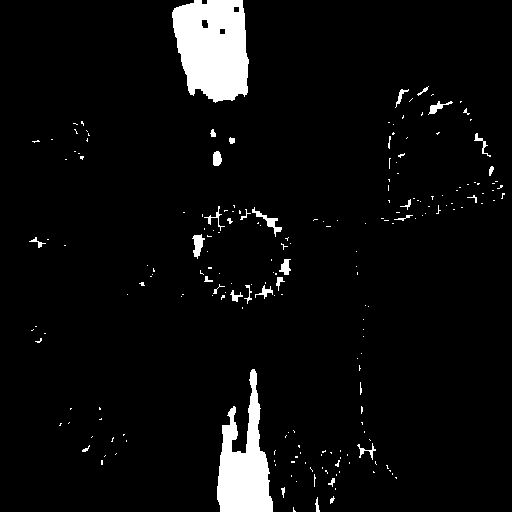

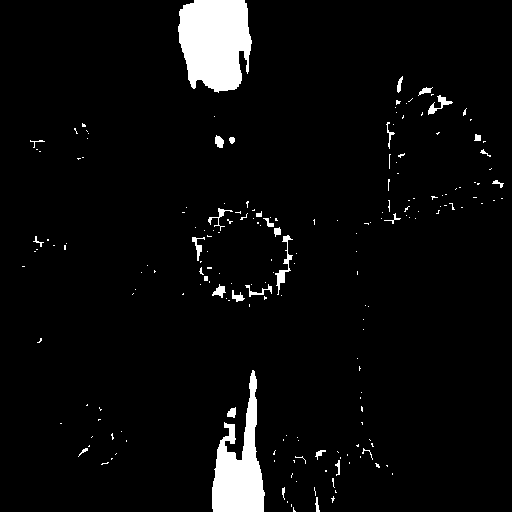

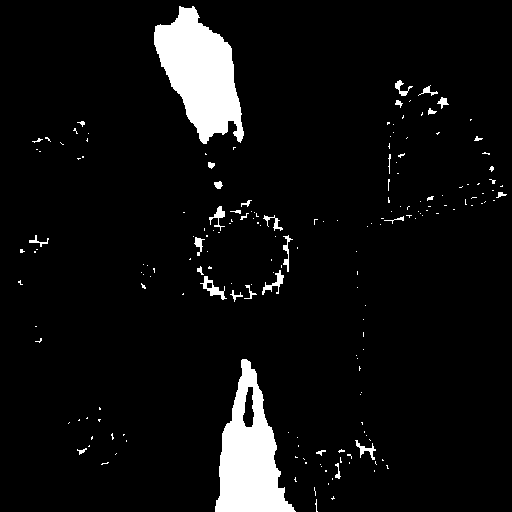

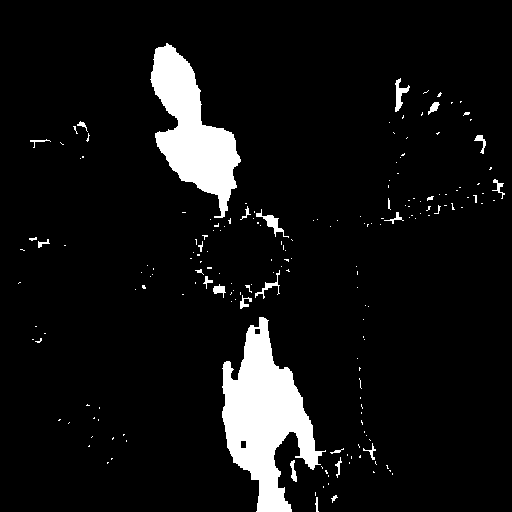

In [26]:
kernelSize= (5,5)
kernelized_images=[]
for i in range(len(binary_images)):
  kernel = cv2.getStructuringElement(cv2.MORPH_RECT, kernelSize)
  closing = cv2.morphologyEx(binary_images[i], cv2.MORPH_CLOSE, kernel)
  kernelized_images.append(closing)
  cv2_imshow( closing)
  cv2.waitKey(0)

Area of Object 1 of image 0: 8999.5 square units
Area of Object 2 of image 0: 11856.0 square units
------------------------------------------------------------


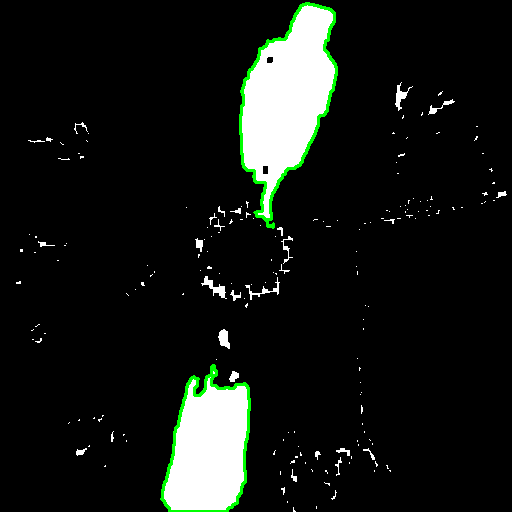

Area of Object 1 of image 1: 3992.5 square units
Area of Object 2 of image 1: 9109.0 square units
------------------------------------------------------------


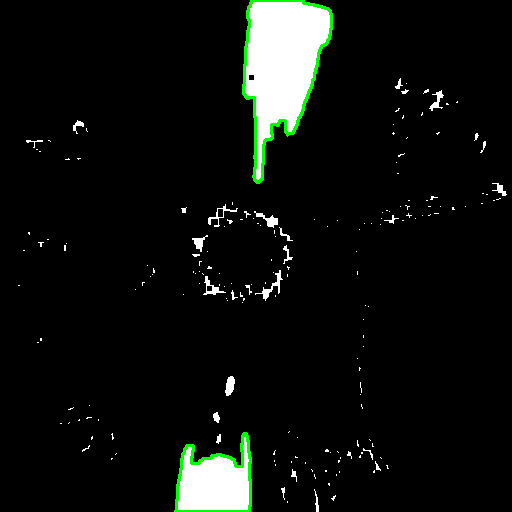

Area of Object 1 of image 2: 3628.5 square units
------------------------------------------------------------


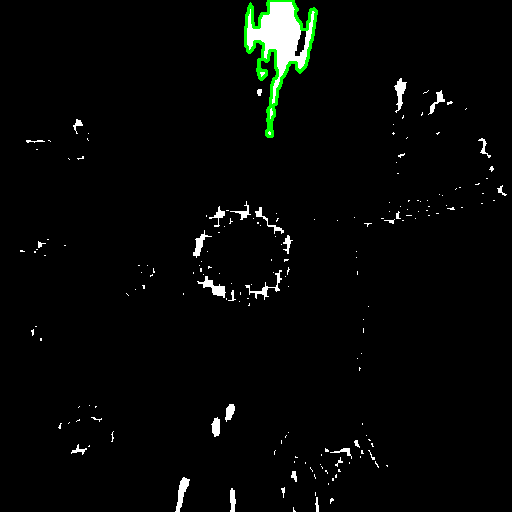

Area of Object 1 of image 3: 8217.5 square units
Area of Object 2 of image 3: 12382.5 square units
------------------------------------------------------------


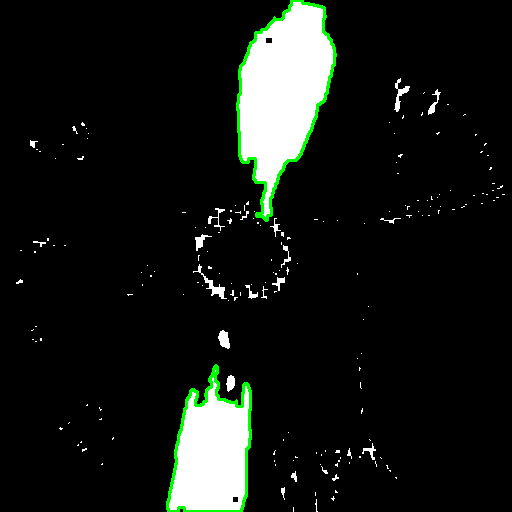

Area of Object 1 of image 4: 3245.0 square units
Area of Object 2 of image 4: 7914.5 square units
------------------------------------------------------------


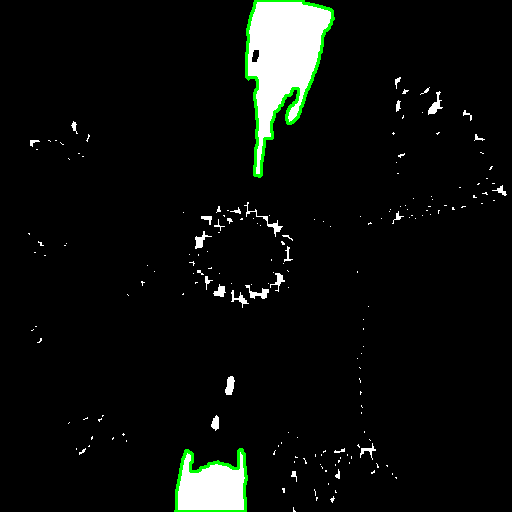

Area of Object 1 of image 5: 4742.5 square units
------------------------------------------------------------


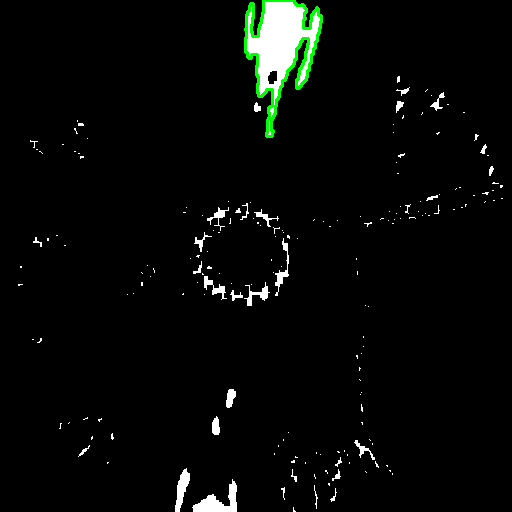

Area of Object 1 of image 6: 6294.0 square units
Area of Object 2 of image 6: 12319.0 square units
------------------------------------------------------------


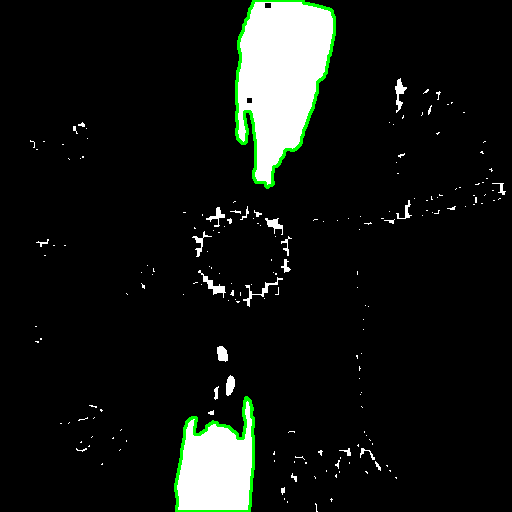

Area of Object 1 of image 7: 2562.0 square units
Area of Object 2 of image 7: 7045.5 square units
------------------------------------------------------------


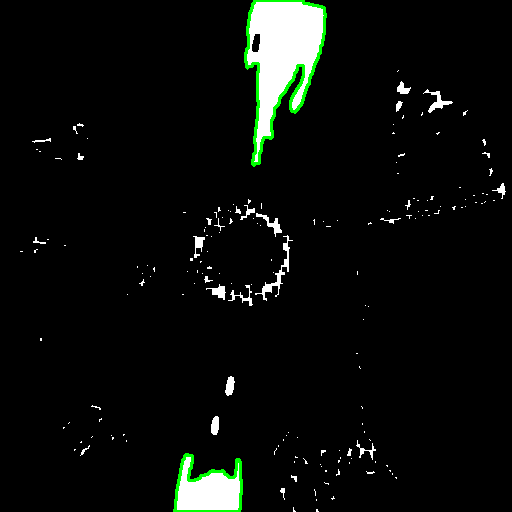

Area of Object 1 of image 8: 1806.0 square units
Area of Object 2 of image 8: 5722.5 square units
------------------------------------------------------------


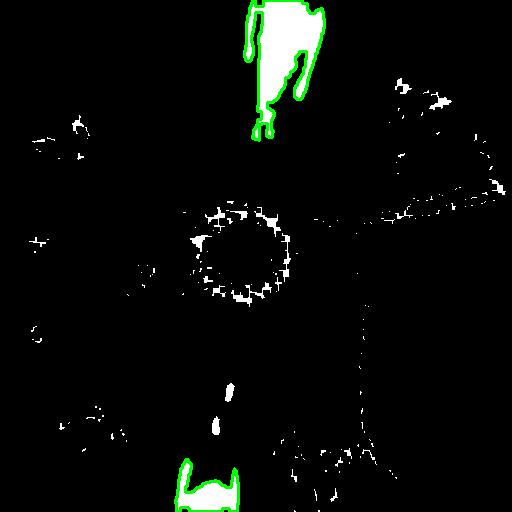

Area of Object 1 of image 9: 10010.0 square units
Area of Object 2 of image 9: 10291.5 square units
------------------------------------------------------------


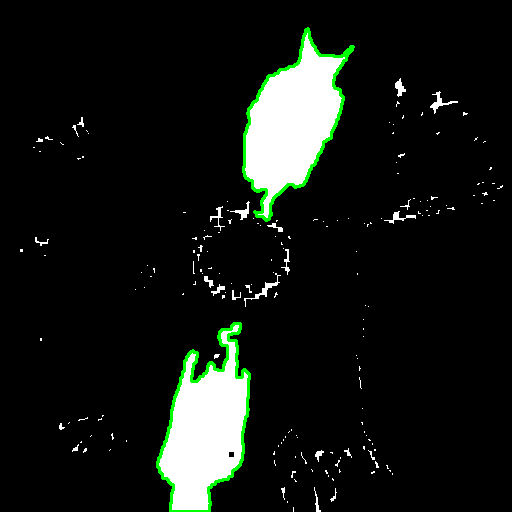

Area of Object 1 of image 10: 5546.0 square units
Area of Object 2 of image 10: 11456.5 square units
------------------------------------------------------------


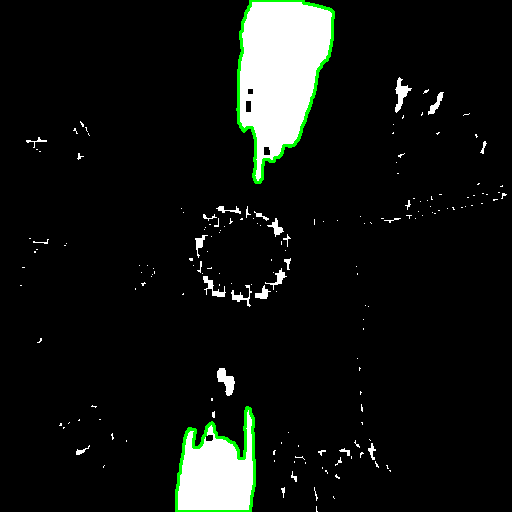

Area of Object 1 of image 11: 7288.0 square units
Area of Object 2 of image 11: 12668.0 square units
------------------------------------------------------------


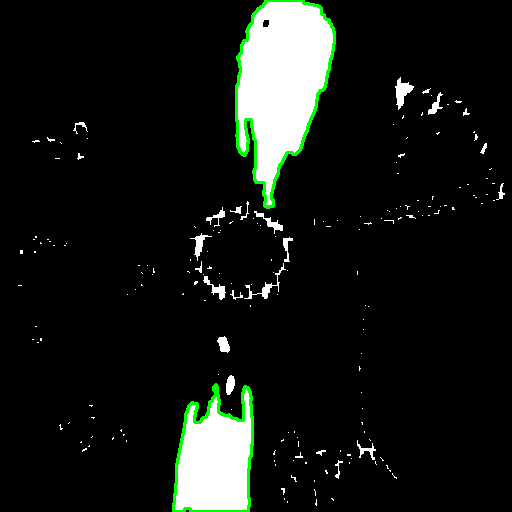

Area of Object 1 of image 12: 4672.0 square units
Area of Object 2 of image 12: 10275.0 square units
------------------------------------------------------------


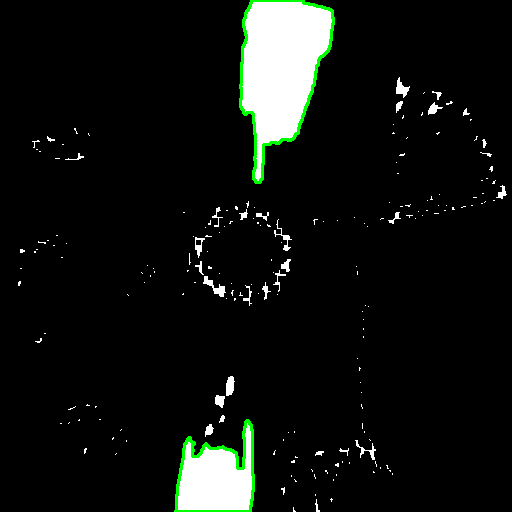

Area of Object 1 of image 13: 9519.5 square units
Area of Object 2 of image 13: 10904.0 square units
------------------------------------------------------------


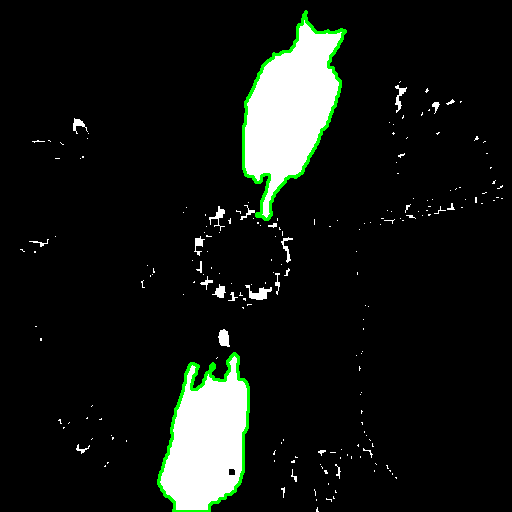

Area of Object 1 of image 14: 3526.0 square units
Area of Object 2 of image 14: 2350.0 square units
------------------------------------------------------------


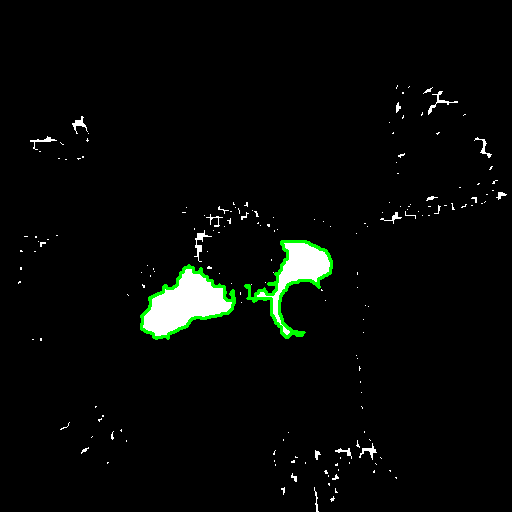

Area of Object 1 of image 15: 4085.5 square units
Area of Object 2 of image 15: 1803.0 square units
------------------------------------------------------------


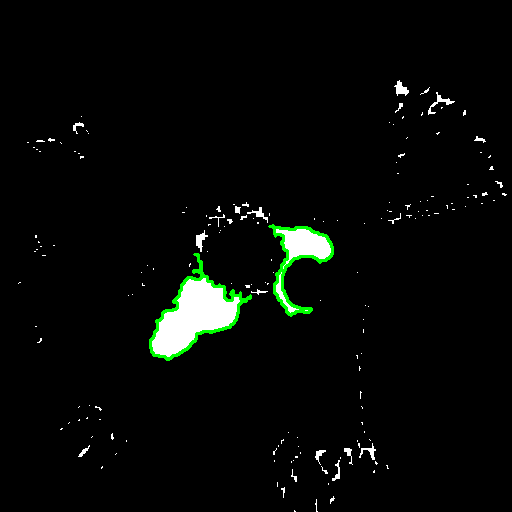

Area of Object 1 of image 16: 7858.5 square units
Area of Object 2 of image 16: 3456.5 square units
------------------------------------------------------------


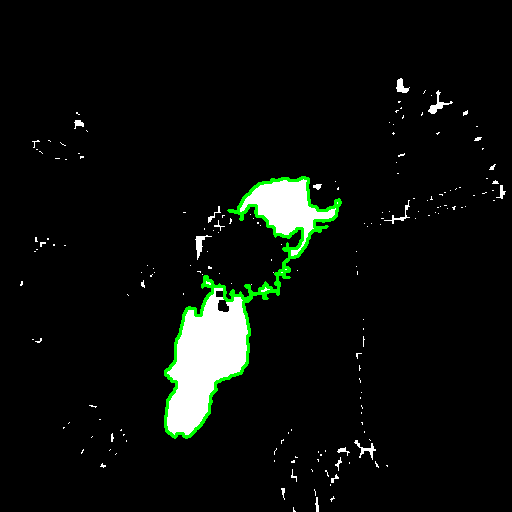

Area of Object 1 of image 17: 4756.0 square units
Area of Object 2 of image 17: 2608.0 square units
------------------------------------------------------------


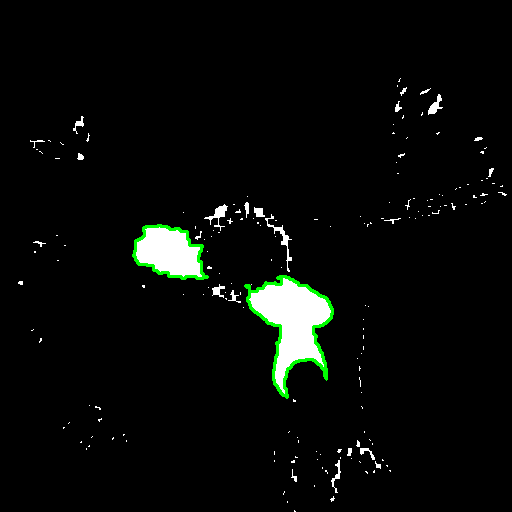

Area of Object 1 of image 18: 9148.0 square units
Area of Object 2 of image 18: 6376.0 square units
------------------------------------------------------------


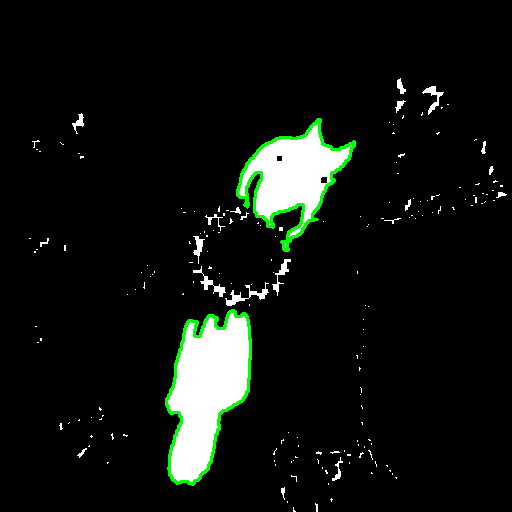

Area of Object 1 of image 19: 4886.0 square units
Area of Object 2 of image 19: 1732.5 square units
------------------------------------------------------------


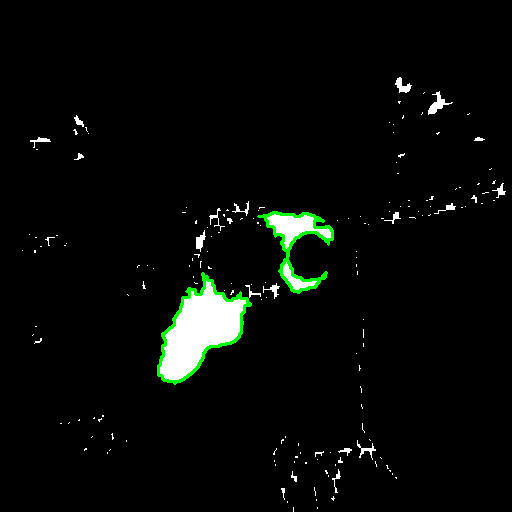

Area of Object 1 of image 20: 9841.5 square units
Area of Object 2 of image 20: 9699.5 square units
------------------------------------------------------------


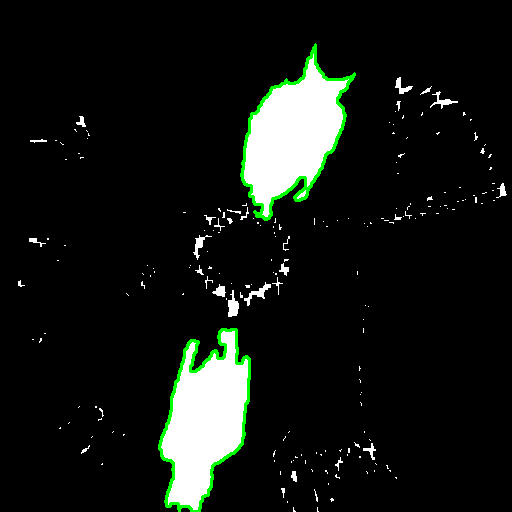

Area of Object 1 of image 21: 9465.5 square units
Area of Object 2 of image 21: 8688.0 square units
------------------------------------------------------------


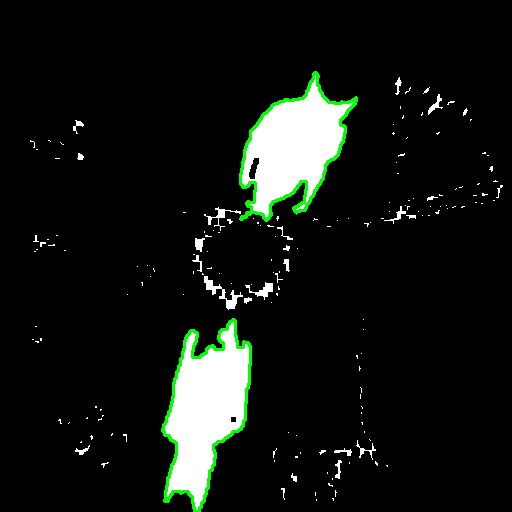

Area of Object 1 of image 22: 7303.5 square units
Area of Object 2 of image 22: 3461.5 square units
------------------------------------------------------------


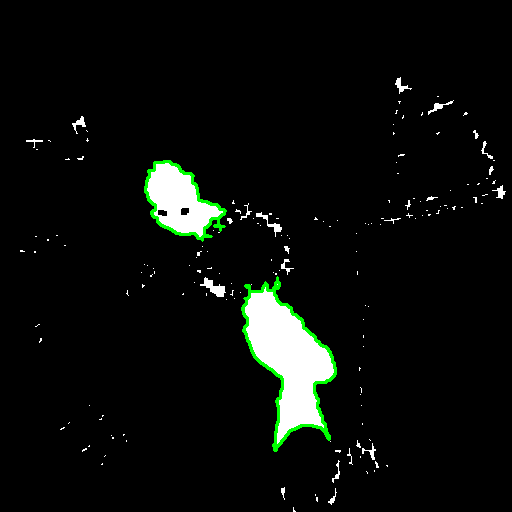

Area of Object 1 of image 23: 7507.5 square units
Area of Object 2 of image 23: 5406.5 square units
------------------------------------------------------------


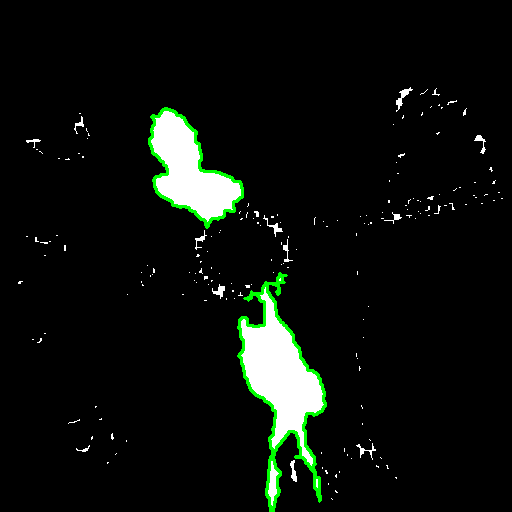

Area of Object 1 of image 24: 9417.5 square units
Area of Object 2 of image 24: 7441.5 square units
------------------------------------------------------------


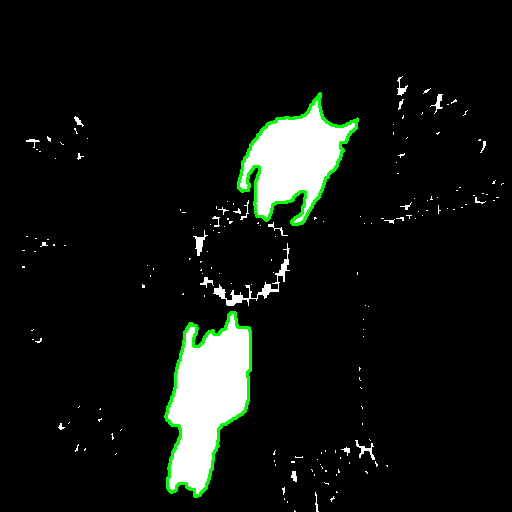

Area of Object 1 of image 25: 7463.5 square units
Area of Object 2 of image 25: 4552.5 square units
------------------------------------------------------------


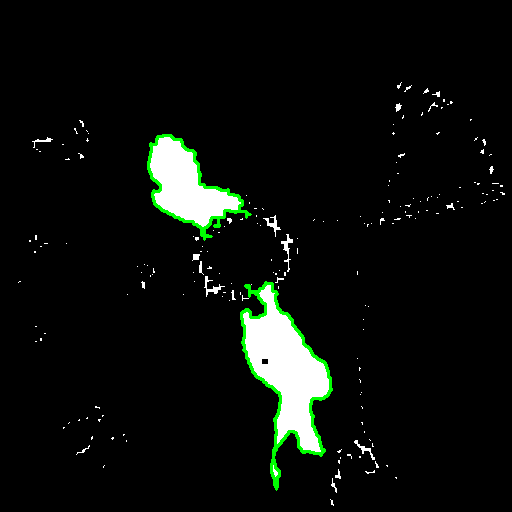

Area of Object 1 of image 26: 8101.5 square units
Area of Object 2 of image 26: 6062.0 square units
------------------------------------------------------------


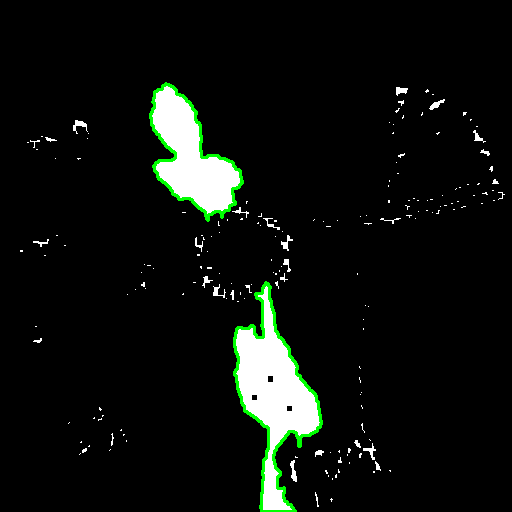

Area of Object 1 of image 27: 3027.5 square units
Area of Object 2 of image 27: 3167.0 square units
------------------------------------------------------------


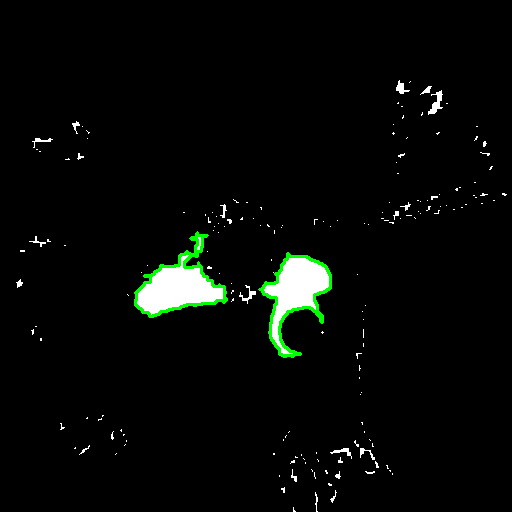

Area of Object 1 of image 28: 3915.0 square units
Area of Object 2 of image 28: 2856.0 square units
------------------------------------------------------------


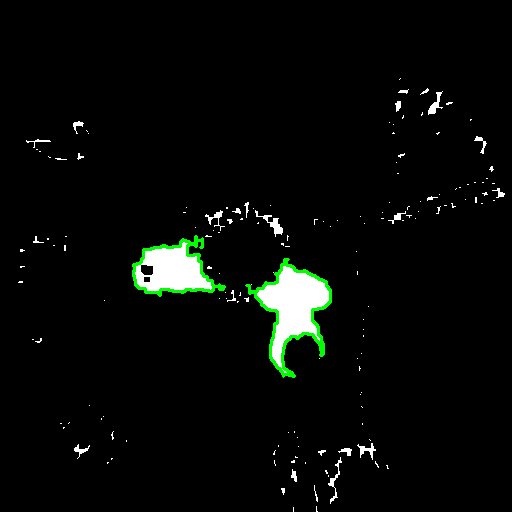

Area of Object 1 of image 29: 6044.5 square units
Area of Object 2 of image 29: 2164.0 square units
------------------------------------------------------------


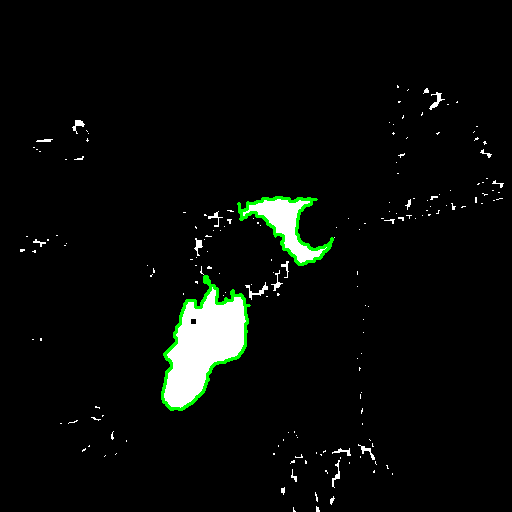

Area of Object 1 of image 30: 5689.5 square units
Area of Object 2 of image 30: 2806.5 square units
------------------------------------------------------------


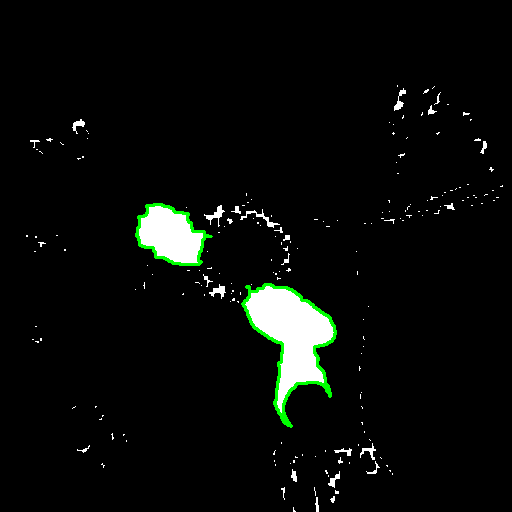

Area of Object 1 of image 31: 8799.5 square units
Area of Object 2 of image 31: 5341.0 square units
------------------------------------------------------------


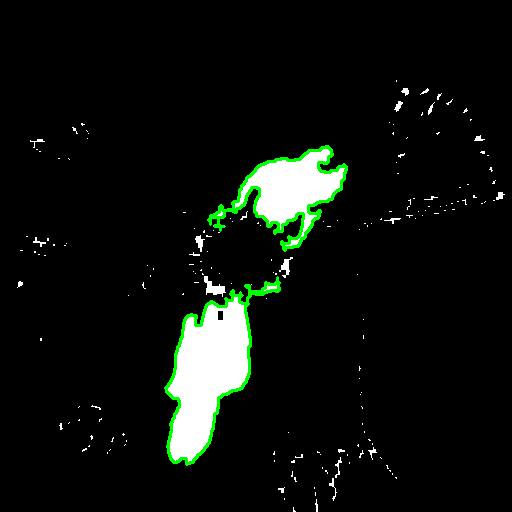

Area of Object 1 of image 32: 6594.5 square units
Area of Object 2 of image 32: 2980.0 square units
------------------------------------------------------------


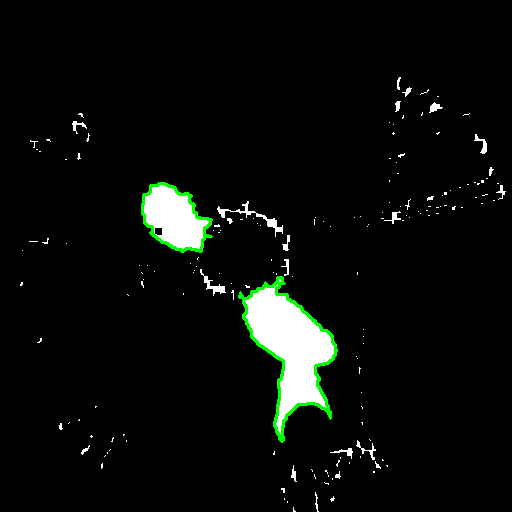

Area of Object 1 of image 33: 2166.5 square units
------------------------------------------------------------


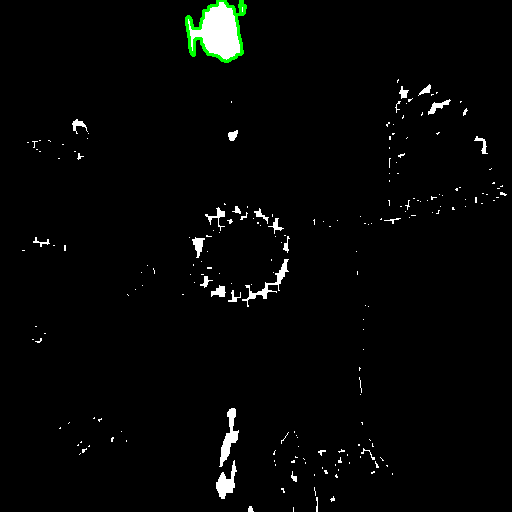

Area of Object 1 of image 34: 2643.5 square units
Area of Object 2 of image 34: 4674.5 square units
------------------------------------------------------------


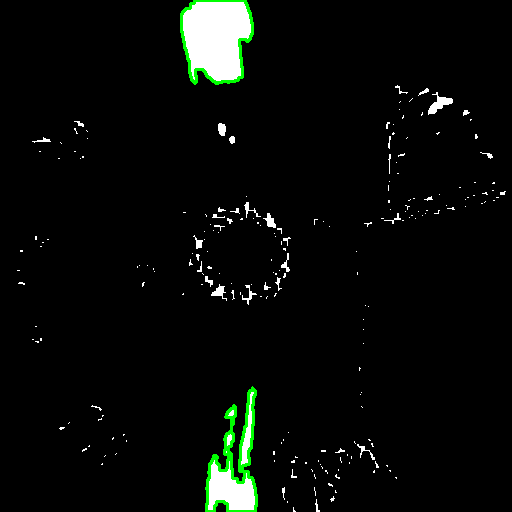

Area of Object 1 of image 35: 8902.5 square units
Area of Object 2 of image 35: 6509.0 square units
------------------------------------------------------------


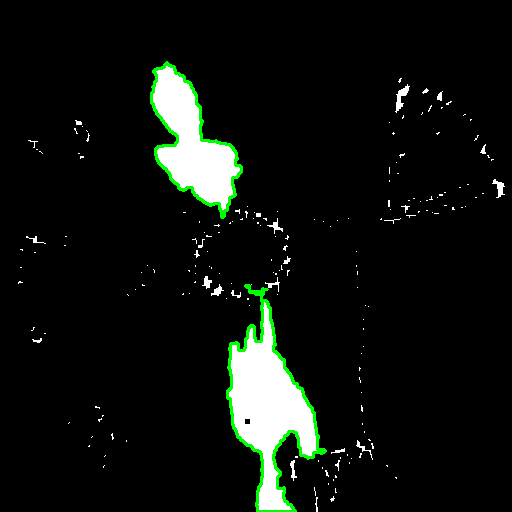

Area of Object 1 of image 36: 5261.5 square units
Area of Object 2 of image 36: 6878.0 square units
------------------------------------------------------------


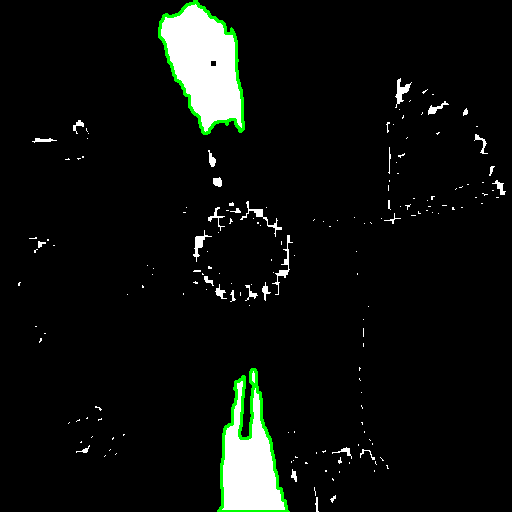

Area of Object 1 of image 37: 9521.0 square units
Area of Object 2 of image 37: 7214.0 square units
------------------------------------------------------------


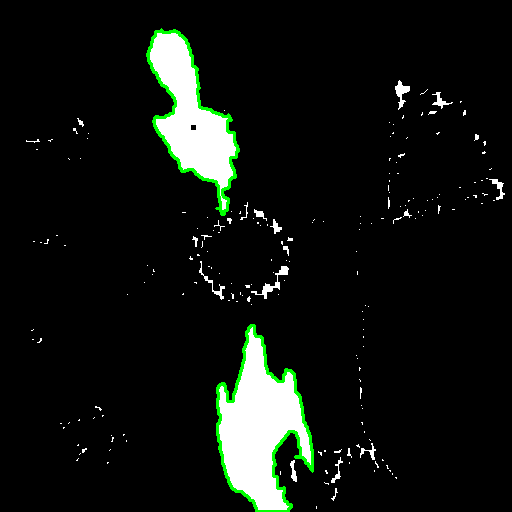

Area of Object 1 of image 38: 4576.5 square units
Area of Object 2 of image 38: 6613.0 square units
------------------------------------------------------------


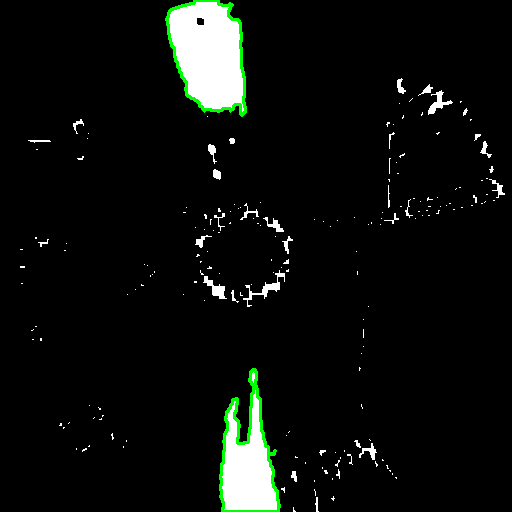

Area of Object 1 of image 39: 9043.0 square units
Area of Object 2 of image 39: 7282.0 square units
------------------------------------------------------------


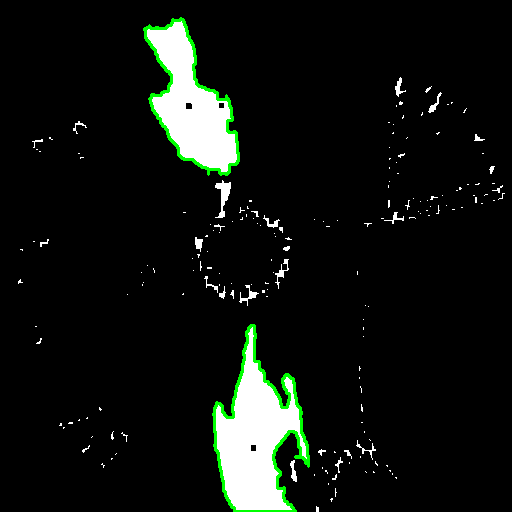

Area of Object 1 of image 40: 8238.0 square units
Area of Object 2 of image 40: 7433.0 square units
------------------------------------------------------------


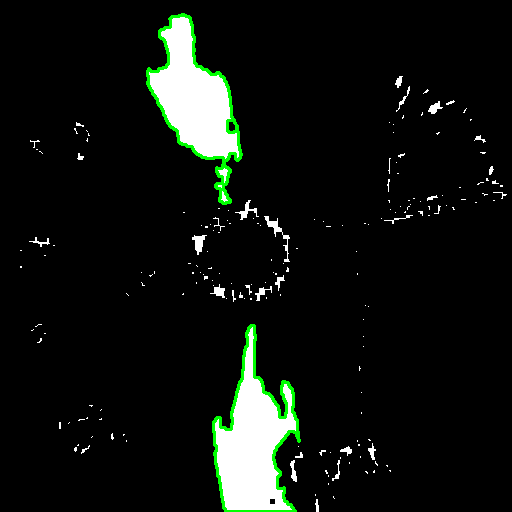

Area of Object 1 of image 41: 6991.5 square units
Area of Object 2 of image 41: 7076.0 square units
------------------------------------------------------------


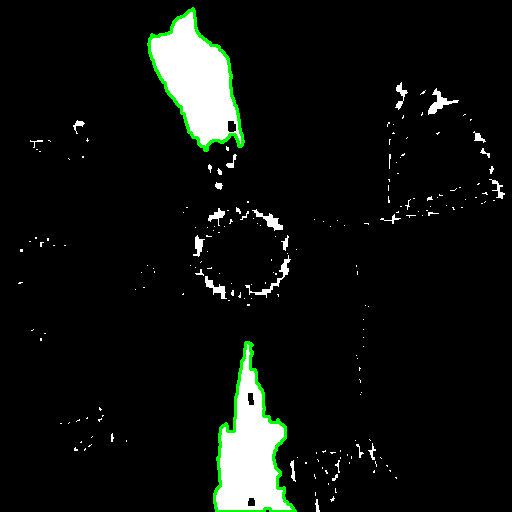

Area of Object 1 of image 42: 1067.5 square units
Area of Object 2 of image 42: 3953.0 square units
------------------------------------------------------------


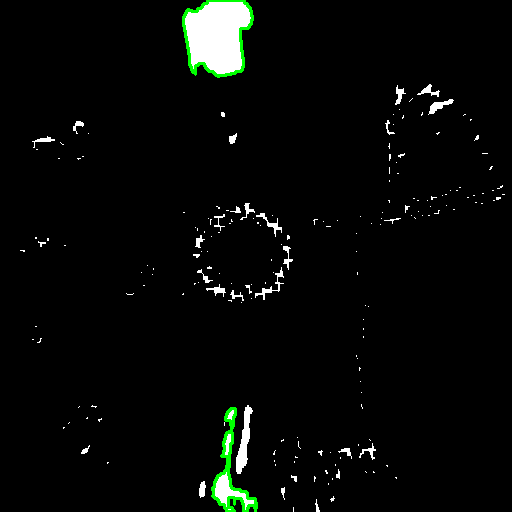

Area of Object 1 of image 43: 7488.0 square units
Area of Object 2 of image 43: 7144.5 square units
------------------------------------------------------------


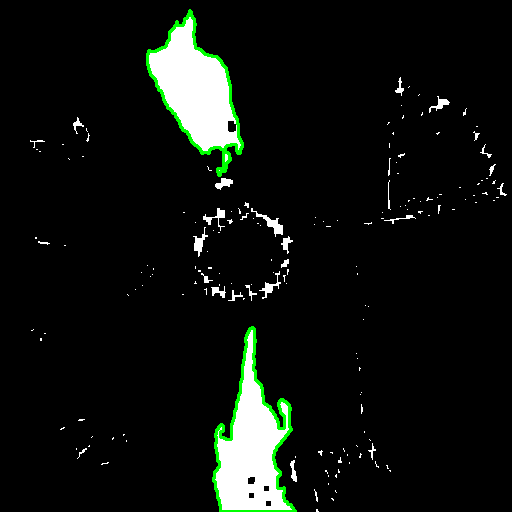

Area of Object 1 of image 44: 3150.5 square units
------------------------------------------------------------


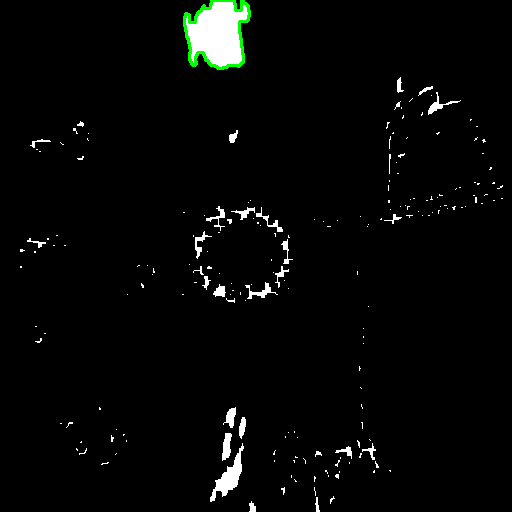

Area of Object 1 of image 45: 4037.5 square units
Area of Object 2 of image 45: 6185.5 square units
------------------------------------------------------------


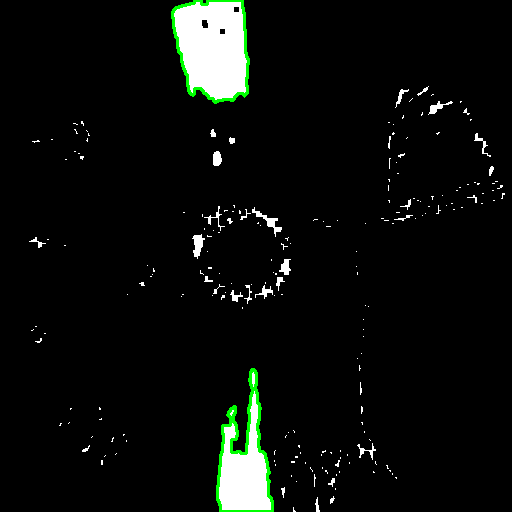

Area of Object 1 of image 46: 3583.5 square units
Area of Object 2 of image 46: 5328.5 square units
------------------------------------------------------------


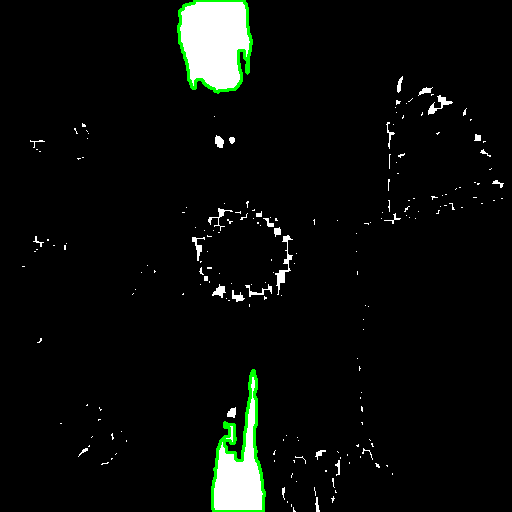

Area of Object 1 of image 47: 6486.0 square units
Area of Object 2 of image 47: 6966.5 square units
------------------------------------------------------------


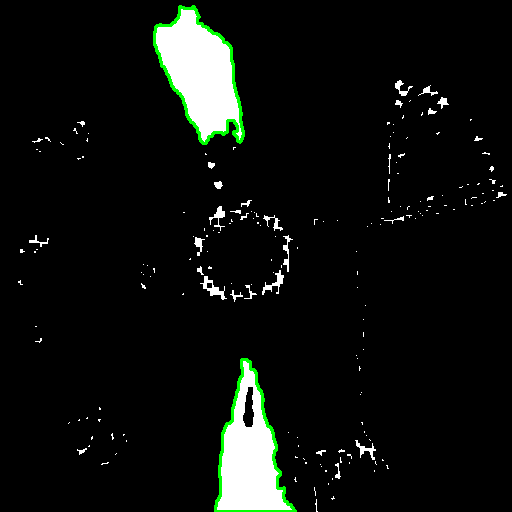

Area of Object 1 of image 48: 9412.5 square units
Area of Object 2 of image 48: 7009.0 square units
------------------------------------------------------------


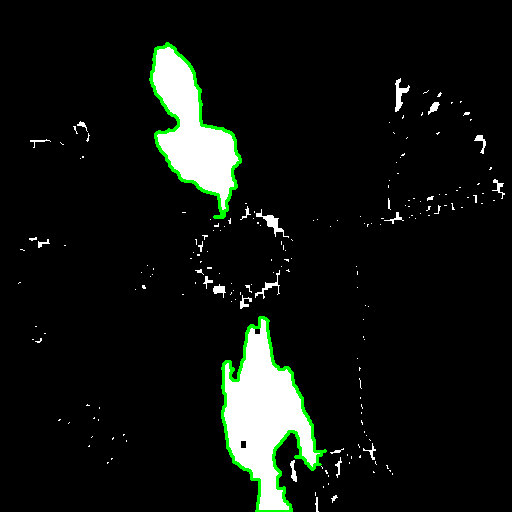

In [27]:
for i in range(len(kernelized_images)):
  depth_map = kernelized_images[i][:, :, 2]
  # Apply the binary mask to the original image to extract the filtered pixels
  filtered_image = cv2.bitwise_and(depth_map, depth_map, mask=binary_mask)
  contours, hierarchy  = cv2.findContours(depth_map, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
  contour_image = np.copy(kernelized_images[i])
  #contour_image = np.copy(images_normalized[i])
  filtered_contours = [contour for contour in contours if 600 < cv2.contourArea(contour) < 13000]
  for j, filtered_contour in enumerate(filtered_contours):
    area = cv2.contourArea(filtered_contour)
    print(f"Area of Object {j + 1} of image {i}: {area} square units")
  print(f"Number of people {j+1}")
  print("------------------------------------------------------------")

  cv2.drawContours(contour_image, filtered_contours, -1, (0, 255, 0), 2)
  show_image(contour_image)

#### EXPORT THE DATASET

In [ ]:
%pip install ultralytics
import ultralytics
ultralytics.checks()

from ultralytics import YOLO

Ultralytics YOLOv8.1.8 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 26.3/78.2 GB disk)


In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="")
project = rf.workspace("perception-ia").project("project-ltc1m")
dataset = project.version(2).download("yolov8")

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 70.0/70.0 kB 3.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 13.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 24.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 8.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 21.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.7/86.7 kB 12.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 8.3 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.9.0.80
    Uninstalling opencv-python-headless-4.9.0.80:
      Successfully uninstalled opencv-python-headless-4.9.0.80
  Attempting uninstall: idna
    Found existing installation: idna 3.6
    Uninstalling idna-3.6:
      Successfully uninstalled idna-3.6
  Attempting uninstall: cycler
    Found existing installation: cycle

loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.196 is required but found version=8.1.8, to fix: `pip install ultralytics==8.0.196`



Extracting Dataset Version Zip to project-2 in yolov8:: 100%|██████████| 264/264 [00:00<00:00, 7005.37it/s]


In [ ]:
model = YOLO('yolov8n.pt')

100%|██████████| 6.23M/6.23M [00:00<00:00, 179MB/s]


In [ ]:
import datetime

results = model.train (data='/content/project-2/data.yaml', epochs = 300,imgsz=640)


Ultralytics YOLOv8.1.8 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/project-2/data.yaml, epochs=300, time=None, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, sho

100%|██████████| 755k/755k [00:00<00:00, 34.4MB/s]


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

train: Scanning /content/project-2/train/labels... 114 images, 0 backgrounds, 0 corrupt: 100%|██████████| 114/114 [00:00<00:00, 2024.23it/s]

train: New cache created: /content/project-2/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/project-2/valid/labels... 11 images, 0 backgrounds, 0 corrupt: 100%|██████████| 11/11 [00:00<00:00, 1546.11it/s]

val: New cache created: /content/project-2/valid/labels.cache


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train2
Starting training for 300 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/300      2.44G       2.16      3.294      2.037          4        640: 100%|██████████| 8/8 [00:06<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:01<00:00,  1.27s/it]

                   all         11         22    0.00667          1      0.148     0.0763



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/300      2.34G      1.681        2.7      1.631          9        640: 100%|██████████| 8/8 [00:02<00:00,  3.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.38it/s]

                   all         11         22     0.0126          1      0.716      0.425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/300      2.32G      1.485      1.932      1.409          6        640: 100%|██████████| 8/8 [00:02<00:00,  3.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.07it/s]

                   all         11         22      0.582      0.773      0.752      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/300      2.32G      1.251      1.517      1.267          9        640: 100%|██████████| 8/8 [00:01<00:00,  4.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.83it/s]

                   all         11         22      0.762      0.682      0.677       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/300      2.32G      1.412      1.598      1.427          6        640: 100%|██████████| 8/8 [00:01<00:00,  4.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.80it/s]

                   all         11         22       0.94      0.712      0.862      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/300      2.32G      1.396      1.481      1.376         12        640: 100%|██████████| 8/8 [00:01<00:00,  4.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.68it/s]

                   all         11         22      0.727      0.364      0.531       0.31



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/300      2.33G      1.311      1.448      1.351          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.74it/s]

                   all         11         22      0.991      0.227      0.431      0.244



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/300      2.32G      1.245      1.288      1.267          5        640: 100%|██████████| 8/8 [00:02<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.14it/s]

                   all         11         22      0.819      0.618      0.674      0.334



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/300      2.33G      1.181      1.218      1.213          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.50it/s]

                   all         11         22      0.815      0.182      0.404      0.178



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/300      2.33G      1.359      1.424       1.39          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.26it/s]

                   all         11         22      0.755      0.703      0.786       0.35



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/300      2.32G      1.407      1.319       1.38          9        640: 100%|██████████| 8/8 [00:01<00:00,  4.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.36it/s]

                   all         11         22      0.517      0.318       0.34      0.148



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/300      2.33G      1.338      1.321      1.315          5        640: 100%|██████████| 8/8 [00:01<00:00,  4.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.21it/s]

                   all         11         22      0.597      0.545      0.572      0.367



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/300      2.33G      1.253      1.268      1.294          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.36it/s]

                   all         11         22      0.535      0.318       0.44      0.266



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/300      2.33G      1.292      1.261      1.326          4        640: 100%|██████████| 8/8 [00:02<00:00,  3.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.06it/s]

                   all         11         22      0.701      0.955      0.913      0.546



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/300      2.33G      1.281      1.141      1.365          6        640: 100%|██████████| 8/8 [00:01<00:00,  5.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.91it/s]

                   all         11         22      0.761      0.818      0.816      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/300      2.33G       1.33      1.126      1.313         13        640: 100%|██████████| 8/8 [00:01<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.34it/s]


                   all         11         22      0.608        0.5       0.52       0.21

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/300      2.33G      1.315      1.242      1.331          5        640: 100%|██████████| 8/8 [00:01<00:00,  4.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.90it/s]

                   all         11         22      0.678      0.545      0.654       0.26



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/300      2.33G      1.273      1.091      1.316          5        640: 100%|██████████| 8/8 [00:01<00:00,  4.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.17it/s]


                   all         11         22      0.702      0.858      0.751      0.378

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/300      2.33G      1.214      1.045      1.252          9        640: 100%|██████████| 8/8 [00:02<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.18it/s]

                   all         11         22      0.825      0.909      0.945      0.637



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/300      2.33G       1.19       0.94      1.234         10        640: 100%|██████████| 8/8 [00:01<00:00,  4.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.56it/s]


                   all         11         22      0.857      0.864      0.862       0.56

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/300      2.33G      1.236     0.9885       1.26          5        640: 100%|██████████| 8/8 [00:01<00:00,  5.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.33it/s]


                   all         11         22      0.822      0.773      0.804      0.386

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/300      2.33G      1.174     0.9592      1.212          8        640: 100%|██████████| 8/8 [00:01<00:00,  4.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.66it/s]

                   all         11         22      0.725      0.721      0.745      0.437



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/300      2.33G      1.132     0.9116      1.226          8        640: 100%|██████████| 8/8 [00:02<00:00,  3.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.43it/s]

                   all         11         22      0.711      0.893      0.893       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/300      2.33G      1.121      0.942      1.199         12        640: 100%|██████████| 8/8 [00:02<00:00,  3.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.85it/s]

                   all         11         22      0.788      0.843      0.941      0.611



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/300      2.33G      1.172     0.9734      1.228         13        640: 100%|██████████| 8/8 [00:01<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.42it/s]

                   all         11         22      0.937      0.677      0.777      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/300      2.33G      1.203      0.951      1.252          5        640: 100%|██████████| 8/8 [00:01<00:00,  5.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.84it/s]

                   all         11         22      0.947      0.814       0.92      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/300      2.33G      1.104     0.8918      1.196          6        640: 100%|██████████| 8/8 [00:01<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.64it/s]

                   all         11         22      0.946      0.803       0.93      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/300      2.33G      1.128     0.8651      1.197          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.25it/s]

                   all         11         22      0.909      0.904      0.965      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/300      2.33G      1.136     0.8266      1.203          7        640: 100%|██████████| 8/8 [00:02<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.58it/s]

                   all         11         22      0.965          1      0.995      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/300      2.33G      1.181     0.8999      1.239         10        640: 100%|██████████| 8/8 [00:01<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.85it/s]

                   all         11         22      0.479      0.682      0.602      0.261



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/300      2.33G      1.138     0.8516      1.209          8        640: 100%|██████████| 8/8 [00:01<00:00,  4.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.24it/s]


                   all         11         22      0.536      0.409      0.352     0.0926

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/300      2.33G       1.14     0.8115      1.198          8        640: 100%|██████████| 8/8 [00:01<00:00,  4.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.80it/s]

                   all         11         22      0.873      0.682      0.746      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/300      2.33G      1.162     0.8628      1.265          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.03it/s]

                   all         11         22      0.886      0.727       0.85      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/300      2.33G      1.141     0.8489      1.196          5        640: 100%|██████████| 8/8 [00:02<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.28it/s]


                   all         11         22      0.913      0.952      0.973      0.731

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/300      2.33G      1.054     0.8096      1.163          8        640: 100%|██████████| 8/8 [00:01<00:00,  5.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.68it/s]

                   all         11         22      0.972      0.955      0.989      0.767



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/300      2.33G      1.199     0.8573      1.252          8        640: 100%|██████████| 8/8 [00:01<00:00,  5.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.74it/s]


                   all         11         22      0.997          1      0.995      0.638

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/300      2.33G      1.135     0.8714      1.259          2        640: 100%|██████████| 8/8 [00:01<00:00,  4.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.69it/s]

                   all         11         22       0.98      0.955      0.978      0.662



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/300      2.33G      1.122     0.8633       1.22          3        640: 100%|██████████| 8/8 [00:01<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.69it/s]

                   all         11         22      0.999          1      0.995       0.69



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/300      2.33G      1.088     0.7609      1.173          5        640: 100%|██████████| 8/8 [00:02<00:00,  3.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.54it/s]

                   all         11         22      0.954      0.953      0.983      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/300      2.33G      1.084     0.7824      1.163          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.34it/s]


                   all         11         22      0.909      0.904      0.954      0.553

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/300      2.33G      1.012     0.7192      1.114          9        640: 100%|██████████| 8/8 [00:01<00:00,  4.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.10it/s]

                   all         11         22      0.948      0.909      0.984      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/300      2.33G      1.028     0.7781      1.164         12        640: 100%|██████████| 8/8 [00:01<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.01it/s]


                   all         11         22      0.996          1      0.995       0.69

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/300      2.33G      1.102     0.8034      1.192          6        640: 100%|██████████| 8/8 [00:01<00:00,  5.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.24it/s]

                   all         11         22      0.997          1      0.995      0.648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/300      2.33G      1.135     0.8245      1.235          4        640: 100%|██████████| 8/8 [00:02<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.57it/s]

                   all         11         22      0.987          1      0.995      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/300      2.33G      0.951     0.7319      1.082          5        640: 100%|██████████| 8/8 [00:01<00:00,  4.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.25it/s]

                   all         11         22      0.997          1      0.995      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/300      2.33G      1.022     0.7643       1.12          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.57it/s]

                   all         11         22      0.976          1      0.995       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/300      2.33G     0.9775      0.684      1.118         11        640: 100%|██████████| 8/8 [00:01<00:00,  5.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.12it/s]


                   all         11         22      0.991          1      0.995      0.768

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/300      2.33G      1.002     0.7153      1.132          9        640: 100%|██████████| 8/8 [00:01<00:00,  4.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.96it/s]

                   all         11         22       0.99          1      0.995       0.69



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/300      2.31G     0.9698     0.7018      1.124          7        640: 100%|██████████| 8/8 [00:02<00:00,  3.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.67it/s]

                   all         11         22      0.989          1      0.995      0.769



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/300      2.33G      1.001     0.6552      1.126          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.34it/s]

                   all         11         22      0.956      0.989      0.993      0.735



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/300      2.33G      1.026      0.661      1.132         10        640: 100%|██████████| 8/8 [00:01<00:00,  5.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.62it/s]

                   all         11         22      0.989          1      0.995       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/300      2.33G      0.983      0.656       1.11          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.77it/s]

                   all         11         22       0.97          1      0.995      0.781



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/300      2.31G     0.9979     0.6524       1.12         11        640: 100%|██████████| 8/8 [00:01<00:00,  4.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.76it/s]


                   all         11         22      0.879      0.995       0.98      0.777

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/300      2.33G     0.9767     0.6563      1.098          9        640: 100%|██████████| 8/8 [00:02<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.46it/s]

                   all         11         22      0.939      0.864      0.949       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/300      2.33G      1.008     0.6594      1.127         11        640: 100%|██████████| 8/8 [00:01<00:00,  4.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.68it/s]

                   all         11         22      0.981          1      0.995      0.766



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/300      2.33G      1.115     0.7205      1.165         14        640: 100%|██████████| 8/8 [00:01<00:00,  4.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.18it/s]


                   all         11         22      0.995          1      0.995      0.762

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/300      2.33G      1.061     0.7507      1.156          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.33it/s]

                   all         11         22      0.826      0.864      0.844      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/300      2.33G      0.993     0.6959      1.134          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.87it/s]

                   all         11         22      0.863      0.909      0.846      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/300      2.33G     0.9458     0.6385      1.113          7        640: 100%|██████████| 8/8 [00:02<00:00,  3.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.12it/s]

                   all         11         22      0.994          1      0.995      0.741



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/300      2.33G     0.9012     0.6117      1.078          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.98it/s]


                   all         11         22      0.989          1      0.995      0.687

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/300      2.33G     0.9098     0.6107      1.086          5        640: 100%|██████████| 8/8 [00:01<00:00,  4.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.24it/s]


                   all         11         22       0.88          1      0.986      0.707

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/300      2.31G      1.043     0.8165      1.187          2        640: 100%|██████████| 8/8 [00:01<00:00,  4.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.54it/s]


                   all         11         22      0.911          1      0.988      0.685

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/300      2.33G     0.9326      0.621      1.104          5        640: 100%|██████████| 8/8 [00:01<00:00,  4.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.82it/s]

                   all         11         22      0.994          1      0.995      0.704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/300      2.31G     0.9317     0.6482       1.13          5        640: 100%|██████████| 8/8 [00:02<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.15it/s]

                   all         11         22      0.997          1      0.995      0.775



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/300      2.31G     0.9565      0.607      1.102          5        640: 100%|██████████| 8/8 [00:01<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.85it/s]

                   all         11         22      0.997          1      0.995      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/300      2.33G      1.026     0.8123      1.222          4        640: 100%|██████████| 8/8 [00:02<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.62it/s]

                   all         11         22      0.943          1      0.993      0.714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/300      2.33G     0.9401     0.6453       1.11         10        640: 100%|██████████| 8/8 [00:01<00:00,  4.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.92it/s]

                   all         11         22      0.999          1      0.995      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/300      2.33G      0.929     0.6042      1.105          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.85it/s]

                   all         11         22      0.956      0.996      0.991      0.751



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/300      2.33G     0.9207     0.5969      1.079          5        640: 100%|██████████| 8/8 [00:02<00:00,  3.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.93it/s]

                   all         11         22      0.996          1      0.995      0.786



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/300      2.33G     0.9351     0.6234      1.118         11        640: 100%|██████████| 8/8 [00:01<00:00,  4.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.70it/s]

                   all         11         22      0.997          1      0.995      0.782



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/300      2.31G     0.9421     0.5896      1.062          8        640: 100%|██████████| 8/8 [00:02<00:00,  3.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.52it/s]

                   all         11         22      0.995          1      0.995      0.801



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/300      2.33G     0.8589     0.5708      1.064         10        640: 100%|██████████| 8/8 [00:01<00:00,  4.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.78it/s]

                   all         11         22      0.995          1      0.995      0.775



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/300      2.33G     0.8665     0.6084      1.075         12        640: 100%|██████████| 8/8 [00:02<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.73it/s]

                   all         11         22      0.997          1      0.995      0.791



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/300      2.33G     0.8751     0.6054      1.071          5        640: 100%|██████████| 8/8 [00:01<00:00,  4.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.72it/s]


                   all         11         22      0.997          1      0.995      0.839

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/300      2.33G     0.9073     0.5858      1.078          5        640: 100%|██████████| 8/8 [00:01<00:00,  5.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.25it/s]

                   all         11         22      0.997          1      0.995      0.798



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/300      2.33G     0.8499     0.6151      1.077          5        640: 100%|██████████| 8/8 [00:01<00:00,  5.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.92it/s]

                   all         11         22      0.997          1      0.995      0.738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/300      2.33G     0.9375     0.6388      1.135          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.74it/s]

                   all         11         22      0.996          1      0.995       0.76



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/300      2.33G     0.9212     0.6173      1.124          6        640: 100%|██████████| 8/8 [00:02<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.52it/s]

                   all         11         22      0.997          1      0.995      0.758



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/300      2.33G     0.9022     0.5774      1.068          3        640: 100%|██████████| 8/8 [00:01<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.39it/s]

                   all         11         22      0.997          1      0.995      0.777



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/300      2.33G     0.8809     0.6333      1.059          4        640: 100%|██████████| 8/8 [00:02<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.22it/s]

                   all         11         22      0.997          1      0.995      0.791



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/300      2.33G     0.8958      0.577      1.078         12        640: 100%|██████████| 8/8 [00:01<00:00,  4.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.21it/s]

                   all         11         22      0.997          1      0.995      0.763



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/300      2.33G      0.839      0.597      1.055          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.28it/s]

                   all         11         22      0.997          1      0.995      0.707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/300      2.33G     0.8358     0.6057      1.063          8        640: 100%|██████████| 8/8 [00:02<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.78it/s]

                   all         11         22      0.996          1      0.995      0.739



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/300      2.33G     0.8476     0.5414      1.048         10        640: 100%|██████████| 8/8 [00:01<00:00,  5.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.75it/s]

                   all         11         22      0.997          1      0.995      0.717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/300      2.33G     0.8793     0.5931      1.095          4        640: 100%|██████████| 8/8 [00:01<00:00,  5.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.53it/s]

                   all         11         22      0.997          1      0.995      0.795



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/300      2.33G     0.8711     0.5669      1.071         12        640: 100%|██████████| 8/8 [00:01<00:00,  4.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.28it/s]


                   all         11         22      0.997          1      0.995       0.75

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/300      2.33G     0.9321     0.6192      1.089          3        640: 100%|██████████| 8/8 [00:01<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.95it/s]

                   all         11         22      0.997          1      0.995      0.797



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/300      2.33G      0.808     0.5428      1.021          6        640: 100%|██████████| 8/8 [00:02<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.75it/s]

                   all         11         22      0.997          1      0.995      0.847



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/300      2.33G     0.8689     0.5524      1.083          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.84it/s]

                   all         11         22      0.997          1      0.995       0.81



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/300      2.33G     0.8325     0.5198      1.034          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.61it/s]

                   all         11         22      0.997          1      0.995      0.752



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/300      2.33G     0.8696     0.5758      1.052          6        640: 100%|██████████| 8/8 [00:01<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.26it/s]


                   all         11         22      0.997          1      0.995      0.716

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/300      2.33G     0.8681     0.5505      1.083          6        640: 100%|██████████| 8/8 [00:01<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.60it/s]

                   all         11         22      0.997          1      0.995      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/300      2.33G     0.8703     0.5941      1.074          6        640: 100%|██████████| 8/8 [00:02<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.14it/s]

                   all         11         22      0.995          1      0.995      0.794



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/300      2.33G     0.9155     0.5969      1.107          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.67it/s]

                   all         11         22      0.997          1      0.995      0.786



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/300      2.33G     0.8177     0.5832      1.027         12        640: 100%|██████████| 8/8 [00:01<00:00,  4.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.59it/s]

                   all         11         22      0.997          1      0.995      0.809



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/300      2.33G     0.8406      0.557      1.041         10        640: 100%|██████████| 8/8 [00:01<00:00,  4.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.40it/s]

                   all         11         22      0.997          1      0.995      0.823



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/300      2.33G     0.8285     0.5339      1.036         10        640: 100%|██████████| 8/8 [00:01<00:00,  5.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.95it/s]


                   all         11         22      0.997          1      0.995      0.809

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/300      2.33G     0.8839     0.6054      1.058          7        640: 100%|██████████| 8/8 [00:02<00:00,  3.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.13it/s]

                   all         11         22      0.997          1      0.995      0.796



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/300      2.33G     0.8167      0.538      1.028          8        640: 100%|██████████| 8/8 [00:01<00:00,  4.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.29it/s]

                   all         11         22      0.996          1      0.995       0.79



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/300      2.33G     0.8745     0.6592      1.101          3        640: 100%|██████████| 8/8 [00:01<00:00,  5.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.52it/s]

                   all         11         22      0.997          1      0.995      0.744



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    101/300      2.33G     0.8138     0.5284      1.027          8        640: 100%|██████████| 8/8 [00:01<00:00,  4.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.01it/s]

                   all         11         22      0.996          1      0.995      0.739



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    102/300      2.33G     0.7924     0.5437      1.032          9        640: 100%|██████████| 8/8 [00:01<00:00,  4.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.79it/s]

                   all         11         22      0.996          1      0.995      0.772



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    103/300      2.33G     0.7813     0.4993      1.026          8        640: 100%|██████████| 8/8 [00:02<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.84it/s]

                   all         11         22      0.996          1      0.995      0.788



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    104/300      2.33G     0.7517     0.5119      1.006          3        640: 100%|██████████| 8/8 [00:01<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.36it/s]

                   all         11         22      0.996          1      0.995      0.783



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    105/300      2.33G     0.7834     0.5248      1.017          6        640: 100%|██████████| 8/8 [00:01<00:00,  4.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.14it/s]

                   all         11         22      0.997          1      0.995      0.771



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    106/300      2.33G     0.7772     0.5264      1.036          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.46it/s]

                   all         11         22      0.997          1      0.995      0.767



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    107/300      2.33G     0.9157     0.5577      1.087          9        640: 100%|██████████| 8/8 [00:01<00:00,  4.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.48it/s]

                   all         11         22      0.997          1      0.995      0.775



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    108/300      2.33G     0.7893     0.5532      1.029          6        640: 100%|██████████| 8/8 [00:02<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.31it/s]

                   all         11         22      0.997          1      0.995      0.772



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    109/300      2.31G     0.7495     0.5289      1.027          5        640: 100%|██████████| 8/8 [00:01<00:00,  5.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.07it/s]

                   all         11         22      0.997          1      0.995      0.779



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    110/300      2.33G     0.7435     0.5496      1.027          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.70it/s]

                   all         11         22      0.997          1      0.995      0.699



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    111/300      2.33G     0.7964     0.5147      1.011         12        640: 100%|██████████| 8/8 [00:01<00:00,  4.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.72it/s]

                   all         11         22      0.997          1      0.995      0.738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    112/300      2.33G     0.7902     0.5321      1.041          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.51it/s]

                   all         11         22      0.997          1      0.995       0.83



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    113/300      2.33G     0.7206     0.4662     0.9766          4        640: 100%|██████████| 8/8 [00:02<00:00,  3.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.95it/s]

                   all         11         22      0.997          1      0.995      0.822



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    114/300      2.33G     0.7417     0.5068      1.003          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.94it/s]

                   all         11         22      0.997          1      0.995      0.818



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    115/300      2.33G     0.8102     0.4995       1.08          4        640: 100%|██████████| 8/8 [00:01<00:00,  5.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.15it/s]

                   all         11         22      0.998          1      0.995      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    116/300      2.33G     0.7561     0.4861      1.044          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.76it/s]

                   all         11         22      0.996          1      0.995      0.806



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    117/300      2.33G     0.7735     0.5039      1.032          5        640: 100%|██████████| 8/8 [00:01<00:00,  4.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.54it/s]

                   all         11         22      0.997          1      0.995      0.793



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    118/300      2.33G     0.7655     0.5603       1.04          9        640: 100%|██████████| 8/8 [00:02<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.66it/s]

                   all         11         22      0.997          1      0.995      0.806



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    119/300      2.33G     0.7531     0.4999      1.011          2        640: 100%|██████████| 8/8 [00:02<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.77it/s]

                   all         11         22      0.997          1      0.995      0.855



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    120/300      2.33G     0.7475     0.5206      1.003          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.36it/s]

                   all         11         22      0.997          1      0.995      0.781



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    121/300      2.31G     0.7899      0.561      1.047          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.79it/s]

                   all         11         22      0.997          1      0.995      0.762



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    122/300      2.33G     0.8065     0.5274      1.069          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.83it/s]

                   all         11         22      0.997          1      0.995      0.797



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    123/300      2.33G     0.9211     0.5777      1.112          3        640: 100%|██████████| 8/8 [00:02<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.36it/s]

                   all         11         22      0.997          1      0.995      0.821



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    124/300      2.33G     0.7793     0.4993      1.047          9        640: 100%|██████████| 8/8 [00:01<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.65it/s]

                   all         11         22      0.997          1      0.995      0.827



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    125/300      2.33G     0.7071     0.4762      1.001          2        640: 100%|██████████| 8/8 [00:01<00:00,  5.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.51it/s]

                   all         11         22      0.997          1      0.995      0.817



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    126/300      2.33G     0.7353     0.4836     0.9926          8        640: 100%|██████████| 8/8 [00:01<00:00,  4.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.21it/s]


                   all         11         22      0.992          1      0.995      0.802

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    127/300      2.33G     0.7686     0.4999      1.039          6        640: 100%|██████████| 8/8 [00:01<00:00,  4.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.97it/s]

                   all         11         22      0.981          1      0.995      0.838



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    128/300      2.33G     0.7033     0.4682     0.9971          7        640: 100%|██████████| 8/8 [00:02<00:00,  3.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.36it/s]

                   all         11         22      0.996          1      0.995      0.821



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    129/300      2.33G     0.7236     0.4913      1.034          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.90it/s]

                   all         11         22      0.997          1      0.995      0.818



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    130/300      2.33G     0.7059     0.4639     0.9981          5        640: 100%|██████████| 8/8 [00:01<00:00,  4.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.80it/s]

                   all         11         22      0.997          1      0.995      0.794



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    131/300      2.33G     0.7702     0.4914      1.024          5        640: 100%|██████████| 8/8 [00:01<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.35it/s]


                   all         11         22      0.998          1      0.995       0.81

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    132/300      2.33G     0.6616     0.4618     0.9542          7        640: 100%|██████████| 8/8 [00:02<00:00,  3.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.43it/s]

                   all         11         22      0.997          1      0.995      0.826



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    133/300      2.33G     0.6985     0.4718     0.9807          8        640: 100%|██████████| 8/8 [00:02<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.37it/s]

                   all         11         22      0.997          1      0.995      0.838



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    134/300      2.33G     0.6918     0.4728     0.9886          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.54it/s]

                   all         11         22      0.997          1      0.995      0.865



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    135/300      2.33G     0.7336     0.4944      0.988          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.89it/s]

                   all         11         22      0.997          1      0.995      0.841



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    136/300      2.33G     0.7042     0.4604     0.9995         10        640: 100%|██████████| 8/8 [00:01<00:00,  4.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.31it/s]

                   all         11         22      0.997          1      0.995      0.847



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    137/300      2.33G     0.7449     0.4586       1.02          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.90it/s]

                   all         11         22      0.997          1      0.995      0.831



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    138/300      2.31G     0.7201     0.4662      1.013          6        640: 100%|██████████| 8/8 [00:02<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.55it/s]

                   all         11         22      0.997          1      0.995      0.767



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    139/300      2.33G     0.7164     0.4705      1.005          9        640: 100%|██████████| 8/8 [00:01<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.51it/s]

                   all         11         22      0.998          1      0.995       0.81



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    140/300      2.31G     0.6706     0.4387     0.9747         11        640: 100%|██████████| 8/8 [00:01<00:00,  5.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.17it/s]

                   all         11         22      0.997          1      0.995      0.821



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    141/300      2.33G       0.68     0.4426     0.9794         11        640: 100%|██████████| 8/8 [00:01<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.49it/s]

                   all         11         22      0.997          1      0.995      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    142/300      2.33G      0.675      0.467     0.9892          5        640: 100%|██████████| 8/8 [00:01<00:00,  4.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.69it/s]

                   all         11         22      0.997          1      0.995      0.832



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    143/300      2.33G     0.6594     0.4576     0.9768          6        640: 100%|██████████| 8/8 [00:02<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.05it/s]

                   all         11         22      0.997          1      0.995      0.846



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    144/300      2.33G     0.6557     0.4288     0.9877          8        640: 100%|██████████| 8/8 [00:01<00:00,  4.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.59it/s]

                   all         11         22      0.997          1      0.995       0.81



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    145/300      2.33G     0.6997     0.4347     0.9944         10        640: 100%|██████████| 8/8 [00:01<00:00,  4.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.28it/s]

                   all         11         22      0.997          1      0.995      0.828



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    146/300      2.33G     0.6909     0.4614     0.9854         10        640: 100%|██████████| 8/8 [00:01<00:00,  4.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.55it/s]


                   all         11         22      0.997          1      0.995      0.849

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    147/300      2.33G     0.7748     0.5184      1.034          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.00it/s]

                   all         11         22      0.997          1      0.995       0.84



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    148/300      2.33G     0.6858     0.4644     0.9969          7        640: 100%|██████████| 8/8 [00:02<00:00,  3.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.20it/s]

                   all         11         22      0.997          1      0.995      0.851



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    149/300      2.33G     0.7245     0.4654      1.032          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.23it/s]

                   all         11         22      0.997          1      0.995      0.834



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    150/300      2.33G     0.6303     0.4152     0.9612          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.39it/s]

                   all         11         22      0.977          1      0.995      0.821



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    151/300      2.33G     0.7191     0.4619          1          4        640: 100%|██████████| 8/8 [00:02<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.41it/s]

                   all         11         22      0.995          1      0.995      0.795



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    152/300      2.33G     0.6877     0.4636          1          6        640: 100%|██████████| 8/8 [00:02<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.89it/s]

                   all         11         22      0.992          1      0.995      0.831



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    153/300      2.33G     0.6822     0.4279     0.9654          5        640: 100%|██████████| 8/8 [00:02<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.97it/s]

                   all         11         22      0.994          1      0.995      0.832



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    154/300      2.33G     0.7019     0.4536     0.9673          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.77it/s]

                   all         11         22      0.995          1      0.995      0.799



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    155/300      2.33G     0.6784     0.4371     0.9598          9        640: 100%|██████████| 8/8 [00:01<00:00,  4.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.98it/s]

                   all         11         22      0.996          1      0.995      0.808



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    156/300      2.33G     0.7149     0.4591      1.076          3        640: 100%|██████████| 8/8 [00:01<00:00,  4.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.63it/s]

                   all         11         22      0.997          1      0.995      0.814



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    157/300      2.33G      0.676     0.4458     0.9636          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.60it/s]

                   all         11         22      0.995          1      0.995      0.814



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    158/300      2.31G     0.7584     0.4581      1.024          7        640: 100%|██████████| 8/8 [00:02<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.66it/s]

                   all         11         22      0.996          1      0.995      0.825



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    159/300      2.33G     0.7632     0.5944      1.059          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.38it/s]

                   all         11         22      0.997          1      0.995      0.843



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    160/300      2.33G     0.6829     0.4725     0.9862          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.69it/s]

                   all         11         22      0.997          1      0.995      0.862



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    161/300      2.33G     0.6319     0.4568     0.9829          3        640: 100%|██████████| 8/8 [00:01<00:00,  4.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.17it/s]

                   all         11         22      0.997          1      0.995      0.857



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    162/300      2.33G     0.7272     0.4946     0.9944         11        640: 100%|██████████| 8/8 [00:01<00:00,  5.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.64it/s]

                   all         11         22      0.997          1      0.995      0.853



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    163/300      2.33G      0.751     0.4693       1.02          5        640: 100%|██████████| 8/8 [00:02<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.13it/s]

                   all         11         22      0.997          1      0.995      0.845



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    164/300      2.33G     0.7205     0.4537     0.9899          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.34it/s]


                   all         11         22      0.997          1      0.995       0.81

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    165/300      2.33G     0.7206     0.4426     0.9852          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.13it/s]


                   all         11         22      0.997          1      0.995      0.838

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    166/300      2.33G     0.6407     0.4175     0.9581          6        640: 100%|██████████| 8/8 [00:01<00:00,  5.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.59it/s]

                   all         11         22      0.998          1      0.995      0.847



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    167/300      2.33G     0.6498     0.4346     0.9796          7        640: 100%|██████████| 8/8 [00:02<00:00,  3.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.65it/s]

                   all         11         22      0.997          1      0.995      0.862



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    168/300      2.33G     0.6247     0.4386     0.9549          5        640: 100%|██████████| 8/8 [00:02<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.53it/s]

                   all         11         22      0.998          1      0.995      0.872



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    169/300      2.31G     0.6229     0.4035     0.9472          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.44it/s]

                   all         11         22      0.998          1      0.995      0.835



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    170/300      2.33G     0.6428     0.4425      0.959         10        640: 100%|██████████| 8/8 [00:01<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.39it/s]

                   all         11         22      0.998          1      0.995      0.806



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    171/300      2.33G     0.6199     0.4312     0.9601          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.99it/s]

                   all         11         22      0.998          1      0.995      0.782



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    172/300      2.33G     0.6224      0.416     0.9652          8        640: 100%|██████████| 8/8 [00:01<00:00,  4.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.47it/s]

                   all         11         22      0.998          1      0.995      0.796



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    173/300      2.33G     0.6593     0.4307      0.974         12        640: 100%|██████████| 8/8 [00:02<00:00,  3.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.24it/s]

                   all         11         22      0.998          1      0.995      0.825



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    174/300      2.33G     0.6525     0.4095     0.9792          3        640: 100%|██████████| 8/8 [00:01<00:00,  4.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.68it/s]

                   all         11         22      0.998          1      0.995      0.855



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    175/300      2.33G     0.5737     0.3873     0.9272          9        640: 100%|██████████| 8/8 [00:01<00:00,  4.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.37it/s]

                   all         11         22      0.997          1      0.995      0.815



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    176/300      2.33G     0.5943     0.4089     0.9576          8        640: 100%|██████████| 8/8 [00:01<00:00,  4.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.55it/s]

                   all         11         22      0.997          1      0.995       0.83



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    177/300      2.33G     0.6273     0.3964     0.9468          9        640: 100%|██████████| 8/8 [00:01<00:00,  4.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.78it/s]

                   all         11         22      0.997          1      0.995      0.831



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    178/300      2.33G     0.6291     0.4255     0.9579         10        640: 100%|██████████| 8/8 [00:02<00:00,  3.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.14it/s]

                   all         11         22      0.998          1      0.995      0.839



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    179/300      2.33G     0.6523     0.4301     0.9804         12        640: 100%|██████████| 8/8 [00:01<00:00,  4.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.67it/s]

                   all         11         22      0.998          1      0.995      0.855



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    180/300      2.33G     0.6016     0.4056     0.9622          5        640: 100%|██████████| 8/8 [00:01<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.37it/s]

                   all         11         22      0.998          1      0.995       0.87



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    181/300      2.33G     0.6501     0.4278     0.9752          4        640: 100%|██████████| 8/8 [00:01<00:00,  5.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.94it/s]

                   all         11         22      0.997          1      0.995      0.864



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    182/300      2.33G     0.5626     0.3735     0.9345          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.02it/s]

                   all         11         22      0.998          1      0.995      0.854



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    183/300      2.33G     0.6283     0.4326     0.9668          3        640: 100%|██████████| 8/8 [00:02<00:00,  3.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.20it/s]

                   all         11         22      0.998          1      0.995      0.841



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    184/300      2.31G     0.6277     0.4338     0.9875          3        640: 100%|██████████| 8/8 [00:01<00:00,  4.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.96it/s]

                   all         11         22      0.998          1      0.995      0.826



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    185/300      2.33G     0.5893     0.3849     0.9268          8        640: 100%|██████████| 8/8 [00:01<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.96it/s]

                   all         11         22      0.998          1      0.995      0.823



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    186/300      2.33G     0.6151     0.4011     0.9604          9        640: 100%|██████████| 8/8 [00:01<00:00,  4.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.92it/s]

                   all         11         22      0.998          1      0.995      0.837



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    187/300      2.33G     0.6215     0.4074     0.9772         11        640: 100%|██████████| 8/8 [00:01<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.54it/s]


                   all         11         22      0.997          1      0.995      0.829

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    188/300      2.33G     0.5703     0.3852     0.9386          5        640: 100%|██████████| 8/8 [00:02<00:00,  3.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.18it/s]

                   all         11         22          1          1      0.995       0.81



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    189/300      2.33G     0.6307     0.4134     0.9646          5        640: 100%|██████████| 8/8 [00:01<00:00,  4.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.39it/s]

                   all         11         22      0.997          1      0.995      0.836



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    190/300      2.33G     0.6628     0.4128     0.9944          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.90it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.83it/s]

                   all         11         22      0.998          1      0.995      0.861



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    191/300      2.33G      0.603      0.396     0.9476          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.74it/s]

                   all         11         22      0.998          1      0.995      0.829



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    192/300      2.33G     0.6225     0.4253     0.9497          9        640: 100%|██████████| 8/8 [00:01<00:00,  4.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.79it/s]

                   all         11         22      0.998          1      0.995      0.865



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    193/300      2.33G     0.6201     0.4246     0.9463          8        640: 100%|██████████| 8/8 [00:01<00:00,  4.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.55it/s]

                   all         11         22          1          1      0.995       0.88



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    194/300      2.33G     0.6093     0.3985     0.9612          3        640: 100%|██████████| 8/8 [00:01<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.84it/s]

                   all         11         22          1          1      0.995      0.882



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    195/300      2.33G     0.5956     0.4269     0.9696          2        640: 100%|██████████| 8/8 [00:01<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.63it/s]

                   all         11         22      0.997          1      0.995      0.872



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    196/300      2.33G     0.6476     0.4324      0.975          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.51it/s]

                   all         11         22      0.998          1      0.995      0.859



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    197/300      2.33G     0.6341     0.3996     0.9617          6        640: 100%|██████████| 8/8 [00:01<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.90it/s]

                   all         11         22      0.998          1      0.995      0.865



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    198/300      2.33G     0.7047     0.4418       1.08          3        640: 100%|██████████| 8/8 [00:01<00:00,  4.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.08it/s]

                   all         11         22          1          1      0.995       0.87



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    199/300      2.33G      0.588     0.3937     0.9515          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.23it/s]

                   all         11         22          1          1      0.995      0.858



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    200/300      2.33G     0.5693     0.3824     0.9384          9        640: 100%|██████████| 8/8 [00:02<00:00,  3.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.39it/s]


                   all         11         22      0.998          1      0.995      0.865

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    201/300      2.33G     0.5679     0.3705     0.9172          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.72it/s]

                   all         11         22      0.998          1      0.995      0.831



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    202/300      2.31G     0.6189     0.4076     0.9394          9        640: 100%|██████████| 8/8 [00:01<00:00,  4.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.00it/s]

                   all         11         22      0.998          1      0.995      0.824



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    203/300      2.33G     0.5872     0.3947     0.9787          8        640: 100%|██████████| 8/8 [00:02<00:00,  3.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.51it/s]

                   all         11         22      0.998          1      0.995      0.833



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    204/300      2.33G     0.5587     0.3783     0.9286          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.15it/s]


                   all         11         22      0.998          1      0.995      0.822

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    205/300      2.33G     0.5648     0.3815     0.9327         11        640: 100%|██████████| 8/8 [00:01<00:00,  5.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.18it/s]

                   all         11         22      0.998          1      0.995       0.83



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    206/300      2.33G      0.548     0.3686       0.94          5        640: 100%|██████████| 8/8 [00:01<00:00,  4.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.18it/s]

                   all         11         22      0.998          1      0.995      0.854



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    207/300      2.33G     0.5737     0.3944     0.9446         11        640: 100%|██████████| 8/8 [00:01<00:00,  5.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.25it/s]


                   all         11         22      0.997          1      0.995      0.872

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    208/300      2.33G     0.5809     0.4182     0.9547          4        640: 100%|██████████| 8/8 [00:02<00:00,  3.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.01it/s]

                   all         11         22      0.998          1      0.995      0.849



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    209/300      2.33G     0.6082     0.4074     0.9489          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.08it/s]

                   all         11         22      0.998          1      0.995      0.864



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    210/300      2.33G     0.5772     0.3735     0.9289          4        640: 100%|██████████| 8/8 [00:01<00:00,  5.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.62it/s]

                   all         11         22      0.998          1      0.995      0.836



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    211/300      2.33G     0.5576     0.3675     0.9456          9        640: 100%|██████████| 8/8 [00:01<00:00,  4.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.58it/s]

                   all         11         22      0.998          1      0.995      0.835



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    212/300      2.33G     0.5996     0.3724     0.9546          6        640: 100%|██████████| 8/8 [00:01<00:00,  4.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.78it/s]

                   all         11         22      0.998          1      0.995      0.856



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    213/300      2.33G     0.5631      0.367     0.9281          5        640: 100%|██████████| 8/8 [00:02<00:00,  3.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.38it/s]

                   all         11         22      0.998          1      0.995       0.84



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    214/300      2.33G     0.5966     0.3611      0.973          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.44it/s]


                   all         11         22      0.998          1      0.995      0.832

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    215/300      2.33G     0.6158     0.4149     0.9688          6        640: 100%|██████████| 8/8 [00:01<00:00,  5.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.80it/s]

                   all         11         22      0.998          1      0.995      0.868



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    216/300      2.33G     0.5472     0.3761     0.9345          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.91it/s]

                   all         11         22      0.998          1      0.995      0.873



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    217/300      2.33G     0.6107     0.3749     0.9537          3        640: 100%|██████████| 8/8 [00:02<00:00,  3.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.14it/s]

                   all         11         22          1          1      0.995      0.853



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    218/300      2.33G     0.5015     0.3439     0.9026          5        640: 100%|██████████| 8/8 [00:02<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.36it/s]

                   all         11         22      0.998          1      0.995      0.862



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    219/300      2.33G      0.598     0.3826     0.9633          3        640: 100%|██████████| 8/8 [00:02<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.70it/s]

                   all         11         22      0.998          1      0.995      0.873



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    220/300      2.33G     0.5574     0.3759       0.92          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.70it/s]

                   all         11         22      0.998          1      0.995      0.886



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    221/300      2.33G     0.5632     0.3756     0.9187         16        640: 100%|██████████| 8/8 [00:01<00:00,  4.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.36it/s]

                   all         11         22      0.998          1      0.995      0.884



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    222/300      2.33G     0.5889     0.3772     0.9801          5        640: 100%|██████████| 8/8 [00:01<00:00,  4.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.32it/s]

                   all         11         22      0.998          1      0.995      0.863



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    223/300      2.33G     0.5577     0.3814     0.9339          7        640: 100%|██████████| 8/8 [00:02<00:00,  3.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.50it/s]

                   all         11         22      0.998          1      0.995      0.861



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    224/300      2.33G     0.5211      0.375     0.9281          5        640: 100%|██████████| 8/8 [00:01<00:00,  4.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.52it/s]


                   all         11         22      0.998          1      0.995      0.844

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    225/300      2.33G     0.5199     0.3697     0.9436          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.11it/s]

                   all         11         22      0.998          1      0.995      0.831



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    226/300      2.33G     0.5057     0.3653     0.9046         11        640: 100%|██████████| 8/8 [00:01<00:00,  4.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.82it/s]

                   all         11         22      0.998          1      0.995      0.829



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    227/300      2.33G     0.5892      0.375      0.972          7        640: 100%|██████████| 8/8 [00:01<00:00,  5.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.45it/s]

                   all         11         22      0.998          1      0.995      0.841



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    228/300      2.33G     0.5175     0.3624     0.9422          7        640: 100%|██████████| 8/8 [00:02<00:00,  3.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.53it/s]

                   all         11         22      0.998          1      0.995       0.83



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    229/300      2.33G     0.5322     0.3597     0.9254         11        640: 100%|██████████| 8/8 [00:01<00:00,  4.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.34it/s]

                   all         11         22      0.998          1      0.995      0.867



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    230/300      2.33G     0.5862     0.4167     0.9729          6        640: 100%|██████████| 8/8 [00:02<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 10.34it/s]

                   all         11         22      0.998          1      0.995      0.881



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    231/300      2.33G     0.5467     0.3612     0.9456          5        640: 100%|██████████| 8/8 [00:01<00:00,  4.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.78it/s]

                   all         11         22      0.998          1      0.995      0.883



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    232/300      2.33G     0.5103     0.3424     0.9024          9        640: 100%|██████████| 8/8 [00:01<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.92it/s]

                   all         11         22      0.998          1      0.995      0.887



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    233/300      2.33G     0.4923     0.3476     0.9093          6        640: 100%|██████████| 8/8 [00:02<00:00,  3.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.73it/s]

                   all         11         22      0.998          1      0.995      0.872



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    234/300      2.33G      0.534     0.3611     0.9181          9        640: 100%|██████████| 8/8 [00:01<00:00,  4.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.12it/s]


                   all         11         22      0.998          1      0.995      0.847

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    235/300      2.33G     0.5222     0.3429     0.9061          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.60it/s]

                   all         11         22      0.998          1      0.995      0.849



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    236/300      2.33G     0.5236     0.3526     0.9593          5        640: 100%|██████████| 8/8 [00:01<00:00,  4.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.64it/s]

                   all         11         22      0.998          1      0.995       0.86



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    237/300      2.33G     0.5871     0.3777     0.9701          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.47it/s]

                   all         11         22      0.998          1      0.995      0.869



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    238/300      2.33G     0.5181      0.374     0.9418          5        640: 100%|██████████| 8/8 [00:02<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.98it/s]

                   all         11         22      0.998          1      0.995      0.871



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    239/300      2.33G     0.5319     0.3556     0.9252          8        640: 100%|██████████| 8/8 [00:01<00:00,  4.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.74it/s]

                   all         11         22      0.998          1      0.995      0.877



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    240/300      2.33G     0.5361     0.3637     0.9359         15        640: 100%|██████████| 8/8 [00:01<00:00,  4.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.80it/s]

                   all         11         22      0.998          1      0.995      0.876



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    241/300      2.33G     0.5337     0.4061     0.9343          9        640: 100%|██████████| 8/8 [00:01<00:00,  4.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.21it/s]


                   all         11         22      0.998          1      0.995      0.866

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    242/300      2.33G     0.5134     0.3369     0.9215         14        640: 100%|██████████| 8/8 [00:01<00:00,  4.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.94it/s]

                   all         11         22      0.998          1      0.995      0.872



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    243/300      2.33G     0.4926      0.357     0.9103          8        640: 100%|██████████| 8/8 [00:02<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.28it/s]

                   all         11         22      0.998          1      0.995      0.865



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    244/300      2.33G      0.493     0.3278     0.9165         12        640: 100%|██████████| 8/8 [00:01<00:00,  4.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.38it/s]


                   all         11         22      0.998          1      0.995      0.863

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    245/300      2.33G     0.5614     0.3688     0.9414         10        640: 100%|██████████| 8/8 [00:01<00:00,  5.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.16it/s]

                   all         11         22      0.998          1      0.995      0.877



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    246/300      2.33G      0.488     0.3278     0.8966         11        640: 100%|██████████| 8/8 [00:01<00:00,  5.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.78it/s]

                   all         11         22      0.998          1      0.995      0.873



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    247/300      2.33G     0.5122     0.3456     0.9055         12        640: 100%|██████████| 8/8 [00:01<00:00,  4.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.37it/s]

                   all         11         22          1          1      0.995      0.869



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    248/300      2.33G     0.4732     0.3337     0.9063         11        640: 100%|██████████| 8/8 [00:02<00:00,  3.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.43it/s]

                   all         11         22      0.998          1      0.995      0.873



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    249/300      2.33G     0.4954     0.3495     0.9112          5        640: 100%|██████████| 8/8 [00:01<00:00,  4.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.23it/s]

                   all         11         22      0.998          1      0.995      0.859



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    250/300      2.33G     0.5311      0.362     0.9269          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.93it/s]

                   all         11         22      0.998          1      0.995      0.854



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    251/300      2.33G     0.5342     0.3435     0.9143         13        640: 100%|██████████| 8/8 [00:01<00:00,  4.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.46it/s]

                   all         11         22      0.998          1      0.995      0.849



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    252/300      2.33G     0.4719     0.3158     0.8903          6        640: 100%|██████████| 8/8 [00:01<00:00,  4.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00, 11.43it/s]

                   all         11         22      0.998          1      0.995      0.852



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    253/300      2.33G     0.4517     0.3213     0.8854          4        640: 100%|██████████| 8/8 [00:02<00:00,  3.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.84it/s]

                   all         11         22      0.998          1      0.995      0.844



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    254/300      2.33G        0.5     0.3333     0.9204          2        640: 100%|██████████| 8/8 [00:01<00:00,  4.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.25it/s]


                   all         11         22      0.998          1      0.995      0.871

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    255/300      2.33G      0.526     0.3379     0.9289         11        640: 100%|██████████| 8/8 [00:01<00:00,  4.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.70it/s]

                   all         11         22      0.998          1      0.995      0.873



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    256/300      2.33G     0.5041     0.3677     0.9146          7        640: 100%|██████████| 8/8 [00:01<00:00,  4.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.07it/s]

                   all         11         22      0.998          1      0.995      0.863



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    257/300      2.33G     0.4864     0.3496     0.9129         16        640: 100%|██████████| 8/8 [00:01<00:00,  4.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.19it/s]


                   all         11         22          1          1      0.995      0.858

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    258/300      2.33G     0.4996     0.3552     0.9289          4        640: 100%|██████████| 8/8 [00:02<00:00,  3.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.94it/s]

                   all         11         22          1          1      0.995      0.862



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    259/300      2.33G     0.5153      0.355     0.9227          8        640: 100%|██████████| 8/8 [00:01<00:00,  4.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.31it/s]

                   all         11         22      0.998          1      0.995      0.865



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    260/300      2.33G     0.5142     0.3425     0.9577          6        640: 100%|██████████| 8/8 [00:01<00:00,  5.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.54it/s]


                   all         11         22      0.998          1      0.995      0.845

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    261/300      2.33G     0.5196     0.3695     0.9401          9        640: 100%|██████████| 8/8 [00:01<00:00,  4.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.70it/s]

                   all         11         22      0.998          1      0.995       0.86



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    262/300      2.33G     0.5033     0.3435     0.9366          8        640: 100%|██████████| 8/8 [00:01<00:00,  4.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.10it/s]

                   all         11         22      0.998          1      0.995      0.863



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    263/300      2.33G     0.4634     0.2999     0.9101          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.05it/s]

                   all         11         22          1          1      0.995      0.875



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    264/300      2.33G     0.4614     0.3213      0.919          6        640: 100%|██████████| 8/8 [00:01<00:00,  4.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.12it/s]

                   all         11         22      0.998          1      0.995      0.872



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    265/300      2.33G     0.4878     0.3309     0.8949         16        640: 100%|██████████| 8/8 [00:02<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.96it/s]


                   all         11         22      0.998          1      0.995      0.872

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    266/300      2.33G     0.4648     0.3448     0.9101          5        640: 100%|██████████| 8/8 [00:01<00:00,  4.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.83it/s]

                   all         11         22      0.998          1      0.995      0.877



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    267/300      2.33G     0.5563      0.419     0.9407          3        640: 100%|██████████| 8/8 [00:01<00:00,  4.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.90it/s]

                   all         11         22      0.998          1      0.995       0.88



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    268/300      2.33G     0.4766     0.3284     0.9125          7        640: 100%|██████████| 8/8 [00:02<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.51it/s]

                   all         11         22      0.998          1      0.995       0.88



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    269/300      2.33G      0.499     0.3393     0.9307          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.19it/s]

                   all         11         22      0.998          1      0.995      0.874



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    270/300      2.33G     0.5018     0.3423     0.9238          4        640: 100%|██████████| 8/8 [00:01<00:00,  5.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.30it/s]

                   all         11         22      0.998          1      0.995      0.874



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    271/300      2.33G     0.5202     0.3136     0.9479          5        640: 100%|██████████| 8/8 [00:01<00:00,  5.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.69it/s]

                   all         11         22      0.998          1      0.995      0.873



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    272/300      2.33G     0.4851     0.3244     0.9167         10        640: 100%|██████████| 8/8 [00:01<00:00,  4.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.23it/s]


                   all         11         22      0.998          1      0.995      0.875

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    273/300      2.33G     0.4682     0.3015      0.883          6        640: 100%|██████████| 8/8 [00:02<00:00,  3.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.64it/s]

                   all         11         22      0.998          1      0.995      0.878



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    274/300      2.33G     0.4996     0.3273     0.9274          5        640: 100%|██████████| 8/8 [00:01<00:00,  4.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.69it/s]

                   all         11         22          1          1      0.995      0.878



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    275/300      2.33G     0.4489     0.3142     0.8923          5        640: 100%|██████████| 8/8 [00:01<00:00,  5.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.12it/s]


                   all         11         22          1          1      0.995      0.886

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    276/300      2.33G     0.4502     0.3023     0.8963          6        640: 100%|██████████| 8/8 [00:01<00:00,  4.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.78it/s]

                   all         11         22          1          1      0.995      0.881



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    277/300      2.33G     0.4419     0.3056     0.9011          8        640: 100%|██████████| 8/8 [00:01<00:00,  4.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.51it/s]

                   all         11         22      0.998          1      0.995      0.871



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    278/300      2.33G     0.5053     0.3359     0.9246          6        640: 100%|██████████| 8/8 [00:02<00:00,  3.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.19it/s]

                   all         11         22      0.998          1      0.995      0.868



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    279/300      2.33G     0.4582      0.327     0.8974          6        640: 100%|██████████| 8/8 [00:01<00:00,  4.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.36it/s]

                   all         11         22      0.998          1      0.995      0.859



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    280/300      2.33G     0.4663     0.3197     0.9011          7        640: 100%|██████████| 8/8 [00:01<00:00,  5.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.60it/s]

                   all         11         22      0.998          1      0.995      0.866



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    281/300      2.33G      0.483     0.3353     0.9331          8        640: 100%|██████████| 8/8 [00:01<00:00,  4.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.33it/s]


                   all         11         22          1          1      0.995      0.874

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    282/300      2.33G     0.4685     0.3177     0.9393          4        640: 100%|██████████| 8/8 [00:01<00:00,  4.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.12it/s]

                   all         11         22          1          1      0.995      0.865


Stopping training early as no improvement observed in last 50 epochs. Best results observed at epoch 232, best model saved as best.pt.
To update EarlyStopping(patience=50) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.

282 epochs completed in 0.220 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 6.3MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics YOLOv8.1.8 🚀 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3005843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.40it/s]


                   all         11         22      0.998          1      0.995      0.887
Speed: 0.2ms preprocess, 3.1ms inference, 0.0ms loss, 1.5ms postprocess per image
Results saved to runs/detect/train2


In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [ ]:
#EXPORT
model.export()
# safe the model
#!cp '/content/runs/detect/train8/weights/best.torchscript' '/content/drive/MyDrive/SE-5104A/tp'

Ultralytics YOLOv8.1.6 🚀 Python-3.10.12 torch-2.1.0+cu121 CPU (Intel Xeon 2.30GHz)
Model summary (fused): 168 layers, 3005843 parameters, 0 gradients, 8.1 GFLOPs

PyTorch: starting from 'runs/detect/train3/weights/best.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 5, 8400) (6.0 MB)

TorchScript: starting export with torch 2.1.0+cu121...
TorchScript: export success ✅ 2.8s, saved as 'runs/detect/train3/weights/best.torchscript' (11.9 MB)

Export complete (4.9s)
Results saved to /content/runs/detect/train3/weights
Predict:         yolo predict task=detect model=runs/detect/train3/weights/best.torchscript imgsz=640  
Validate:        yolo val task=detect model=runs/detect/train3/weights/best.torchscript imgsz=640 data=/content/project-2/data.yaml  
Visualize:       https://netron.app


'runs/detect/train3/weights/best.torchscript'

#### TEST DU MODELE

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow

In [ ]:
model = YOLO("/content/drive/MyDrive/best_2.pt")

Normalisation du dataset TEST

Test du modèle sur les images normalisées



0: 640x640 (no detections), 7.4ms
Speed: 5.3ms preprocess, 7.4ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


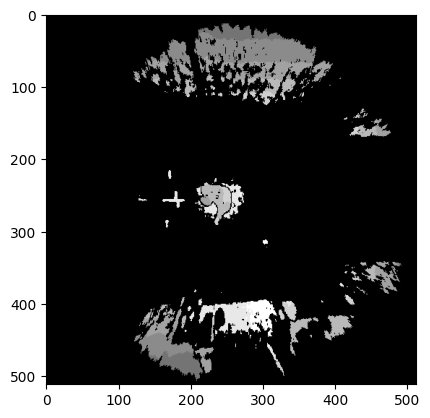


0: 640x640 (no detections), 13.1ms
Speed: 3.3ms preprocess, 13.1ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


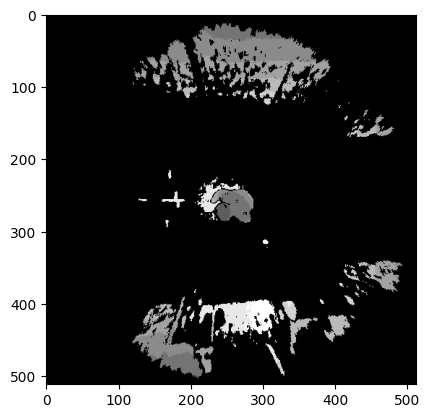


0: 640x640 (no detections), 9.5ms
Speed: 3.3ms preprocess, 9.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


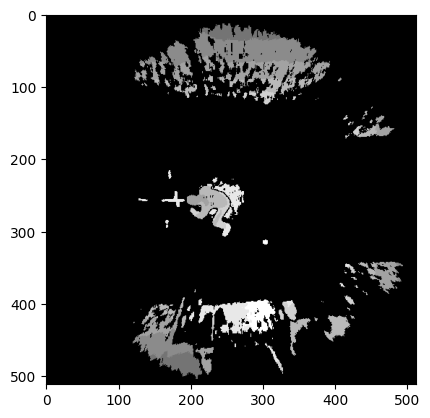


0: 640x640 1 pedestrians-cg9U, 11.5ms
Speed: 3.2ms preprocess, 11.5ms inference, 520.3ms postprocess per image at shape (1, 3, 640, 640)


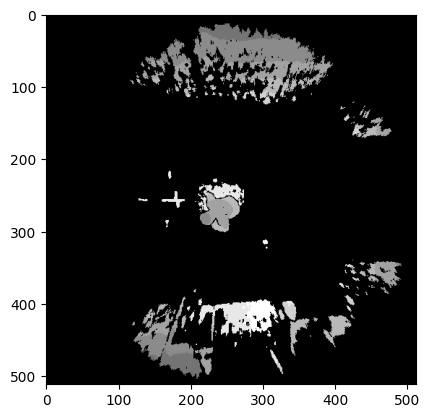

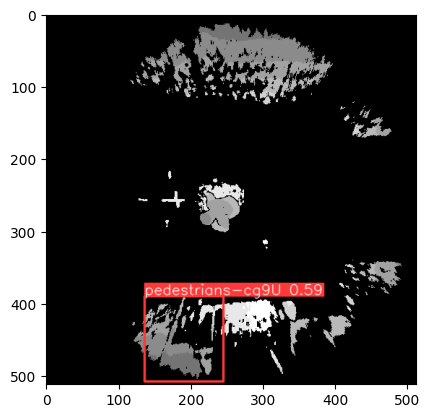


0: 640x640 1 pedestrians-cg9U, 14.3ms
Speed: 6.6ms preprocess, 14.3ms inference, 134.5ms postprocess per image at shape (1, 3, 640, 640)


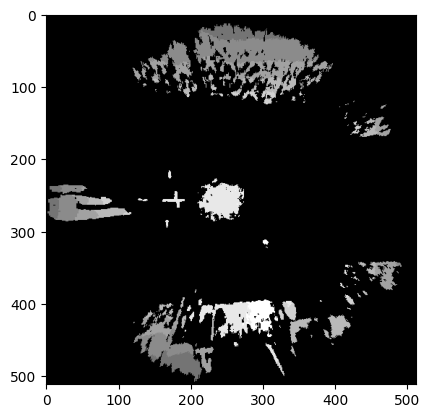

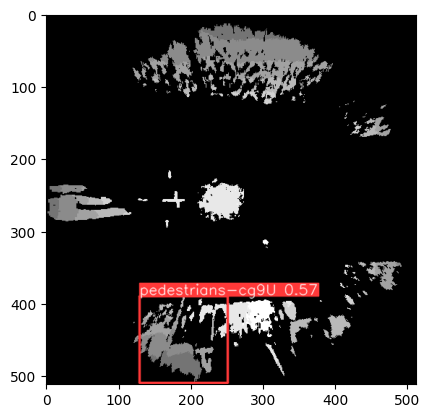


0: 640x640 1 pedestrians-cg9U, 10.2ms
Speed: 3.3ms preprocess, 10.2ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


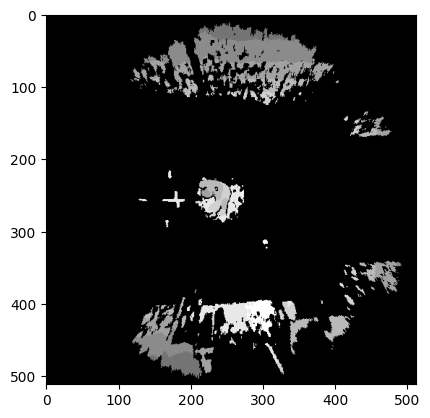

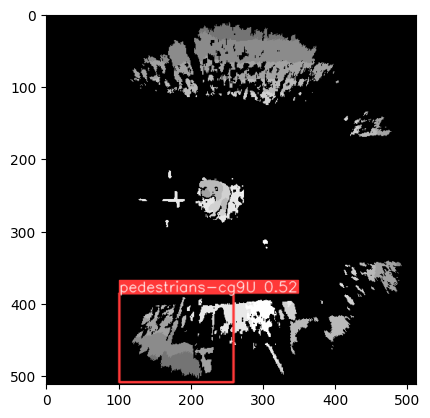


0: 640x640 2 pedestrians-cg9Us, 13.3ms
Speed: 3.6ms preprocess, 13.3ms inference, 5.6ms postprocess per image at shape (1, 3, 640, 640)


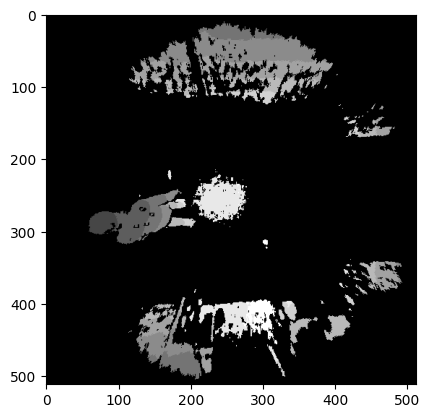

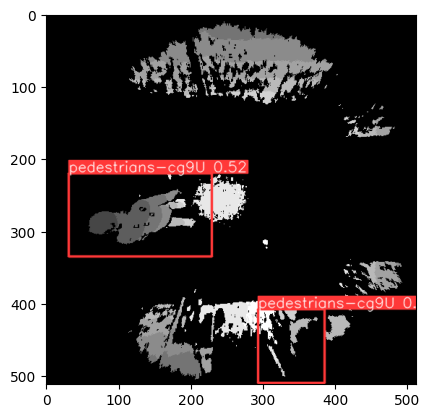


0: 640x640 1 pedestrians-cg9U, 11.3ms
Speed: 3.6ms preprocess, 11.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


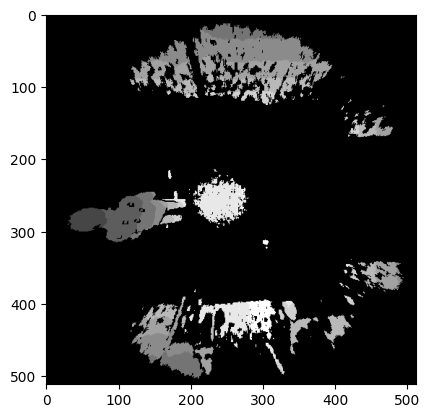

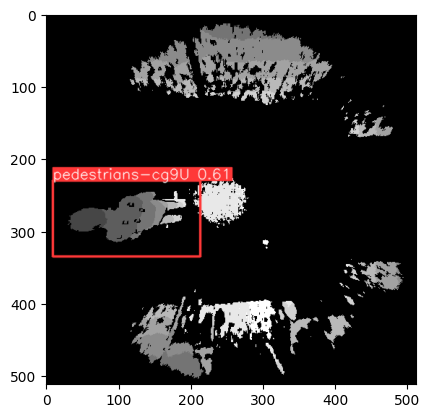


0: 640x640 (no detections), 12.2ms
Speed: 3.6ms preprocess, 12.2ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


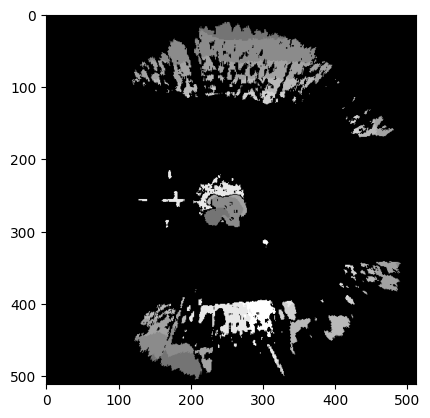


0: 640x640 1 pedestrians-cg9U, 11.3ms
Speed: 3.4ms preprocess, 11.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


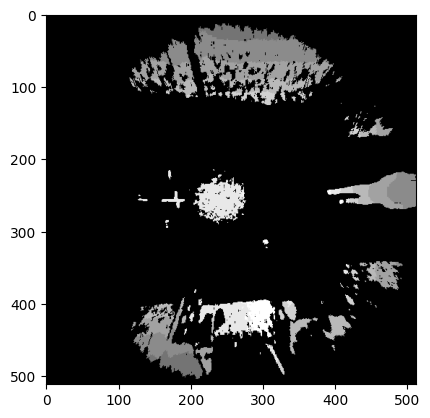

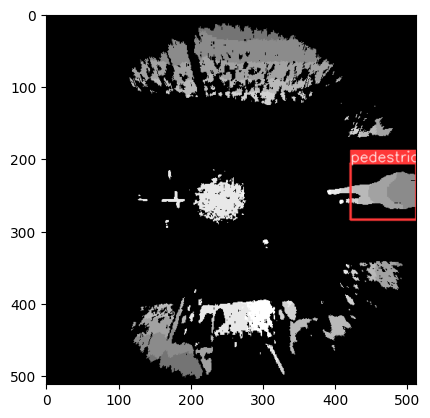


0: 640x640 1 pedestrians-cg9U, 9.0ms
Speed: 3.2ms preprocess, 9.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


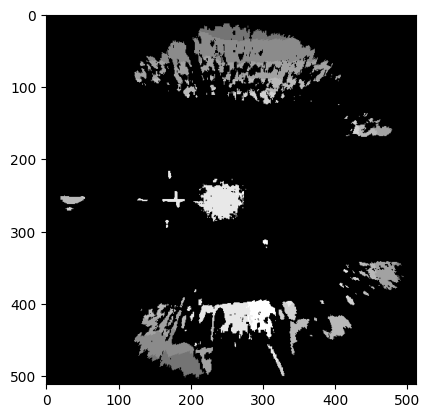

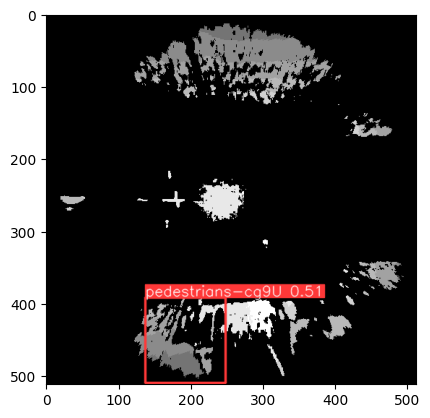


0: 640x640 (no detections), 9.9ms
Speed: 3.3ms preprocess, 9.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


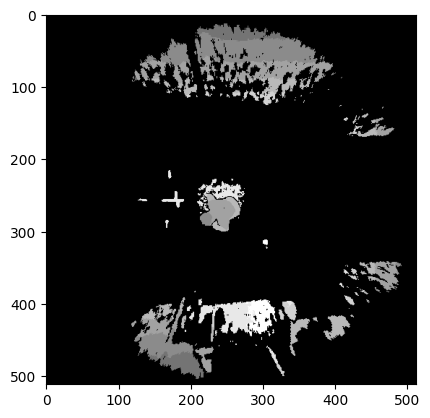


0: 640x640 (no detections), 9.7ms
Speed: 3.2ms preprocess, 9.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


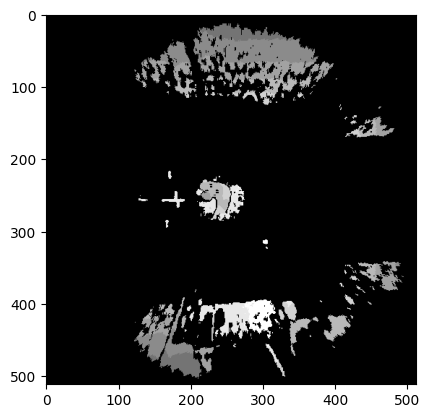


0: 640x640 (no detections), 12.8ms
Speed: 3.5ms preprocess, 12.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


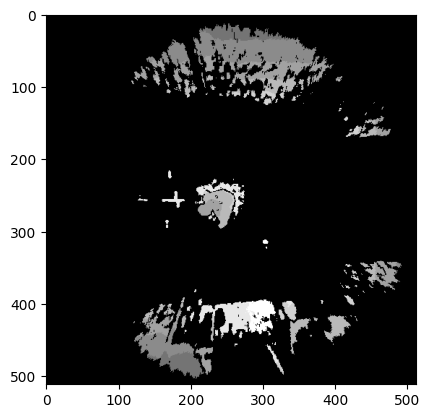


0: 640x640 1 pedestrians-cg9U, 9.6ms
Speed: 3.3ms preprocess, 9.6ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


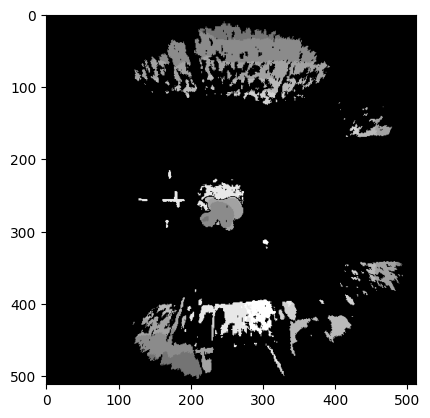

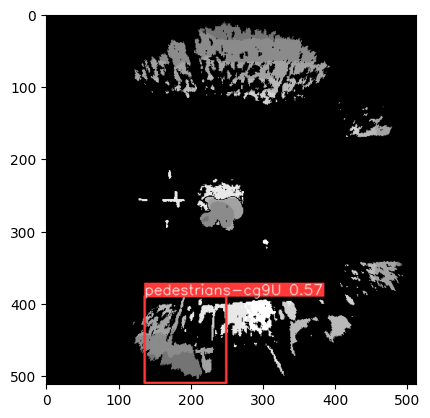


0: 640x640 (no detections), 9.8ms
Speed: 3.3ms preprocess, 9.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


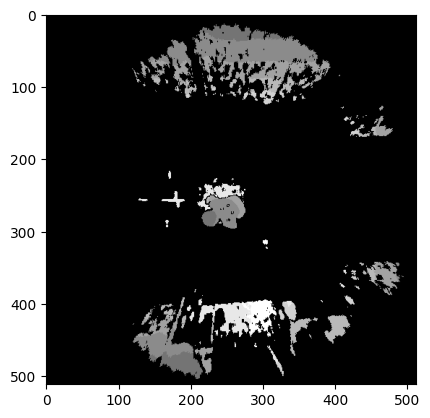


0: 640x640 (no detections), 9.6ms
Speed: 3.2ms preprocess, 9.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


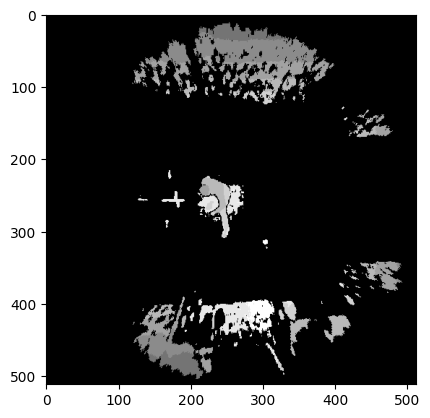


0: 640x640 (no detections), 9.2ms
Speed: 3.2ms preprocess, 9.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


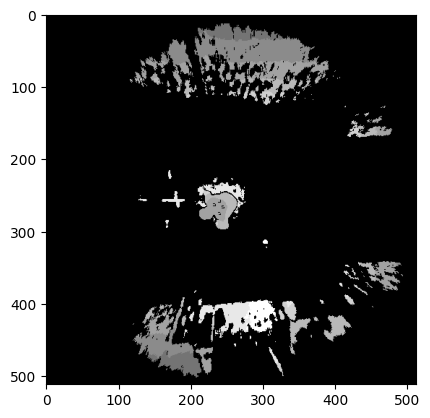


0: 640x640 (no detections), 10.0ms
Speed: 3.2ms preprocess, 10.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


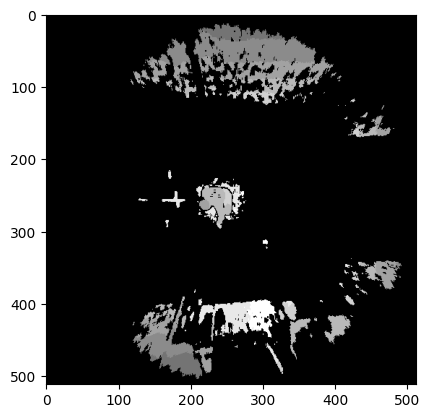


0: 640x640 (no detections), 10.7ms
Speed: 3.7ms preprocess, 10.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


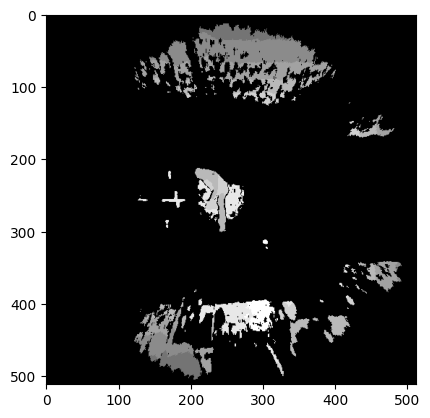


0: 640x640 (no detections), 10.1ms
Speed: 3.3ms preprocess, 10.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


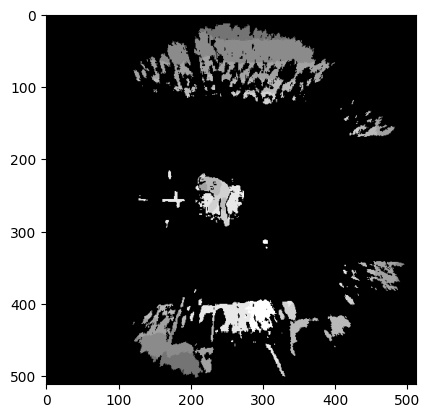


0: 640x640 1 pedestrians-cg9U, 9.4ms
Speed: 3.8ms preprocess, 9.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


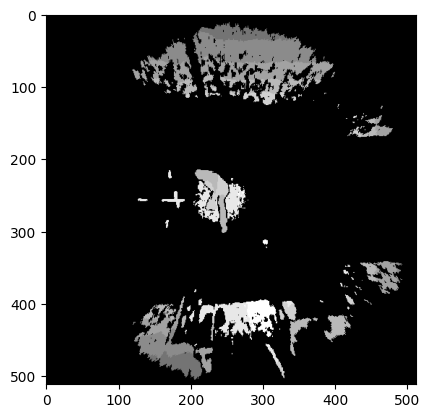

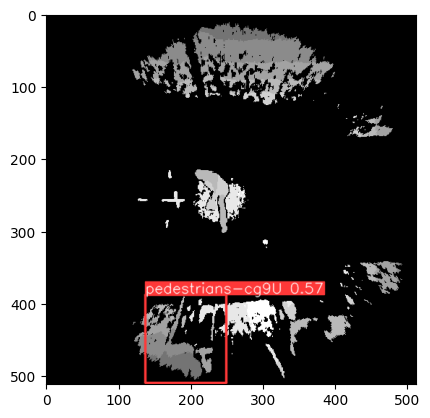


0: 640x640 1 pedestrians-cg9U, 9.9ms
Speed: 3.6ms preprocess, 9.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


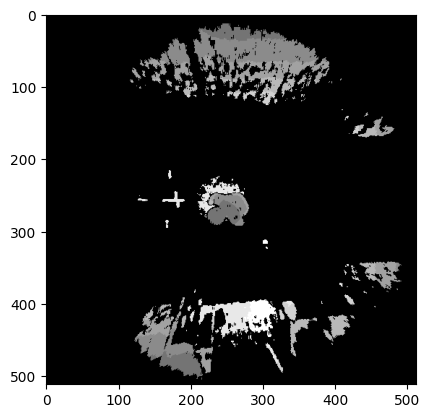

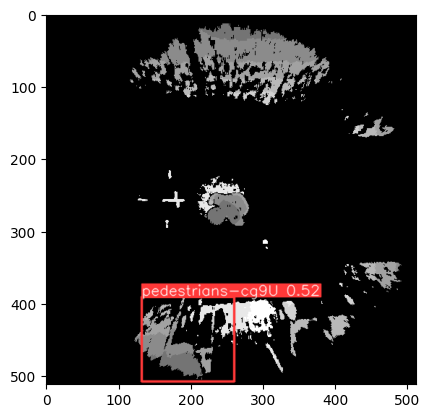


0: 640x640 1 pedestrians-cg9U, 10.2ms
Speed: 3.3ms preprocess, 10.2ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


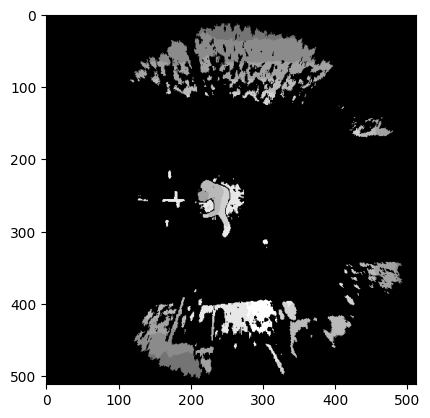

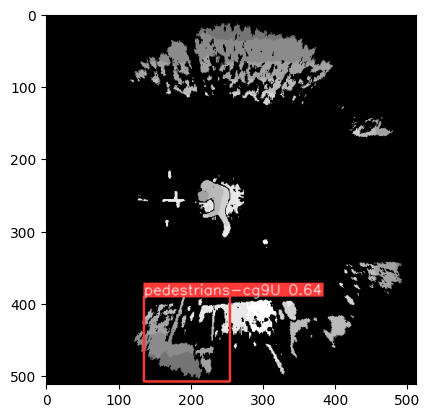


0: 640x640 (no detections), 9.6ms
Speed: 3.2ms preprocess, 9.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


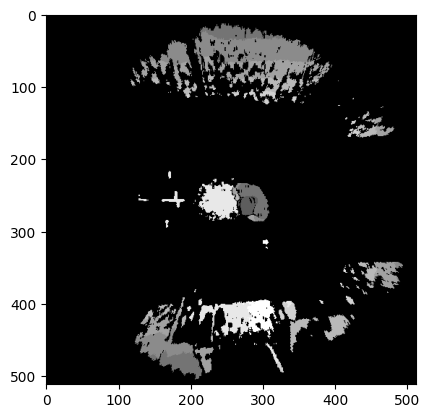


0: 640x640 1 pedestrians-cg9U, 9.6ms
Speed: 3.2ms preprocess, 9.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


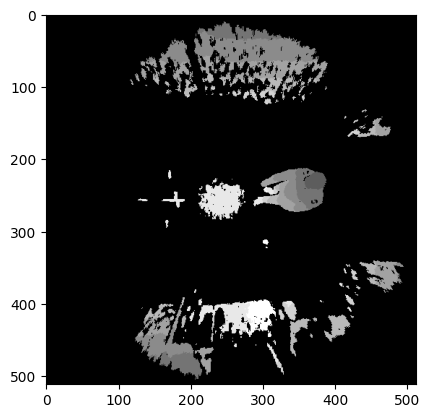

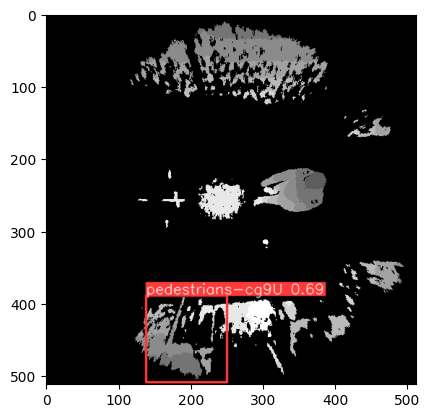


0: 640x640 (no detections), 10.0ms
Speed: 3.4ms preprocess, 10.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


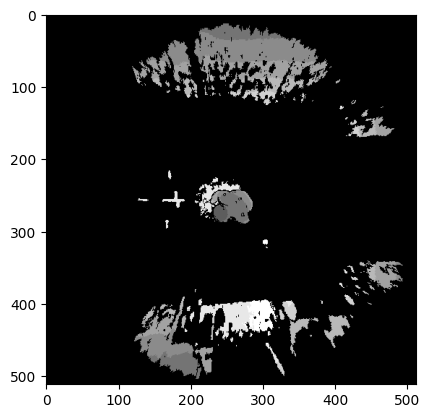


0: 640x640 (no detections), 9.4ms
Speed: 3.7ms preprocess, 9.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


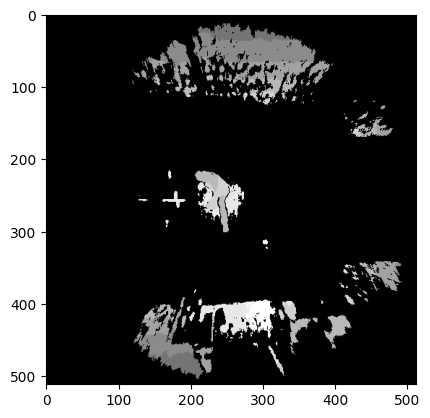


0: 640x640 1 pedestrians-cg9U, 9.3ms
Speed: 3.2ms preprocess, 9.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


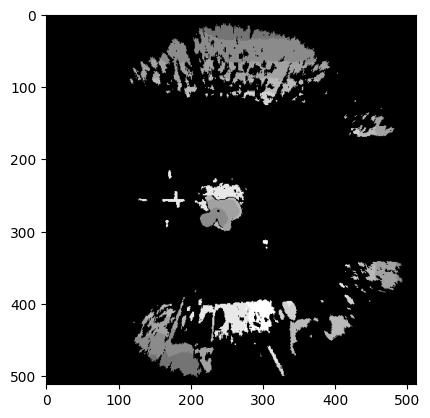

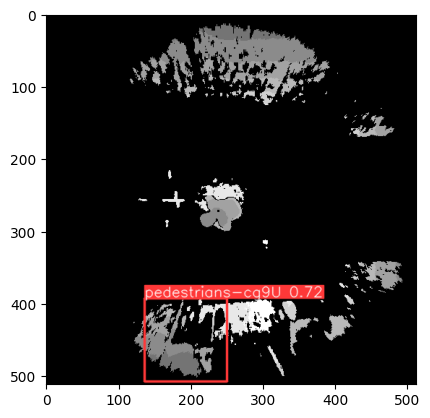


0: 640x640 2 pedestrians-cg9Us, 10.0ms
Speed: 3.2ms preprocess, 10.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


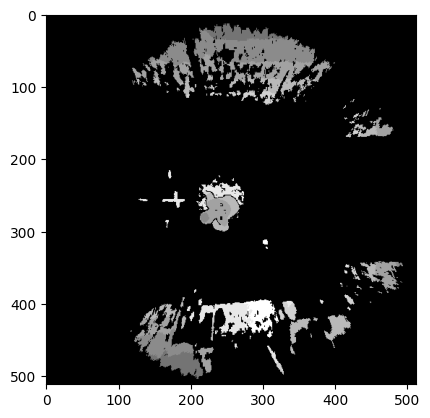

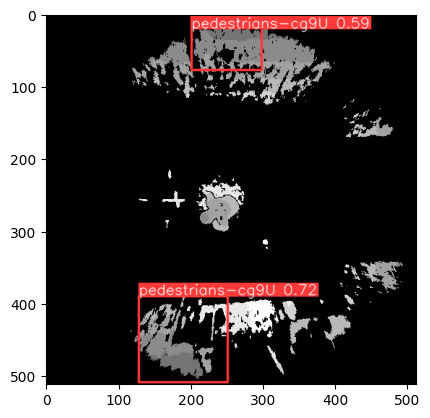


0: 640x640 (no detections), 10.1ms
Speed: 3.9ms preprocess, 10.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


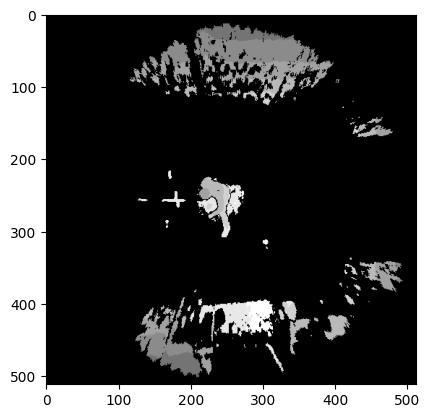


0: 640x640 1 pedestrians-cg9U, 12.9ms
Speed: 4.2ms preprocess, 12.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


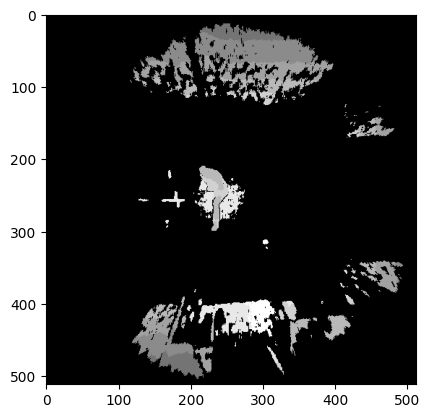

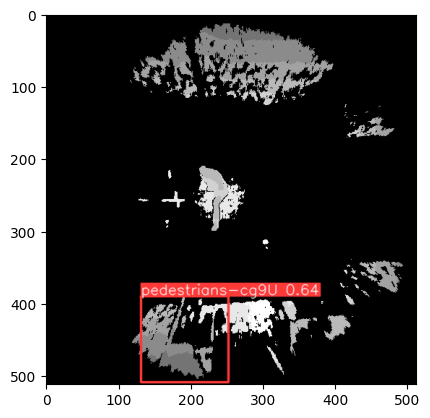


0: 640x640 (no detections), 10.3ms
Speed: 3.6ms preprocess, 10.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


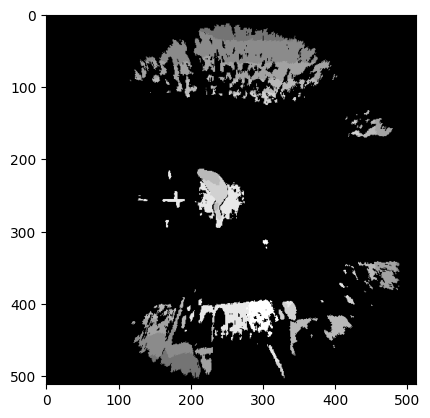


0: 640x640 1 pedestrians-cg9U, 9.9ms
Speed: 3.7ms preprocess, 9.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


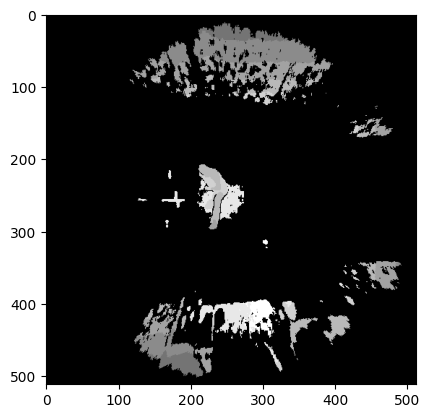

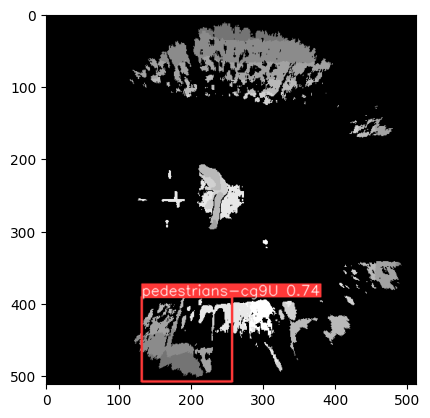


0: 640x640 (no detections), 9.0ms
Speed: 7.0ms preprocess, 9.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


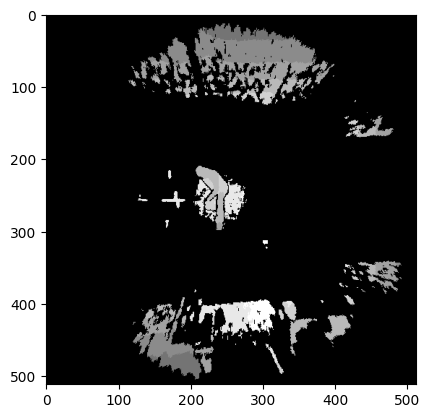


0: 640x640 (no detections), 9.3ms
Speed: 3.2ms preprocess, 9.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


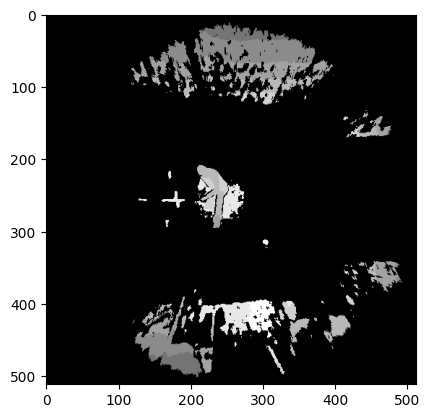


0: 640x640 (no detections), 11.3ms
Speed: 4.3ms preprocess, 11.3ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


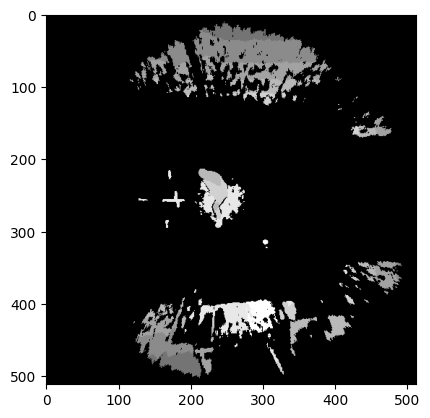


0: 640x640 2 pedestrians-cg9Us, 9.8ms
Speed: 3.9ms preprocess, 9.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


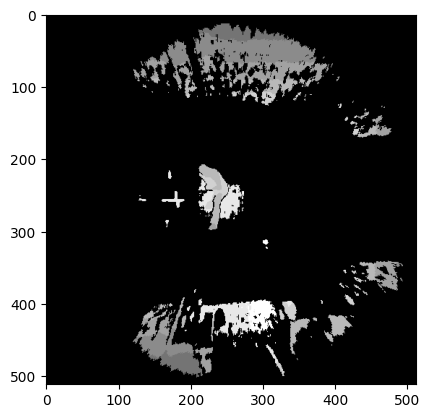

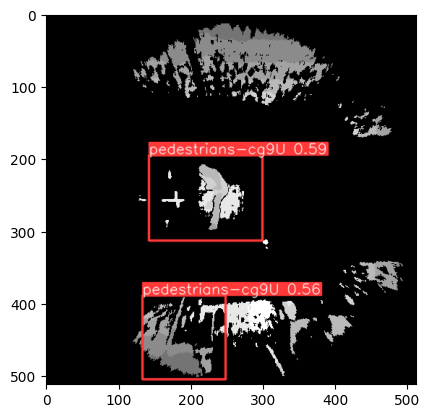


0: 640x640 1 pedestrians-cg9U, 13.5ms
Speed: 3.3ms preprocess, 13.5ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


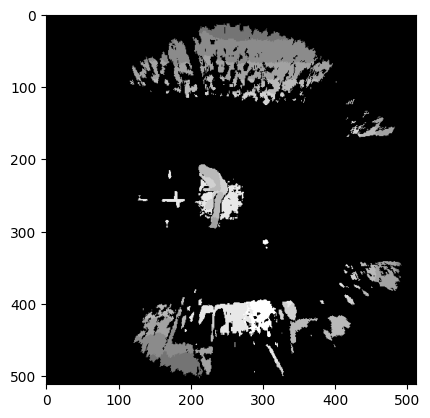

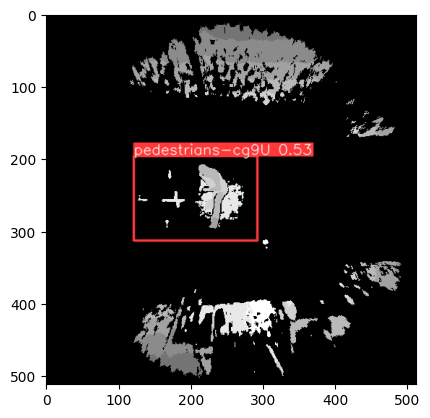


0: 640x640 (no detections), 17.9ms
Speed: 3.3ms preprocess, 17.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


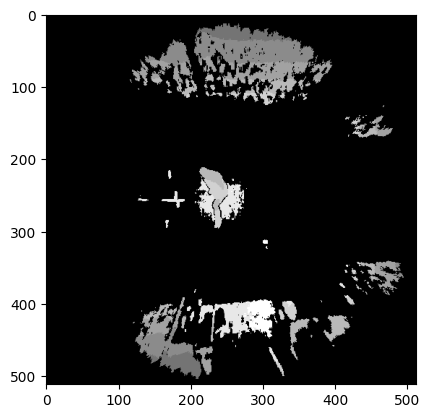


0: 640x640 2 pedestrians-cg9Us, 14.6ms
Speed: 3.5ms preprocess, 14.6ms inference, 5.9ms postprocess per image at shape (1, 3, 640, 640)


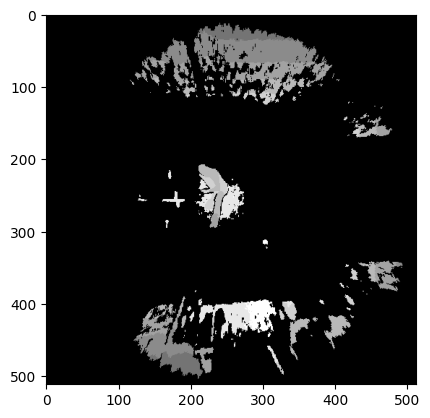

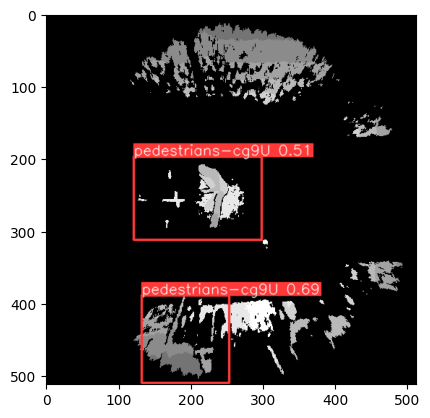


0: 640x640 2 pedestrians-cg9Us, 10.4ms
Speed: 3.3ms preprocess, 10.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


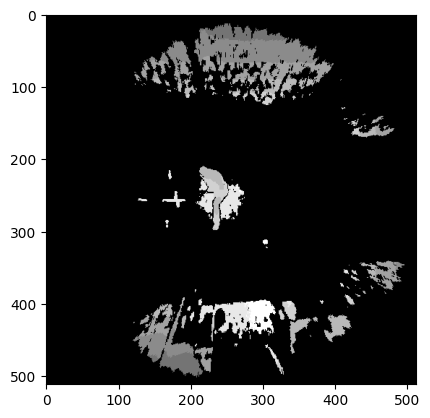

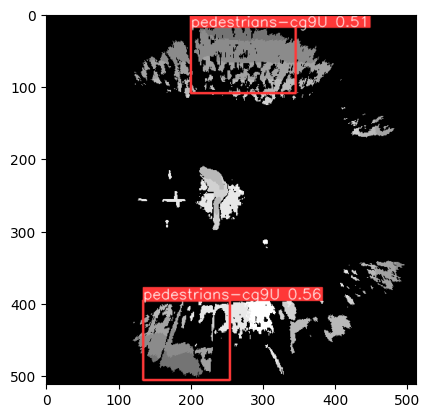


0: 640x640 1 pedestrians-cg9U, 8.4ms
Speed: 3.7ms preprocess, 8.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


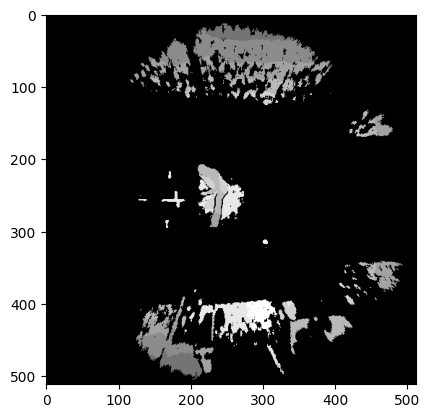

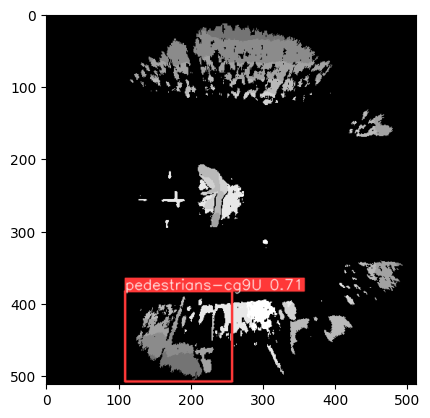


0: 640x640 1 pedestrians-cg9U, 11.9ms
Speed: 6.1ms preprocess, 11.9ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


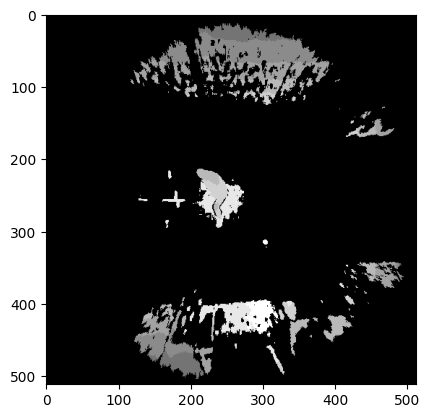

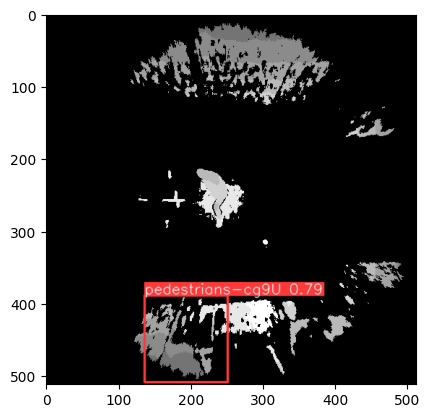


0: 640x640 (no detections), 10.0ms
Speed: 3.5ms preprocess, 10.0ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


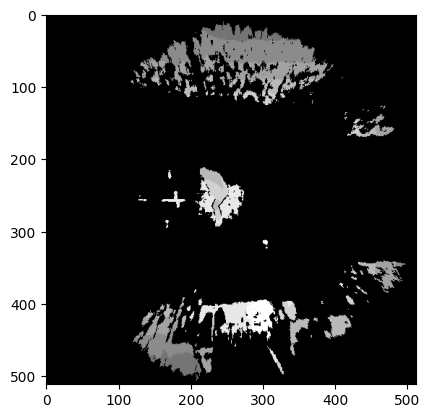


0: 640x640 1 pedestrians-cg9U, 12.5ms
Speed: 3.4ms preprocess, 12.5ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


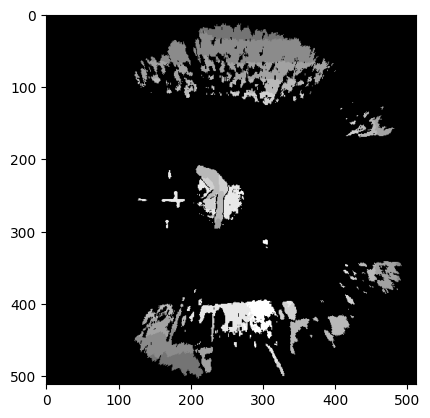

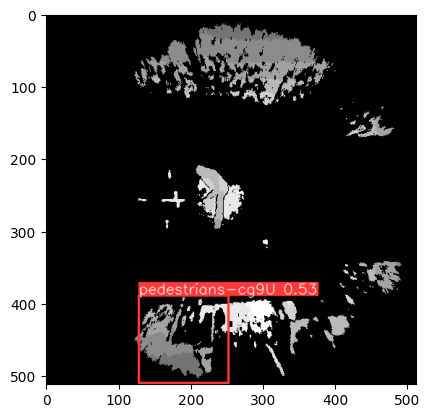


0: 640x640 1 pedestrians-cg9U, 8.9ms
Speed: 3.7ms preprocess, 8.9ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


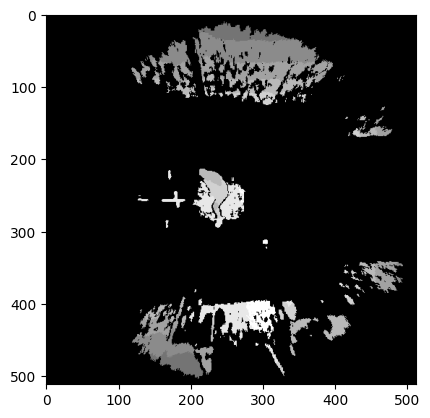

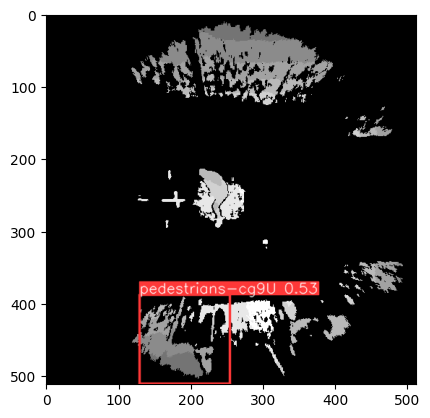


0: 640x640 1 pedestrians-cg9U, 9.3ms
Speed: 3.3ms preprocess, 9.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


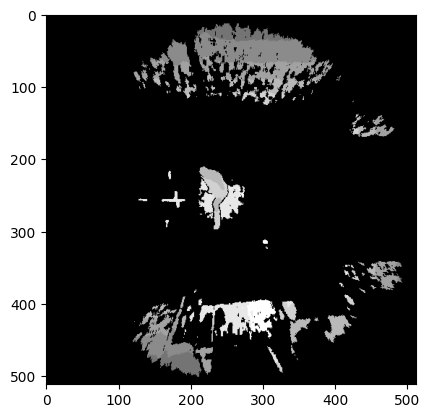

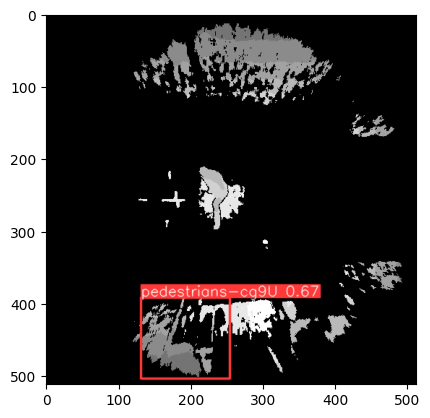


0: 640x640 1 pedestrians-cg9U, 11.1ms
Speed: 3.3ms preprocess, 11.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


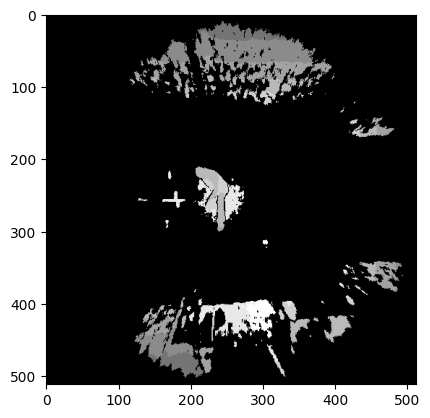

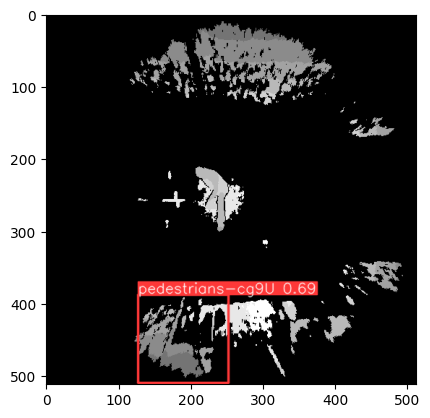


0: 640x640 (no detections), 9.7ms
Speed: 3.6ms preprocess, 9.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


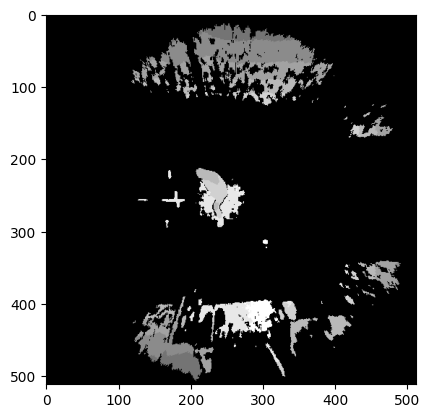


0: 640x640 (no detections), 8.7ms
Speed: 3.6ms preprocess, 8.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


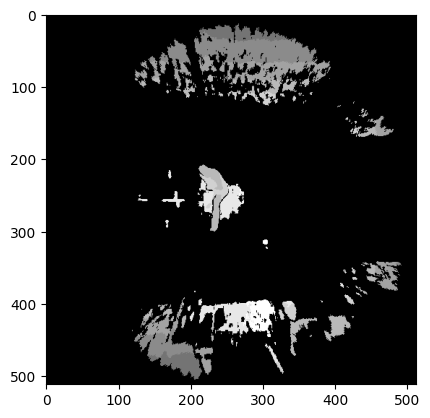


0: 640x640 1 pedestrians-cg9U, 10.3ms
Speed: 3.2ms preprocess, 10.3ms inference, 3.7ms postprocess per image at shape (1, 3, 640, 640)


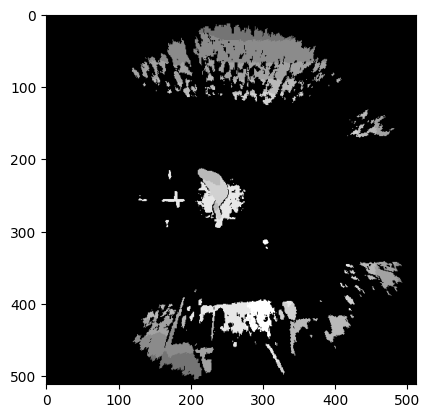

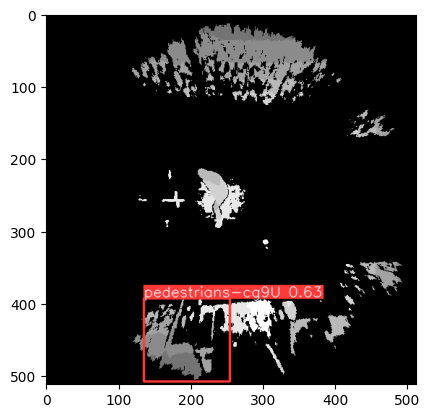


0: 640x640 (no detections), 11.4ms
Speed: 5.4ms preprocess, 11.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


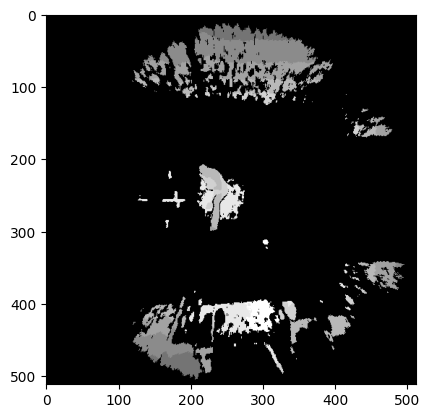


0: 640x640 1 pedestrians-cg9U, 10.6ms
Speed: 3.2ms preprocess, 10.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


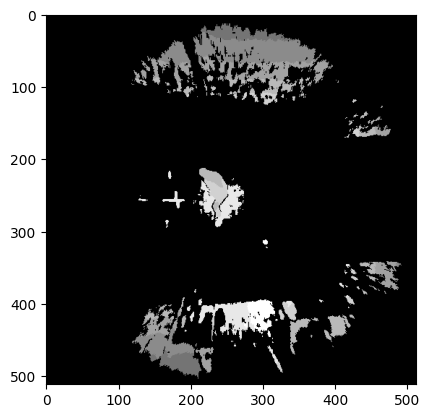

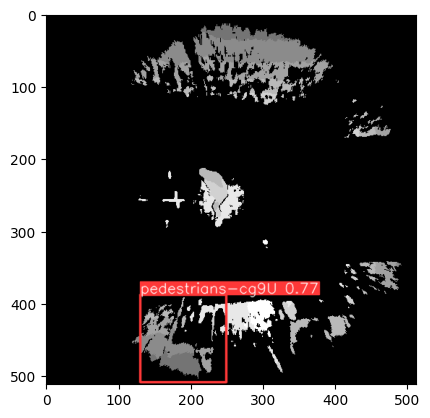


0: 640x640 1 pedestrians-cg9U, 11.2ms
Speed: 3.5ms preprocess, 11.2ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


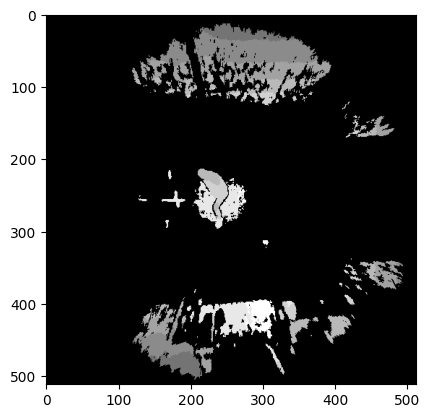

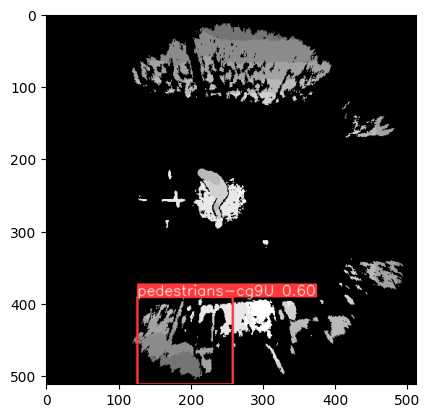


0: 640x640 1 pedestrians-cg9U, 11.0ms
Speed: 3.3ms preprocess, 11.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


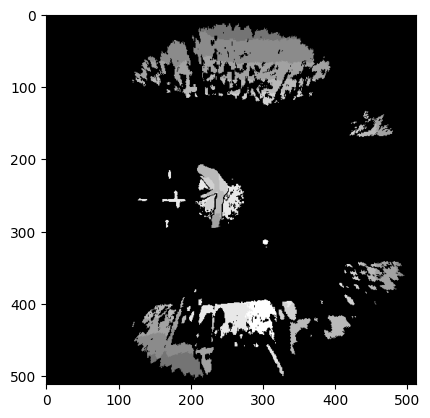

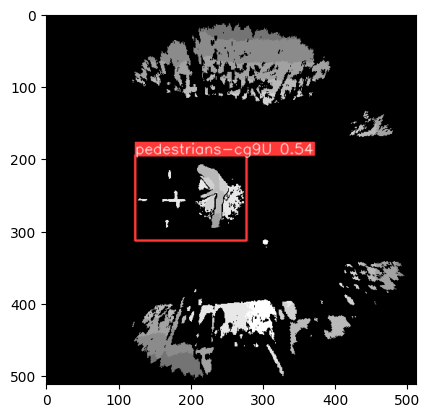


0: 640x640 (no detections), 12.5ms
Speed: 3.4ms preprocess, 12.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


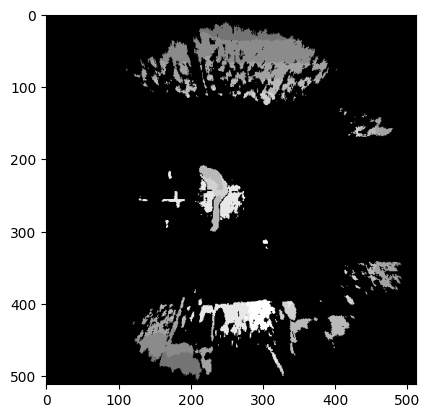


0: 640x640 (no detections), 11.0ms
Speed: 3.5ms preprocess, 11.0ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


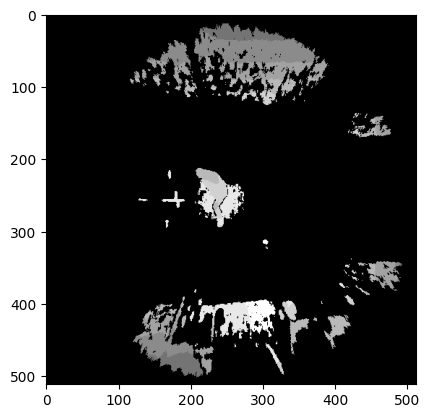


0: 640x640 (no detections), 13.5ms
Speed: 3.4ms preprocess, 13.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


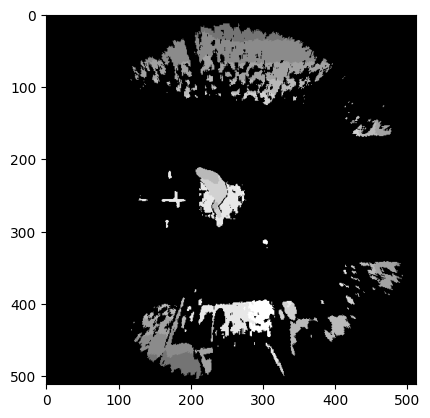


0: 640x640 2 pedestrians-cg9Us, 11.6ms
Speed: 3.4ms preprocess, 11.6ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


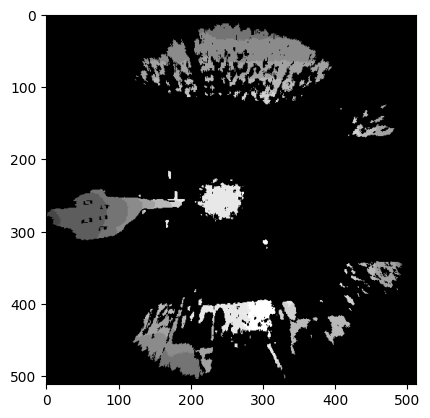

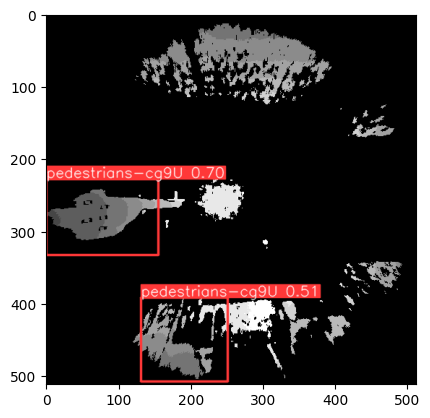


0: 640x640 2 pedestrians-cg9Us, 12.4ms
Speed: 3.5ms preprocess, 12.4ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


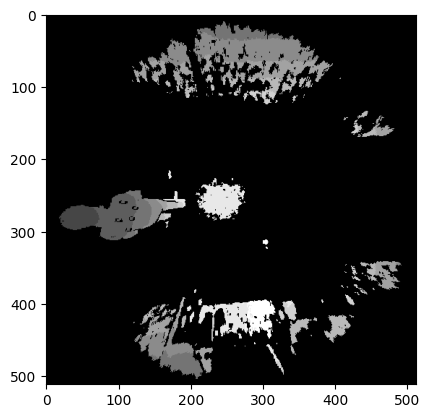

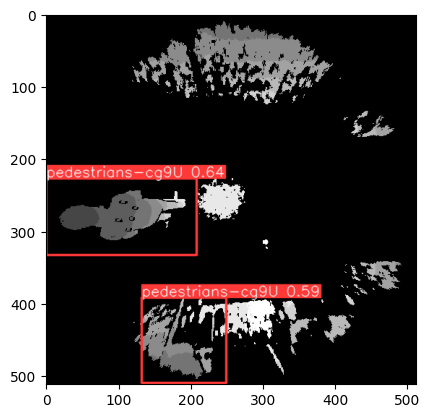


0: 640x640 1 pedestrians-cg9U, 12.8ms
Speed: 3.6ms preprocess, 12.8ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


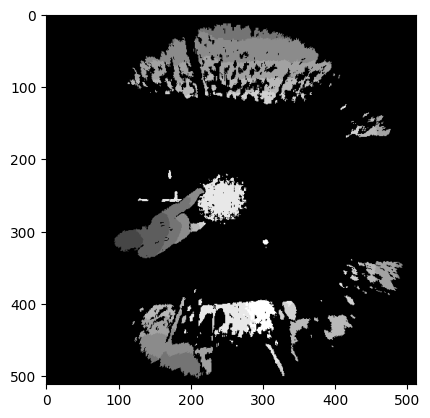

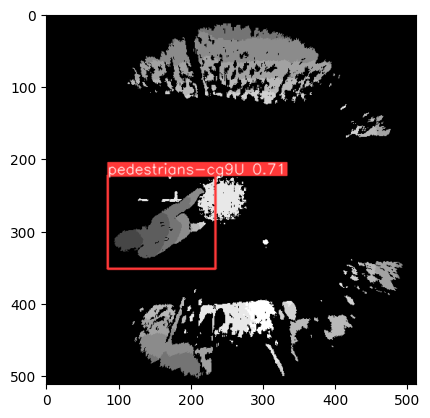


0: 640x640 (no detections), 8.3ms
Speed: 3.2ms preprocess, 8.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


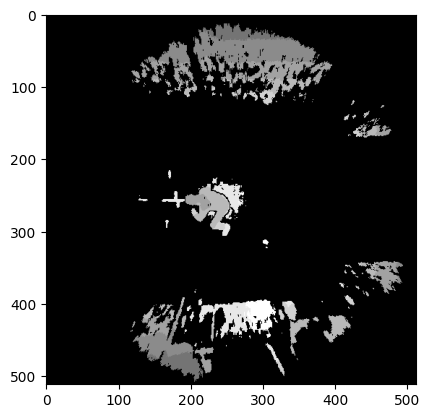


0: 640x640 (no detections), 8.9ms
Speed: 3.3ms preprocess, 8.9ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


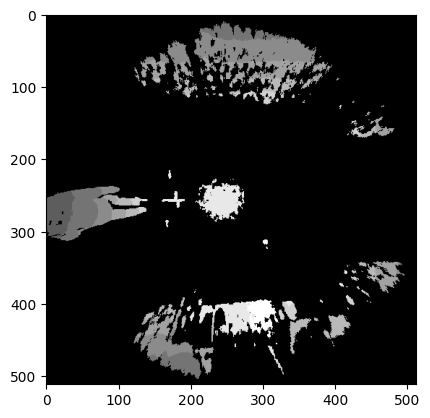


0: 640x640 (no detections), 9.0ms
Speed: 3.3ms preprocess, 9.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


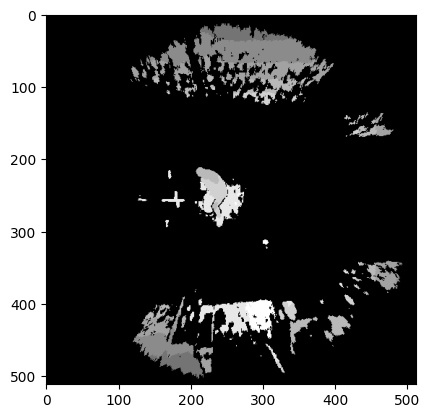


0: 640x640 1 pedestrians-cg9U, 14.3ms
Speed: 4.6ms preprocess, 14.3ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


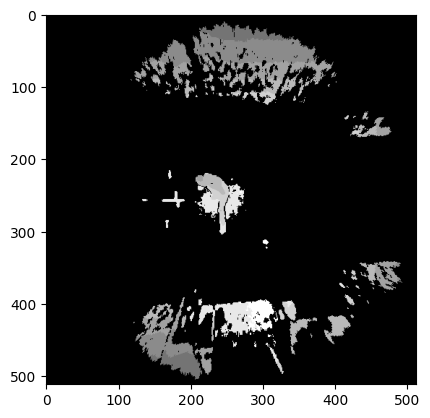

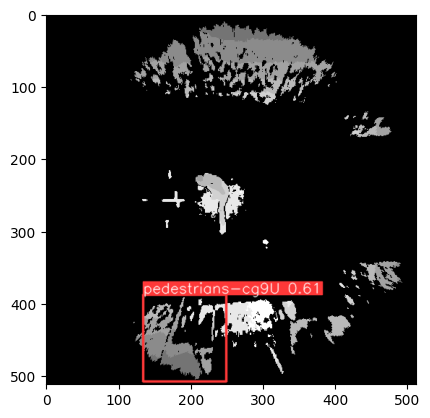


0: 640x640 1 pedestrians-cg9U, 9.2ms
Speed: 3.3ms preprocess, 9.2ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


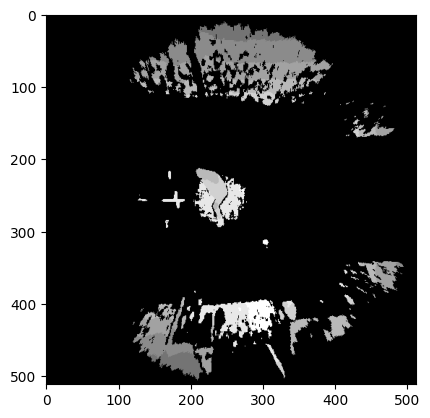

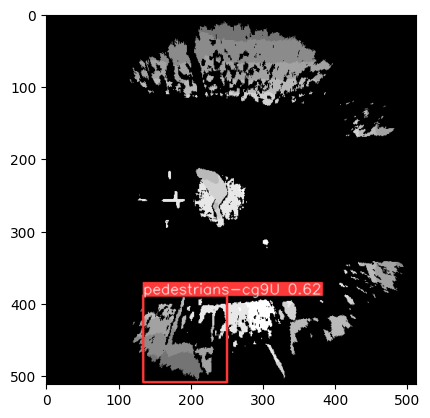


0: 640x640 1 pedestrians-cg9U, 8.4ms
Speed: 3.4ms preprocess, 8.4ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


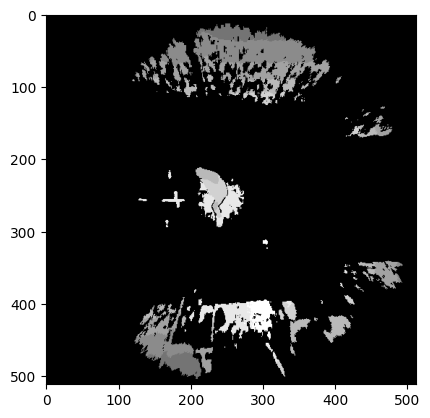

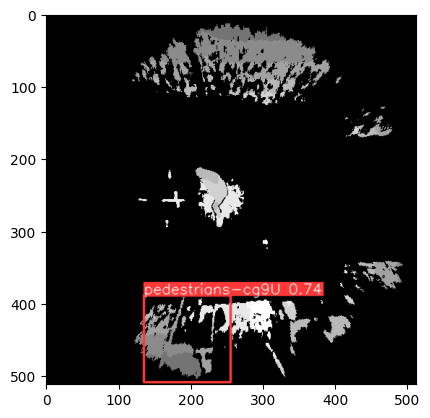


0: 640x640 (no detections), 12.1ms
Speed: 4.4ms preprocess, 12.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


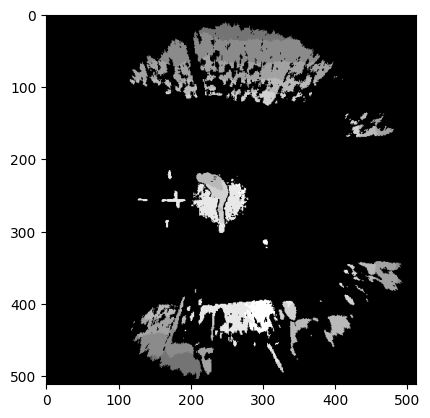


0: 640x640 1 pedestrians-cg9U, 12.3ms
Speed: 5.0ms preprocess, 12.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


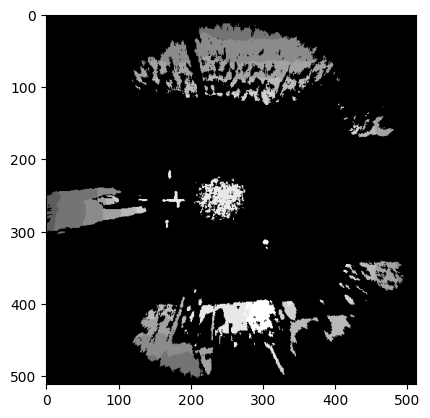

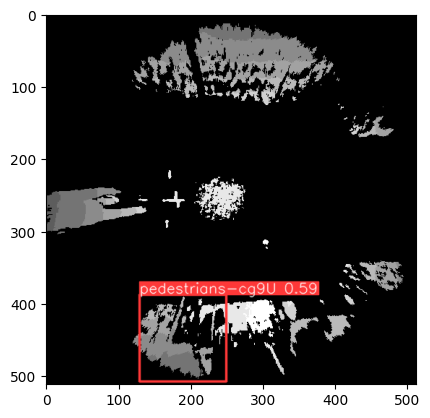


0: 640x640 1 pedestrians-cg9U, 9.5ms
Speed: 3.2ms preprocess, 9.5ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


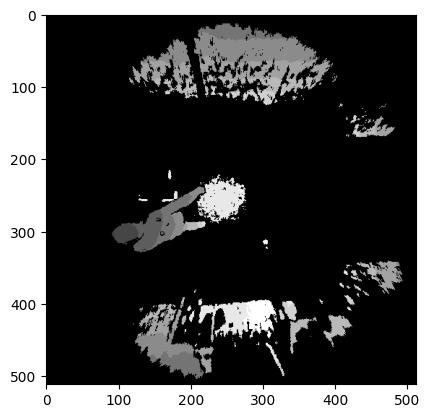

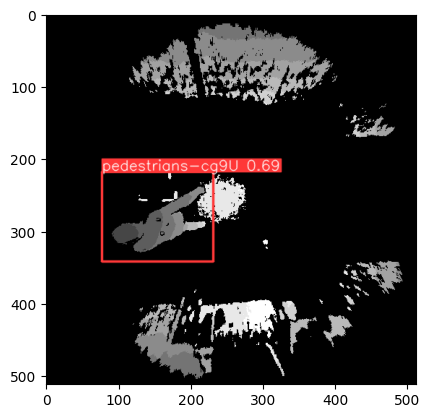


0: 640x640 (no detections), 12.4ms
Speed: 3.3ms preprocess, 12.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


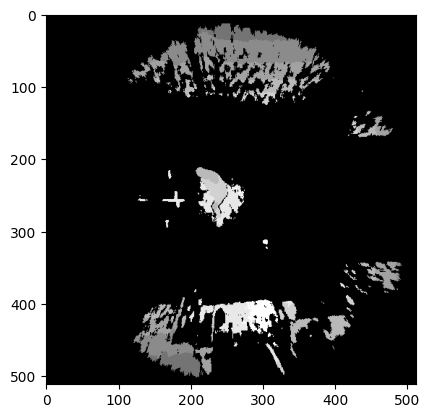


0: 640x640 1 pedestrians-cg9U, 14.2ms
Speed: 3.1ms preprocess, 14.2ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


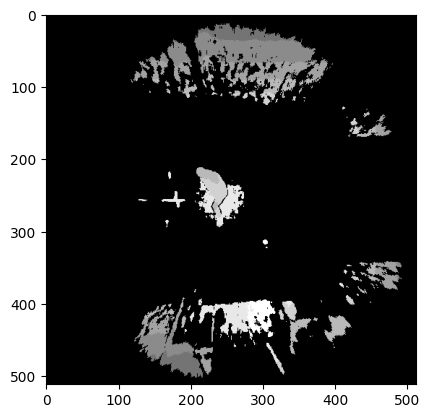

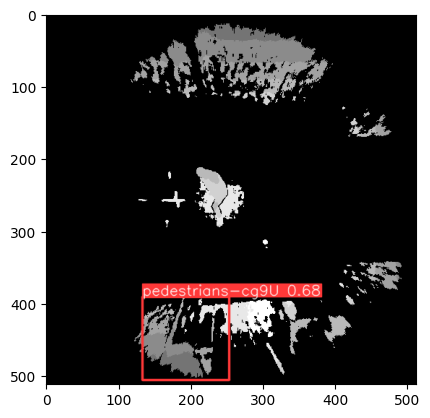


0: 640x640 2 pedestrians-cg9Us, 11.4ms
Speed: 4.3ms preprocess, 11.4ms inference, 3.6ms postprocess per image at shape (1, 3, 640, 640)


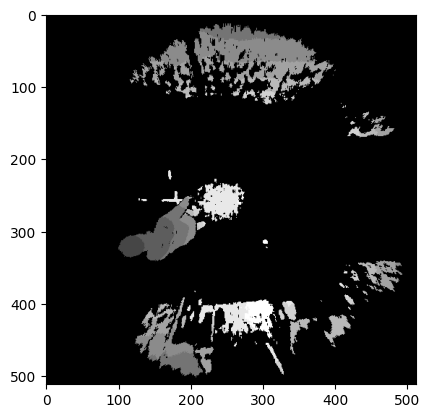

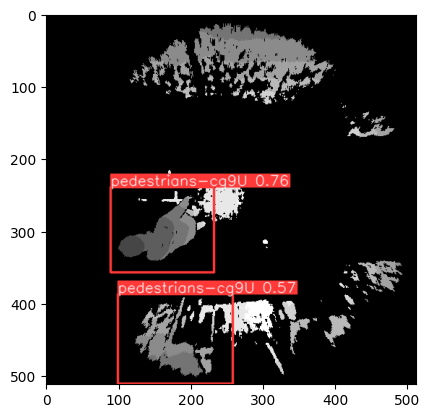


0: 640x640 (no detections), 10.6ms
Speed: 3.1ms preprocess, 10.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


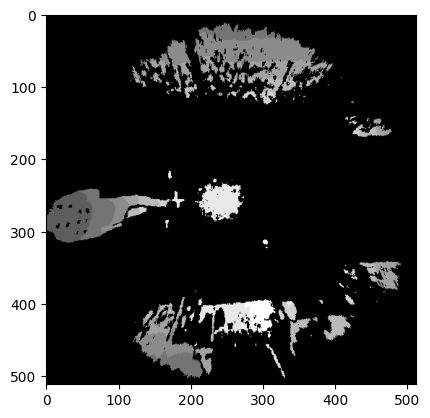


0: 640x640 (no detections), 9.4ms
Speed: 3.3ms preprocess, 9.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


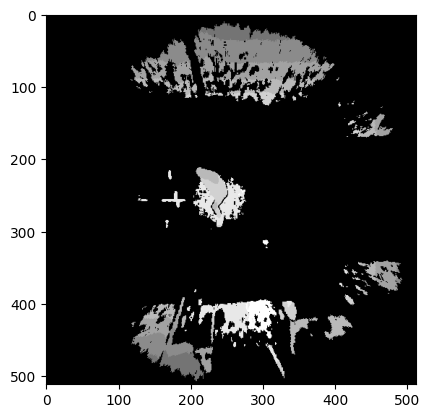


0: 640x640 1 pedestrians-cg9U, 11.9ms
Speed: 3.7ms preprocess, 11.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


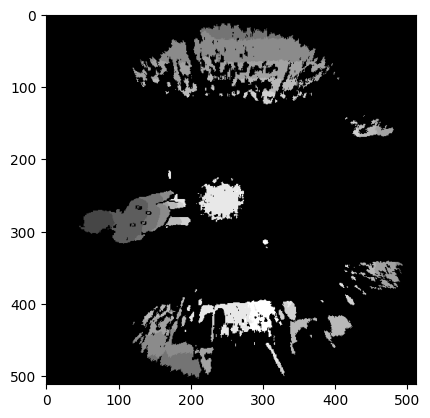

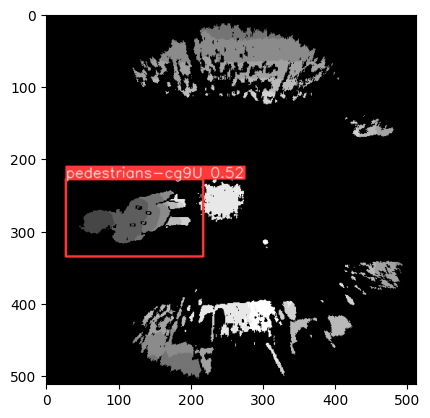


0: 640x640 2 pedestrians-cg9Us, 9.3ms
Speed: 3.3ms preprocess, 9.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


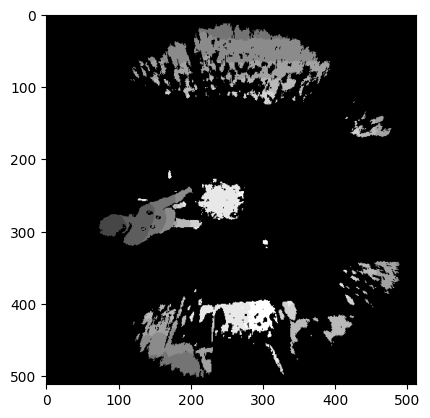

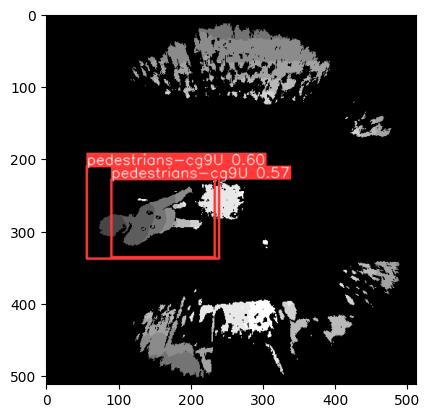


0: 640x640 (no detections), 11.2ms
Speed: 5.9ms preprocess, 11.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


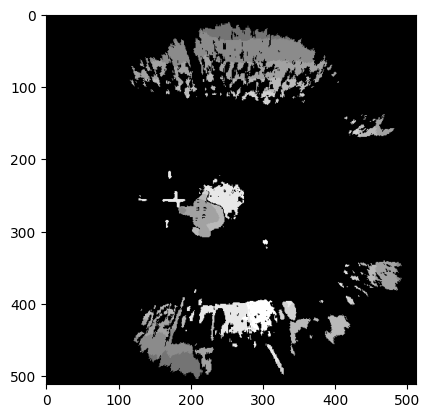


0: 640x640 (no detections), 14.0ms
Speed: 3.3ms preprocess, 14.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


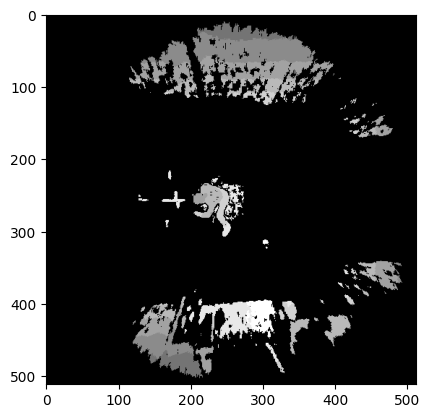


0: 640x640 (no detections), 10.1ms
Speed: 3.7ms preprocess, 10.1ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


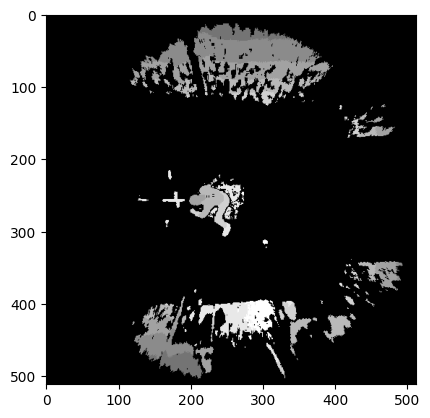


0: 640x640 (no detections), 11.5ms
Speed: 4.8ms preprocess, 11.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


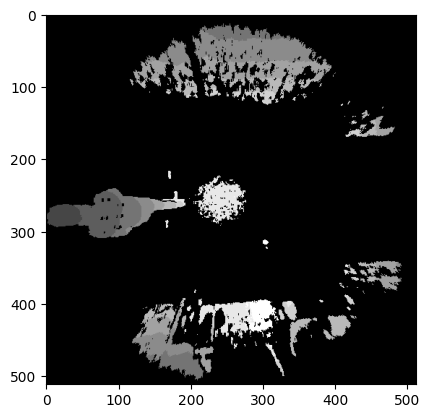


0: 640x640 1 pedestrians-cg9U, 11.8ms
Speed: 5.1ms preprocess, 11.8ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


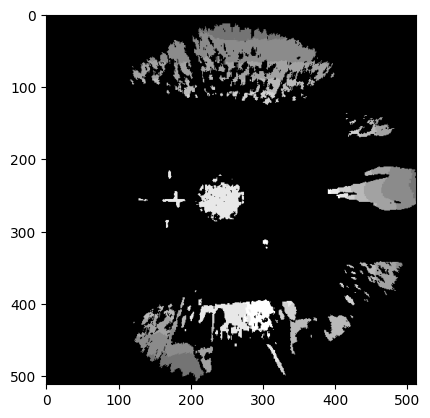

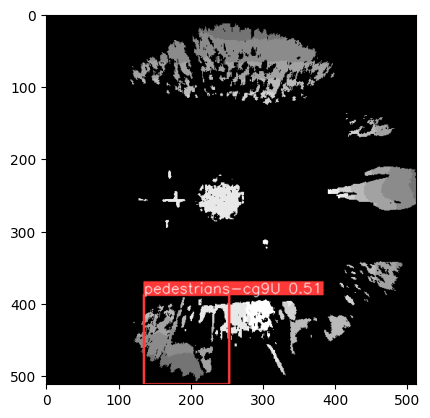


0: 640x640 2 pedestrians-cg9Us, 15.1ms
Speed: 3.4ms preprocess, 15.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


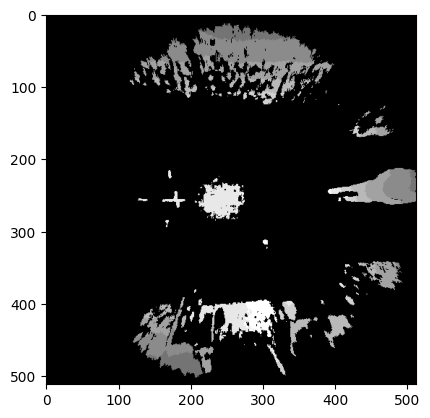

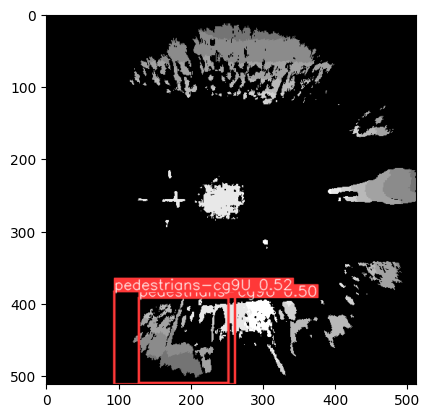


0: 640x640 (no detections), 11.5ms
Speed: 5.7ms preprocess, 11.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


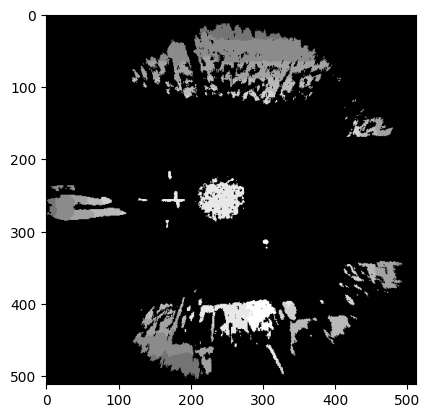


0: 640x640 (no detections), 10.3ms
Speed: 3.4ms preprocess, 10.3ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


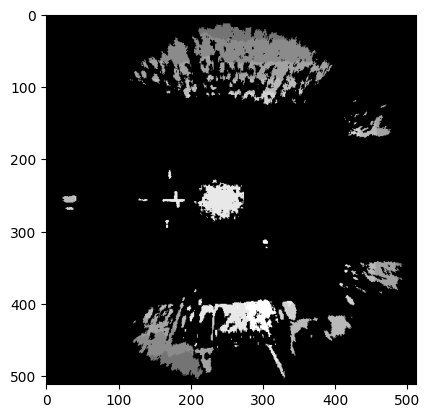


0: 640x640 1 pedestrians-cg9U, 9.7ms
Speed: 3.3ms preprocess, 9.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


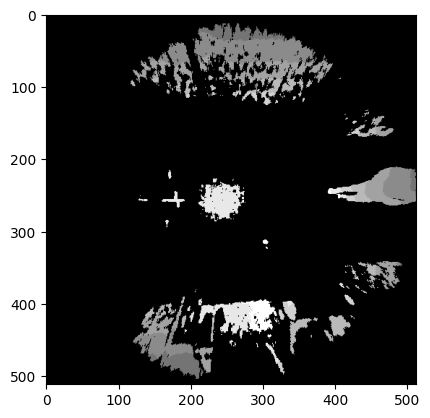

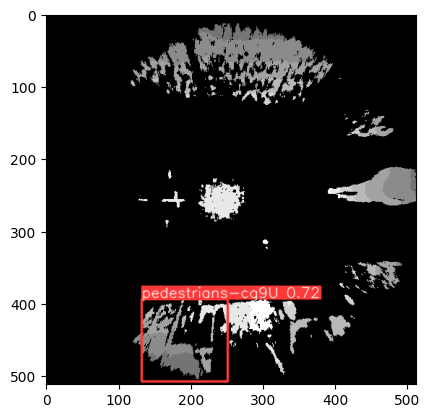


0: 640x640 (no detections), 10.0ms
Speed: 3.4ms preprocess, 10.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


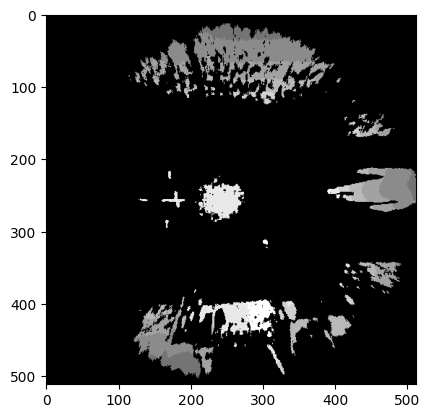


0: 640x640 1 pedestrians-cg9U, 10.0ms
Speed: 3.7ms preprocess, 10.0ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


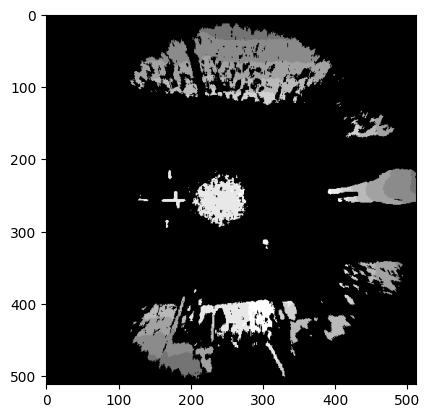

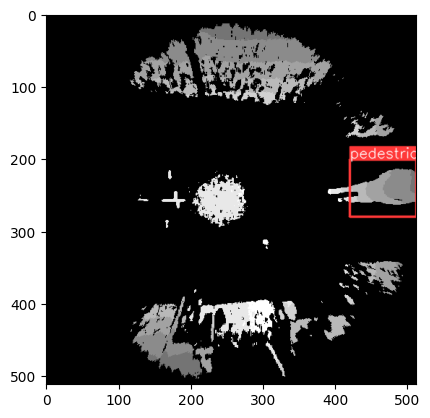


0: 640x640 1 pedestrians-cg9U, 10.5ms
Speed: 3.4ms preprocess, 10.5ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


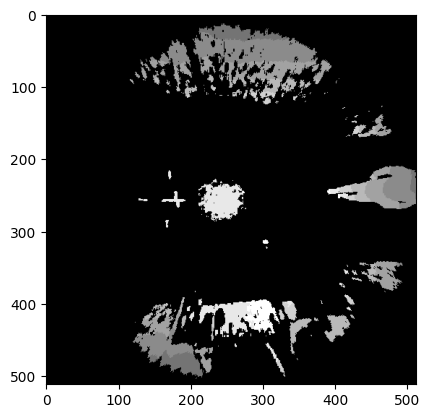

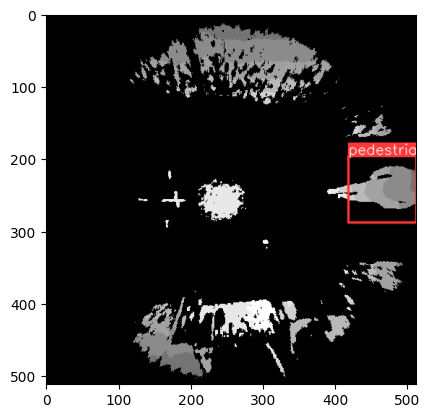


0: 640x640 1 pedestrians-cg9U, 12.5ms
Speed: 3.4ms preprocess, 12.5ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


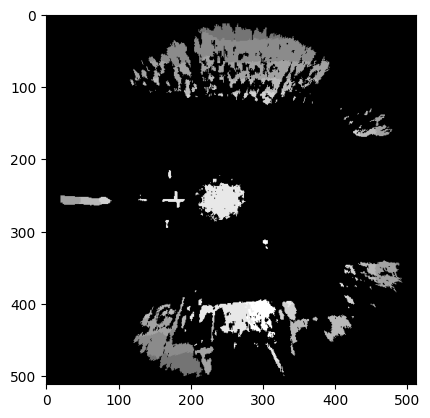

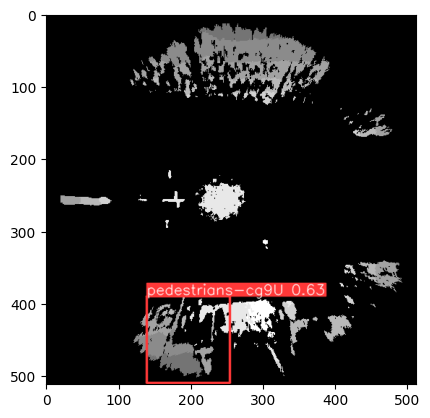


0: 640x640 1 pedestrians-cg9U, 8.8ms
Speed: 3.3ms preprocess, 8.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


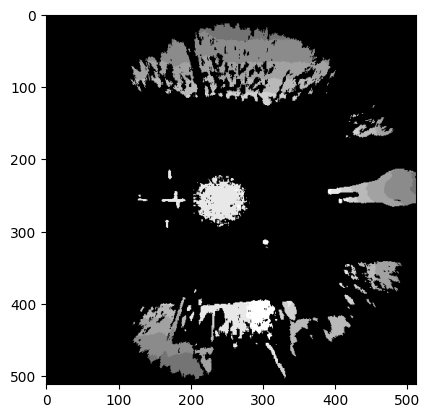

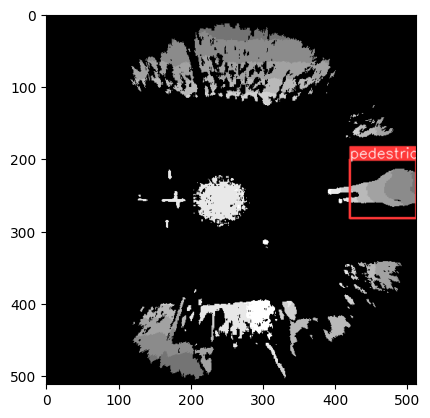


0: 640x640 1 pedestrians-cg9U, 9.1ms
Speed: 3.9ms preprocess, 9.1ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


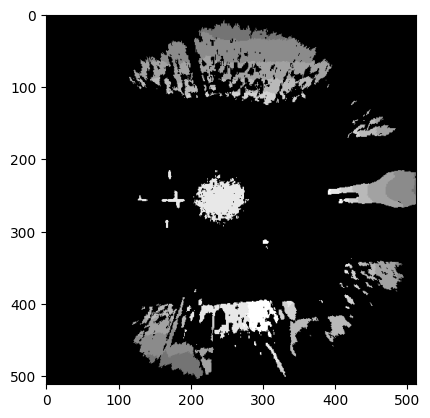

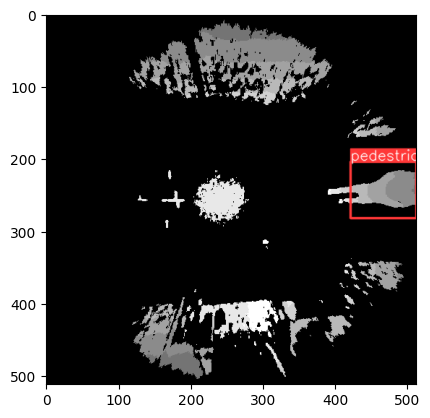


0: 640x640 (no detections), 8.6ms
Speed: 3.3ms preprocess, 8.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


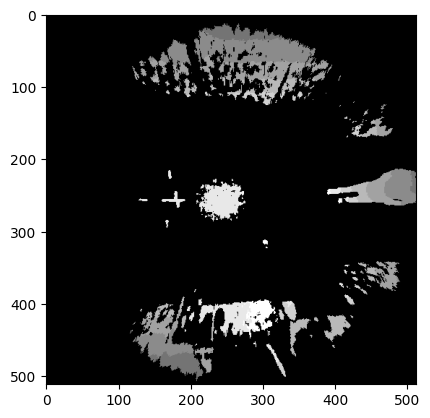


0: 640x640 (no detections), 9.4ms
Speed: 3.2ms preprocess, 9.4ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


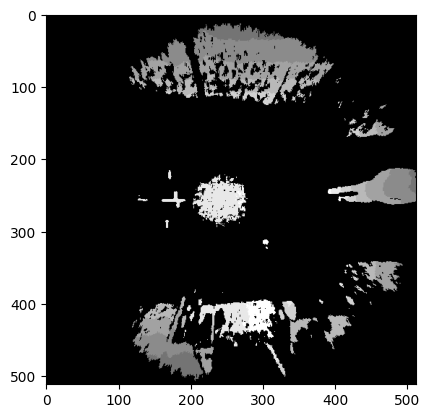


0: 640x640 (no detections), 11.8ms
Speed: 3.4ms preprocess, 11.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


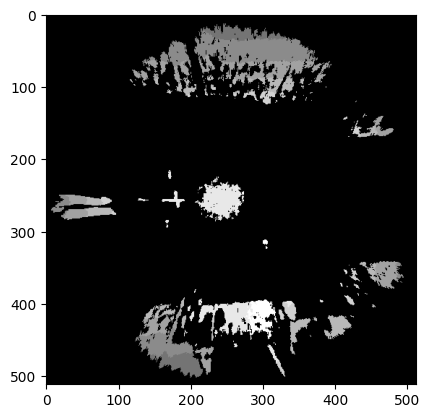


0: 640x640 1 pedestrians-cg9U, 11.9ms
Speed: 5.3ms preprocess, 11.9ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


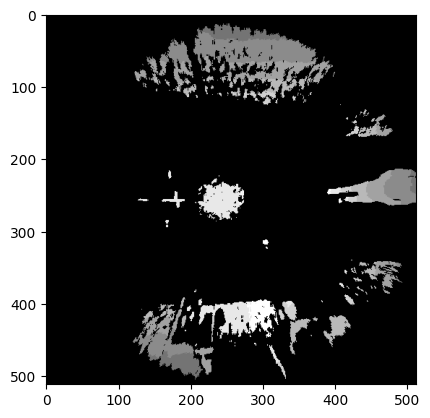

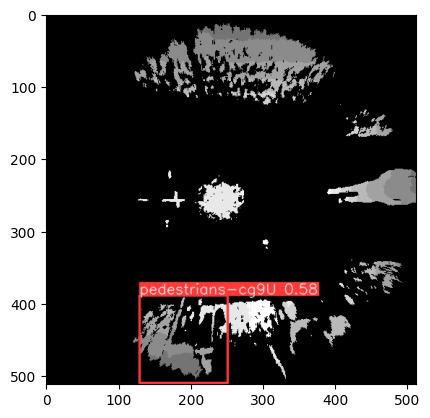


0: 640x640 1 pedestrians-cg9U, 9.2ms
Speed: 7.0ms preprocess, 9.2ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


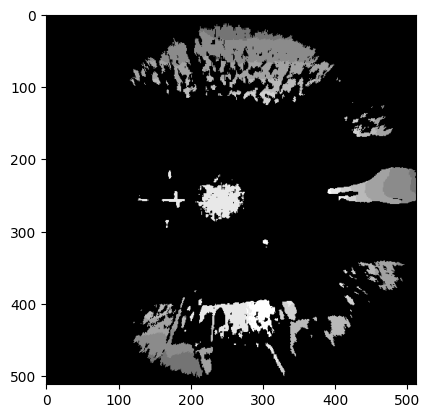

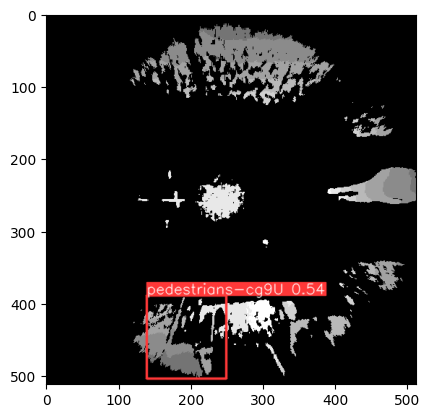


0: 640x640 (no detections), 10.1ms
Speed: 3.1ms preprocess, 10.1ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


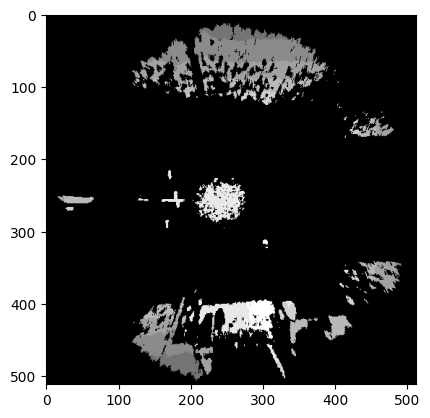


0: 640x640 1 pedestrians-cg9U, 12.0ms
Speed: 5.0ms preprocess, 12.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


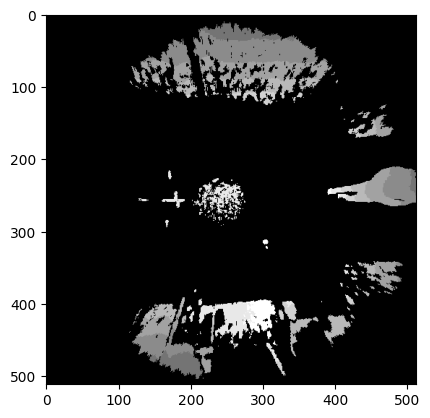

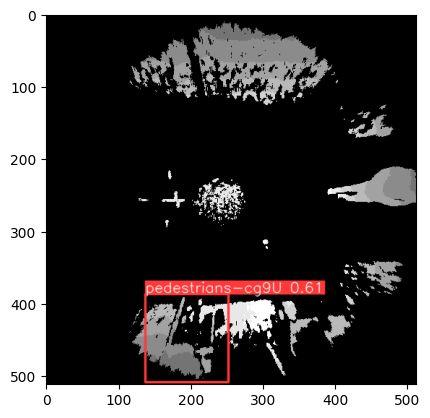


0: 640x640 (no detections), 11.1ms
Speed: 3.8ms preprocess, 11.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


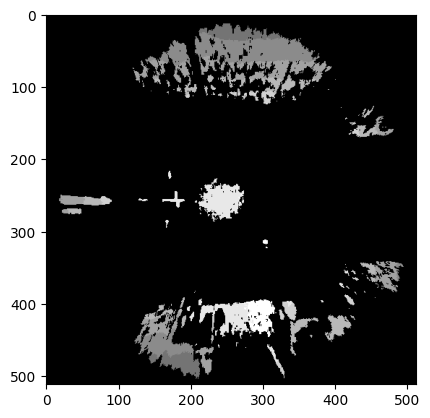


0: 640x640 1 pedestrians-cg9U, 9.9ms
Speed: 5.5ms preprocess, 9.9ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


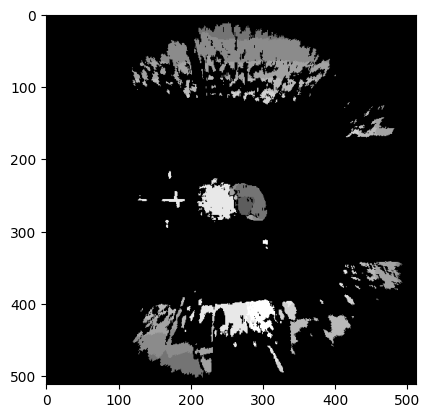

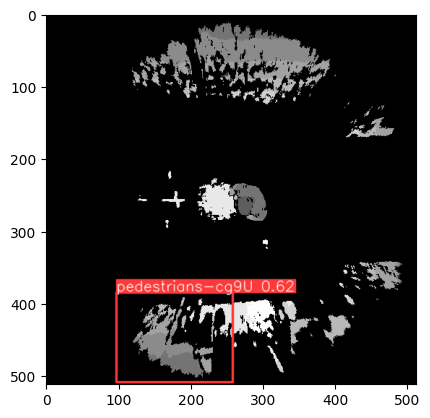


0: 640x640 (no detections), 12.3ms
Speed: 4.5ms preprocess, 12.3ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)


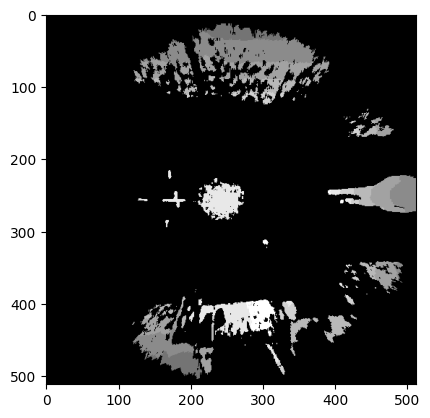


0: 640x640 (no detections), 10.7ms
Speed: 3.3ms preprocess, 10.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


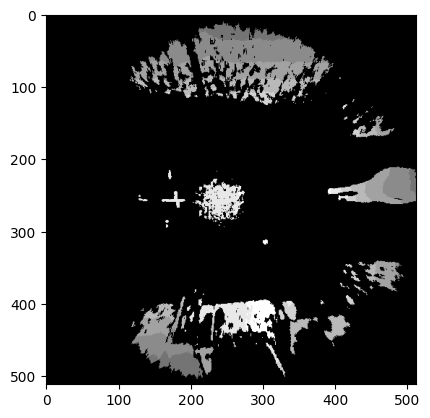


0: 640x640 (no detections), 11.8ms
Speed: 3.3ms preprocess, 11.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


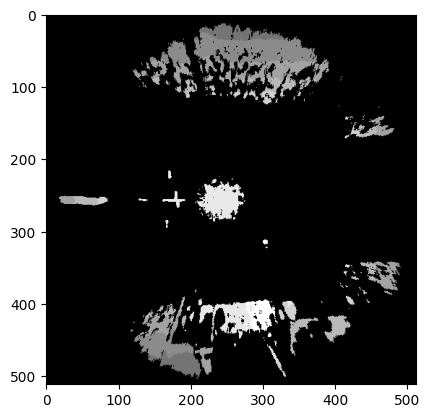


0: 640x640 (no detections), 8.5ms
Speed: 3.3ms preprocess, 8.5ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


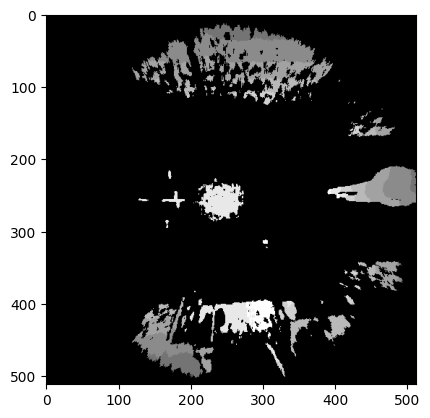


0: 640x640 1 pedestrians-cg9U, 10.9ms
Speed: 5.3ms preprocess, 10.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


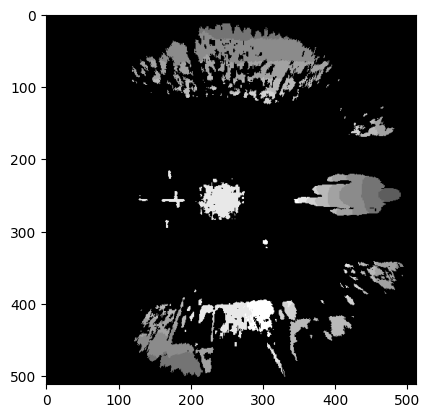

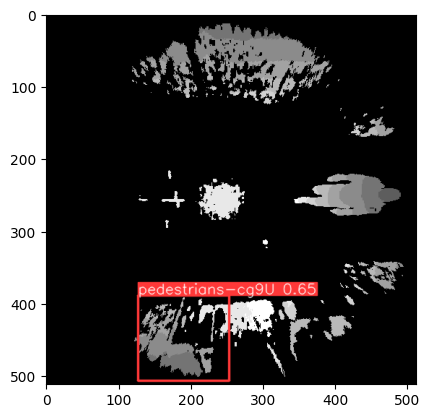


0: 640x640 1 pedestrians-cg9U, 10.9ms
Speed: 3.3ms preprocess, 10.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


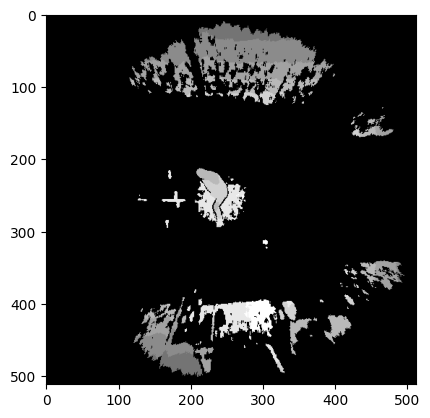

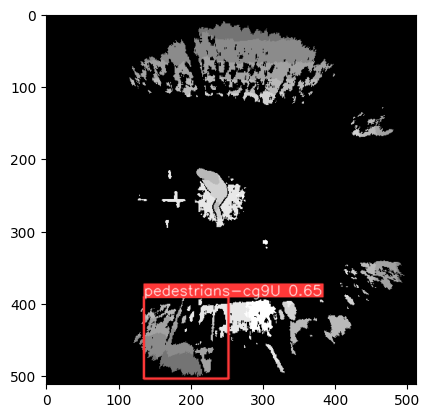


0: 640x640 1 pedestrians-cg9U, 18.2ms
Speed: 3.3ms preprocess, 18.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


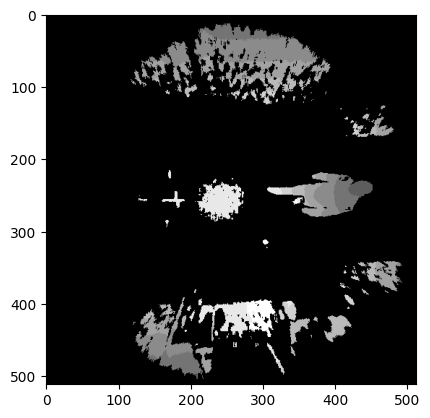

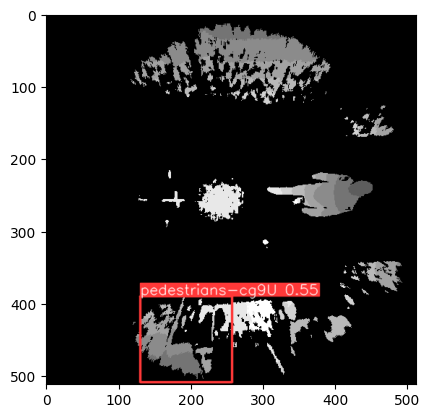


0: 640x640 (no detections), 14.1ms
Speed: 3.3ms preprocess, 14.1ms inference, 5.4ms postprocess per image at shape (1, 3, 640, 640)


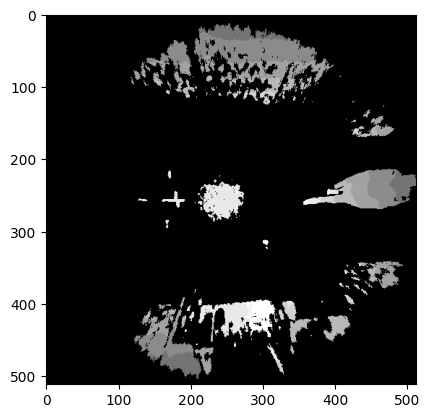


0: 640x640 1 pedestrians-cg9U, 18.4ms
Speed: 3.2ms preprocess, 18.4ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


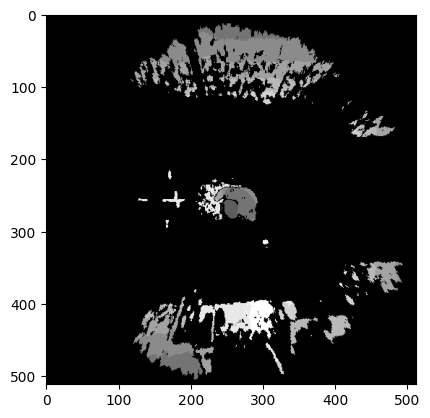

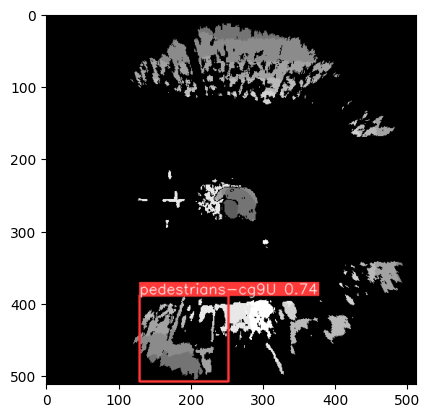


0: 640x640 (no detections), 10.8ms
Speed: 3.7ms preprocess, 10.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


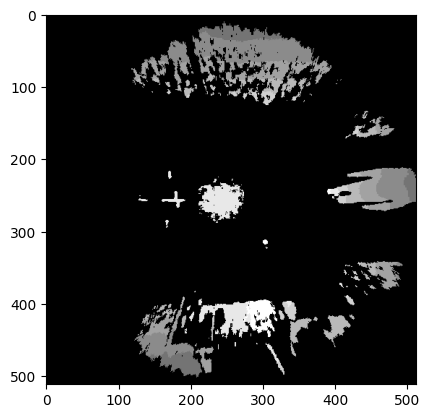


0: 640x640 (no detections), 12.7ms
Speed: 3.5ms preprocess, 12.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


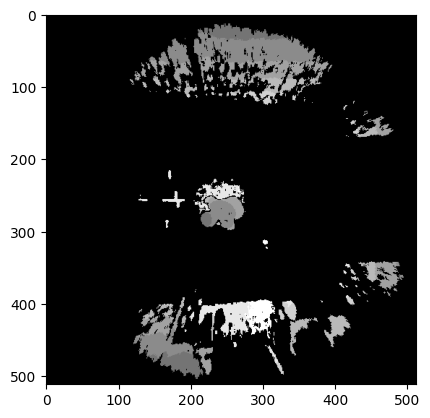


0: 640x640 1 pedestrians-cg9U, 13.4ms
Speed: 3.4ms preprocess, 13.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


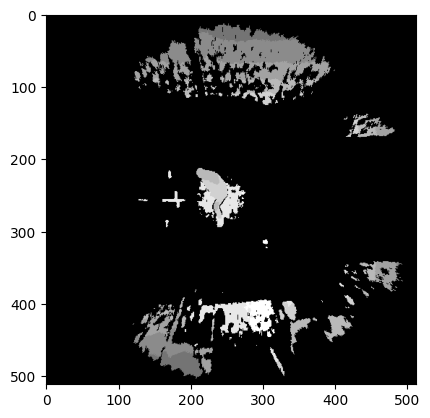

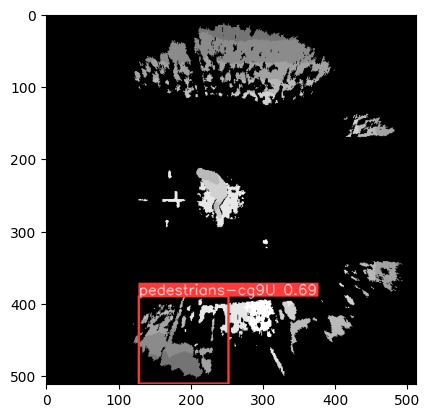


0: 640x640 1 pedestrians-cg9U, 13.6ms
Speed: 3.3ms preprocess, 13.6ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


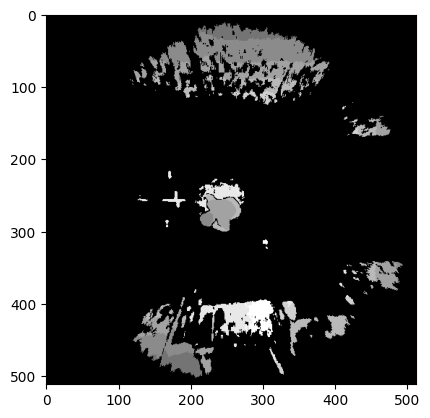

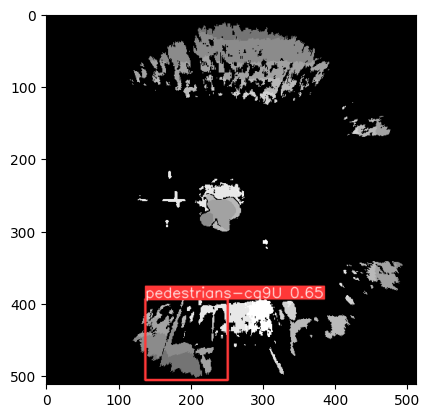


0: 640x640 (no detections), 8.8ms
Speed: 5.0ms preprocess, 8.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


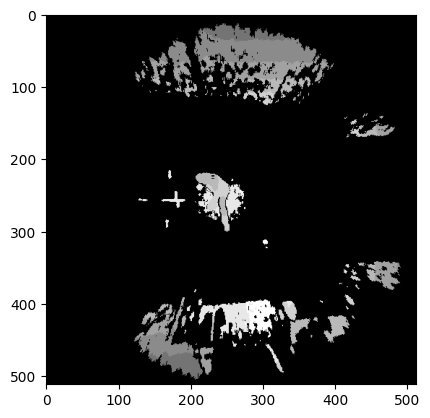


0: 640x640 (no detections), 10.0ms
Speed: 3.4ms preprocess, 10.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


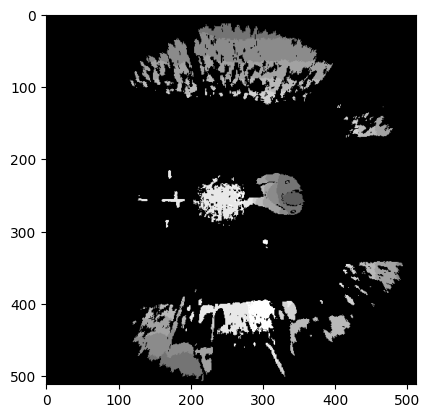


0: 640x640 (no detections), 10.0ms
Speed: 3.3ms preprocess, 10.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


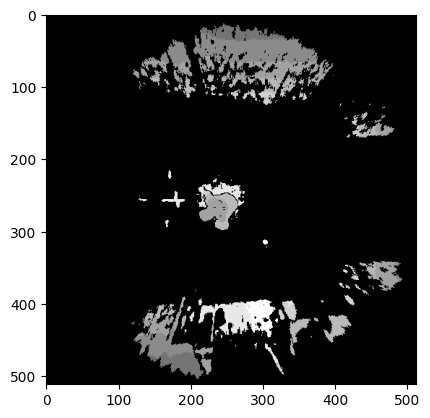


0: 640x640 (no detections), 9.1ms
Speed: 3.3ms preprocess, 9.1ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


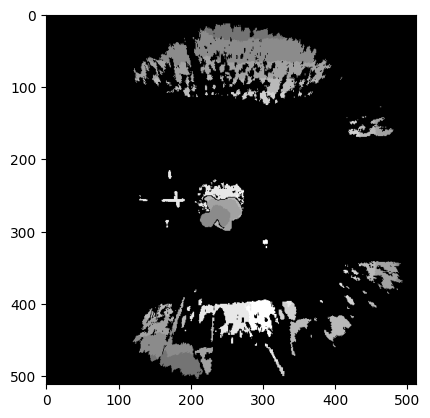


0: 640x640 (no detections), 9.1ms
Speed: 3.3ms preprocess, 9.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


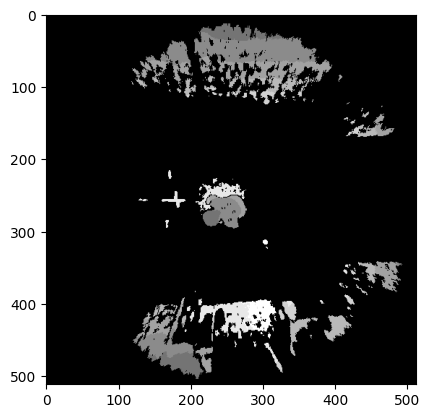


0: 640x640 1 pedestrians-cg9U, 10.2ms
Speed: 3.2ms preprocess, 10.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


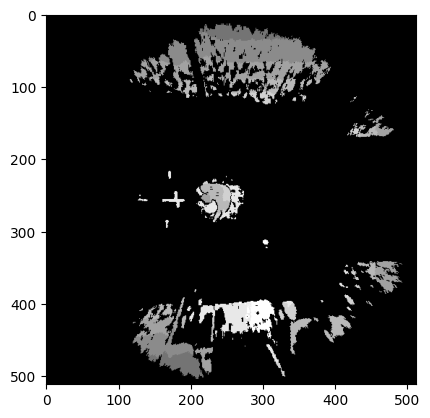

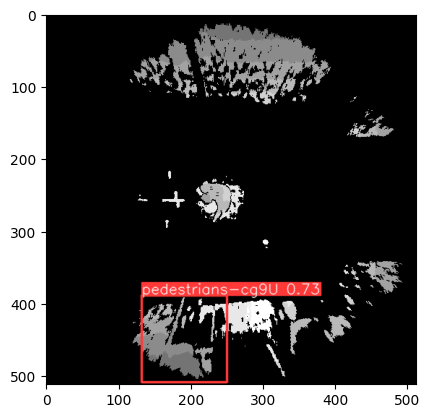


0: 640x640 (no detections), 9.5ms
Speed: 3.3ms preprocess, 9.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


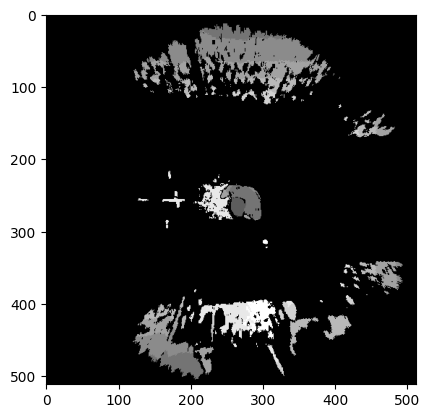


0: 640x640 1 pedestrians-cg9U, 8.5ms
Speed: 3.1ms preprocess, 8.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


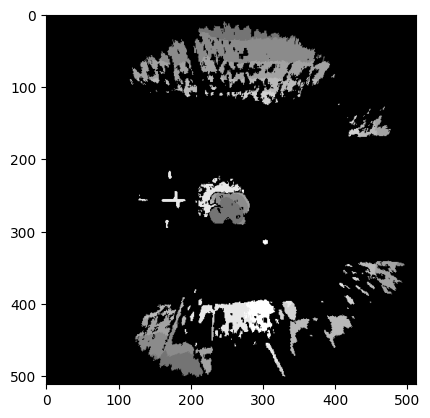

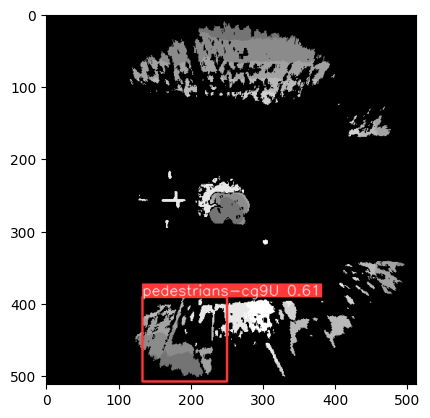


0: 640x640 (no detections), 9.0ms
Speed: 3.3ms preprocess, 9.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


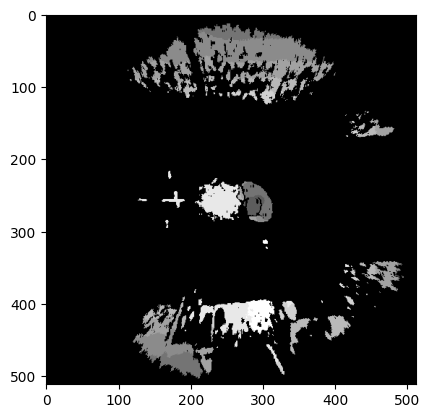


0: 640x640 1 pedestrians-cg9U, 11.0ms
Speed: 3.3ms preprocess, 11.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


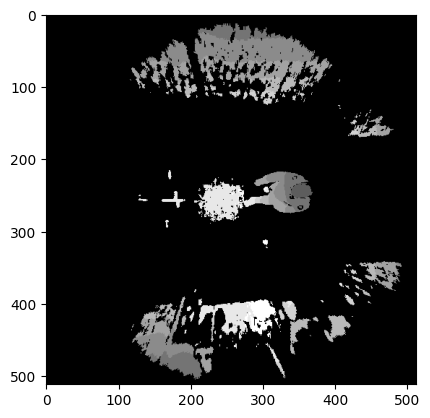

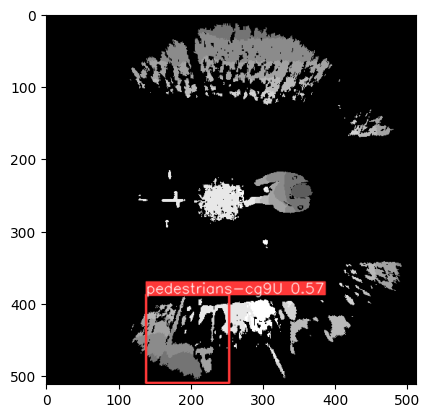


0: 640x640 1 pedestrians-cg9U, 8.9ms
Speed: 3.2ms preprocess, 8.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


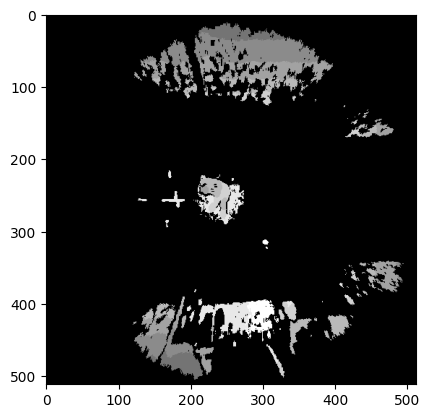

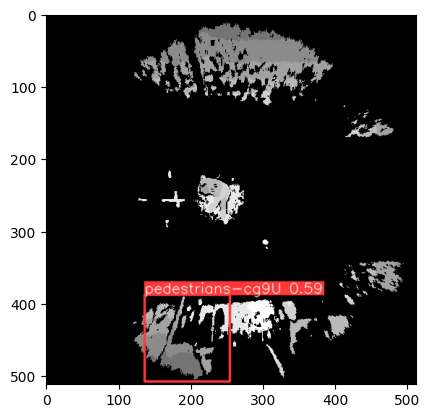


0: 640x640 1 pedestrians-cg9U, 9.6ms
Speed: 3.5ms preprocess, 9.6ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


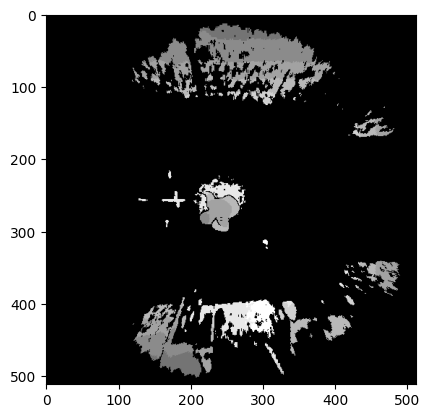

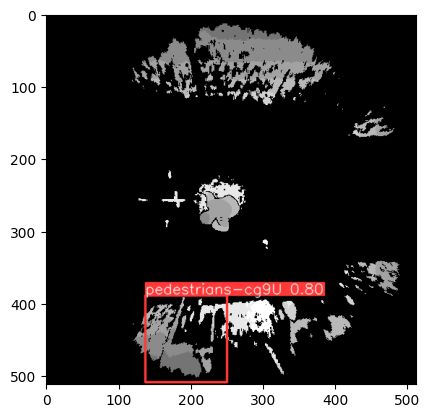


0: 640x640 1 pedestrians-cg9U, 10.1ms
Speed: 3.5ms preprocess, 10.1ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


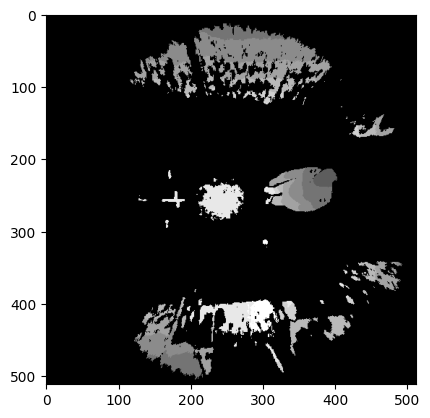

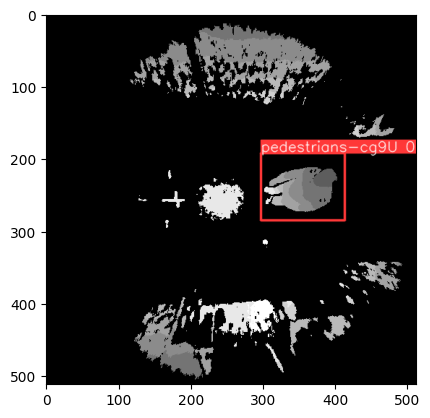


0: 640x640 1 pedestrians-cg9U, 14.3ms
Speed: 3.3ms preprocess, 14.3ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


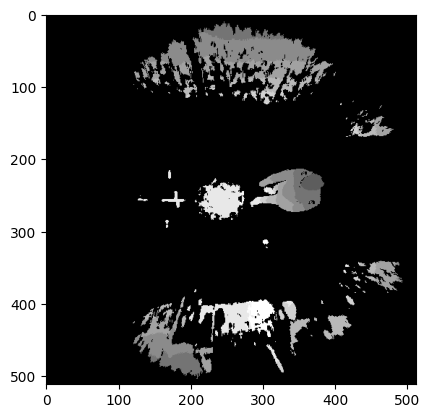

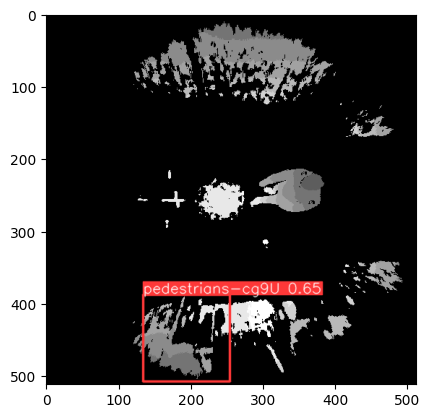


0: 640x640 1 pedestrians-cg9U, 14.1ms
Speed: 3.3ms preprocess, 14.1ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


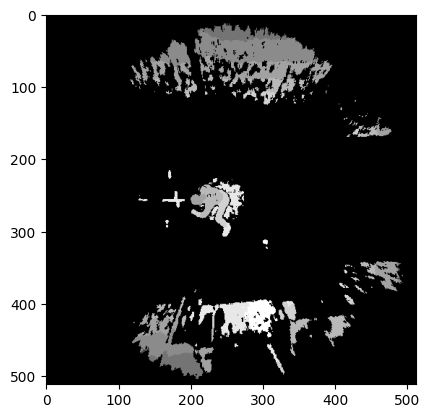

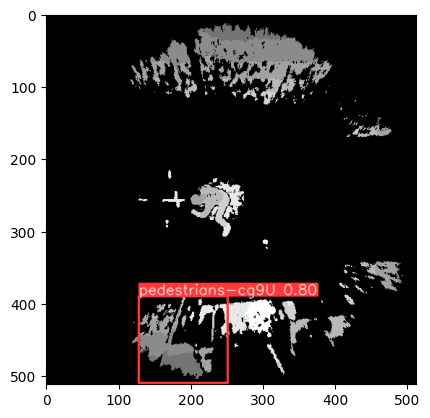


0: 640x640 (no detections), 13.7ms
Speed: 3.2ms preprocess, 13.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


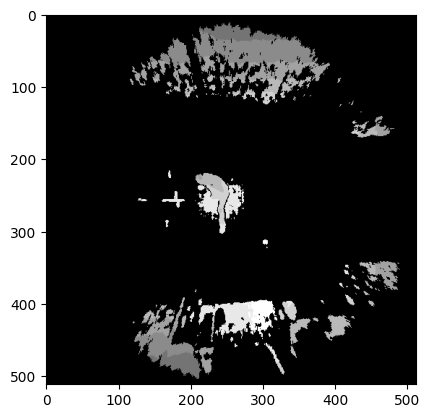


0: 640x640 1 pedestrians-cg9U, 11.7ms
Speed: 7.1ms preprocess, 11.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


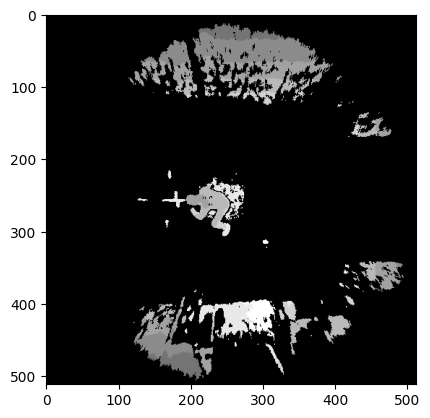

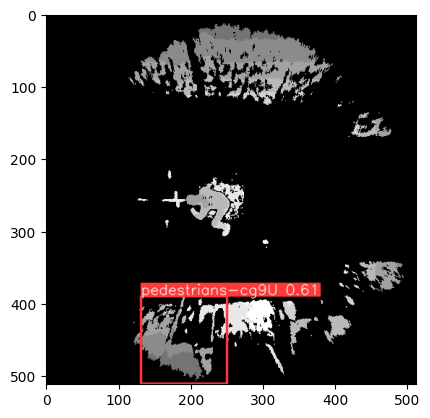


0: 640x640 1 pedestrians-cg9U, 9.2ms
Speed: 3.4ms preprocess, 9.2ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


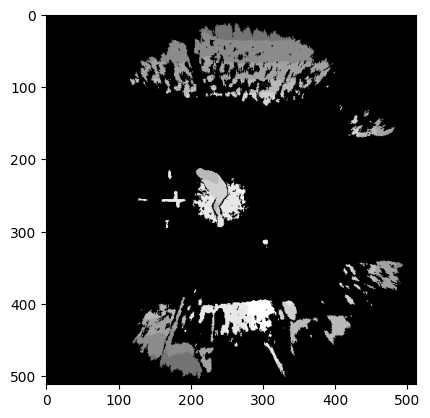

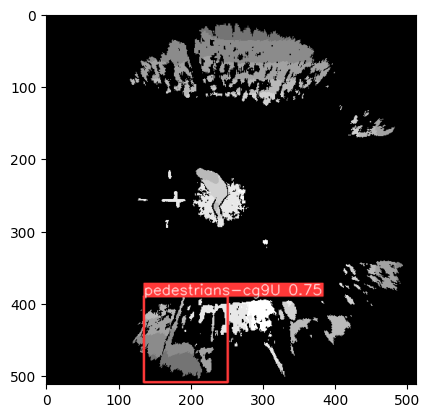


0: 640x640 1 pedestrians-cg9U, 10.9ms
Speed: 3.5ms preprocess, 10.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


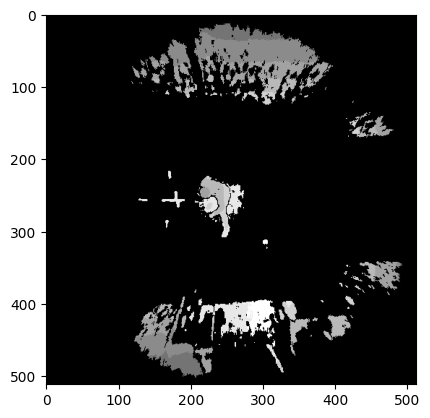

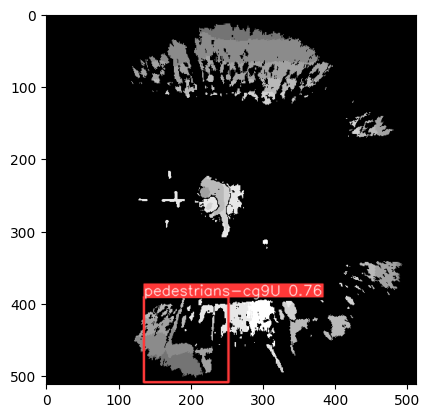


0: 640x640 1 pedestrians-cg9U, 10.4ms
Speed: 3.6ms preprocess, 10.4ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


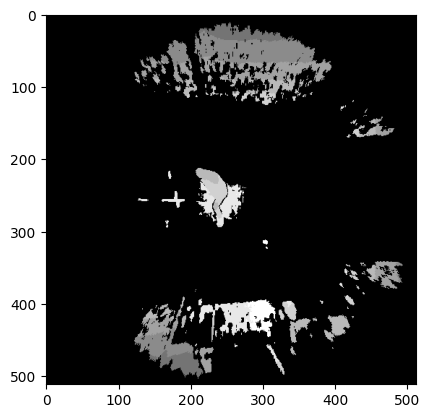

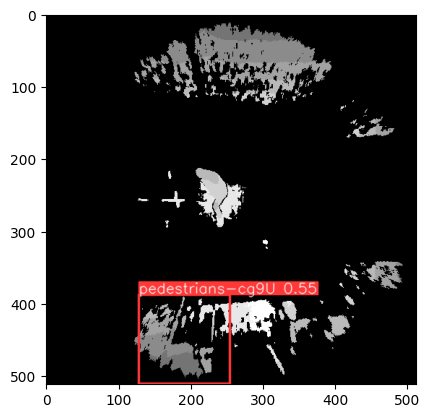


0: 640x640 (no detections), 13.7ms
Speed: 3.3ms preprocess, 13.7ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


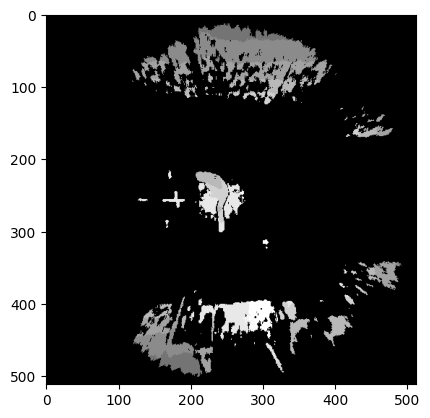


0: 640x640 1 pedestrians-cg9U, 11.4ms
Speed: 3.5ms preprocess, 11.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


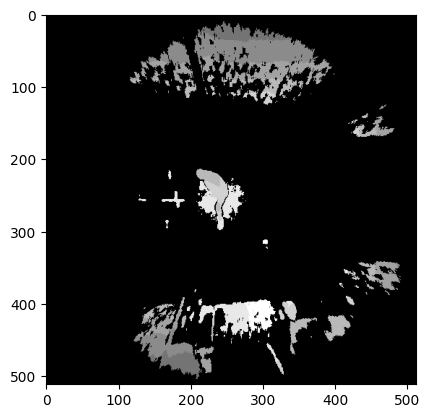

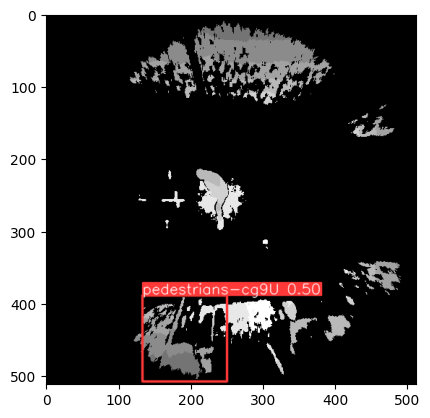


0: 640x640 1 pedestrians-cg9U, 10.8ms
Speed: 3.3ms preprocess, 10.8ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


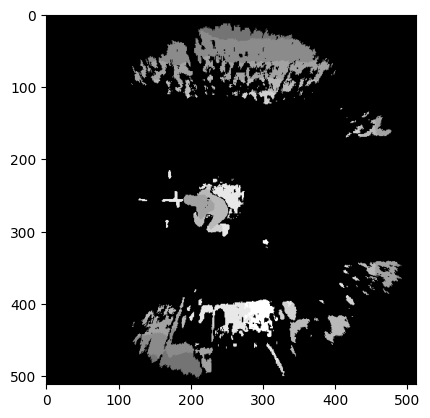

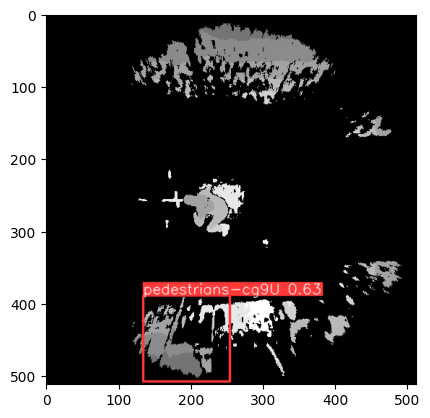


0: 640x640 1 pedestrians-cg9U, 13.8ms
Speed: 3.6ms preprocess, 13.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


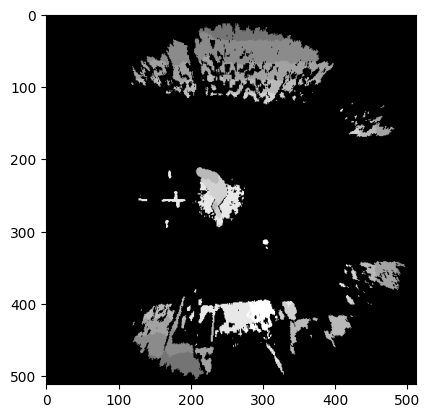

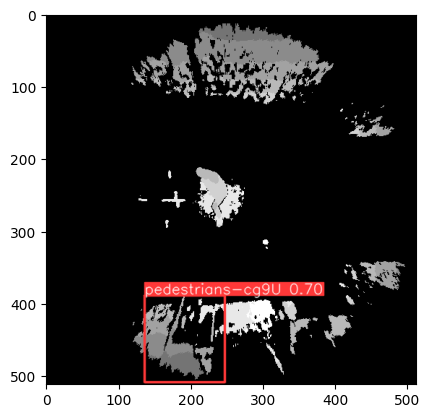


0: 640x640 (no detections), 10.4ms
Speed: 3.4ms preprocess, 10.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


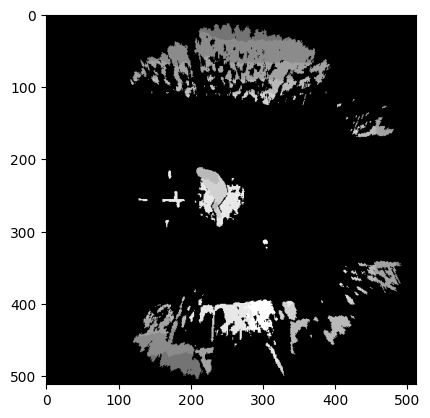


0: 640x640 1 pedestrians-cg9U, 11.2ms
Speed: 5.3ms preprocess, 11.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


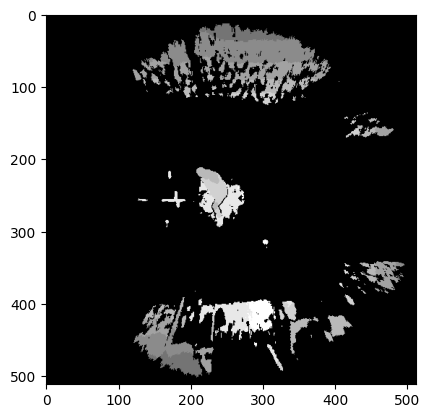

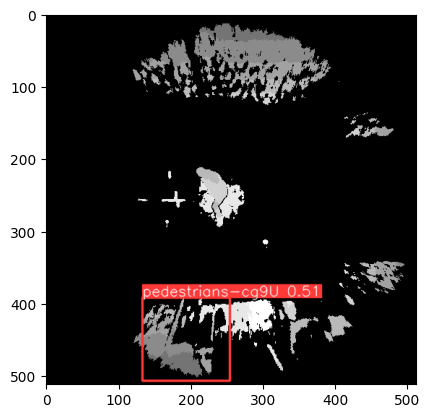


0: 640x640 (no detections), 9.8ms
Speed: 3.4ms preprocess, 9.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


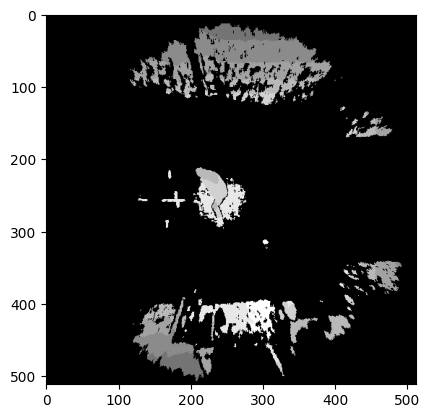


0: 640x640 1 pedestrians-cg9U, 8.9ms
Speed: 3.2ms preprocess, 8.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


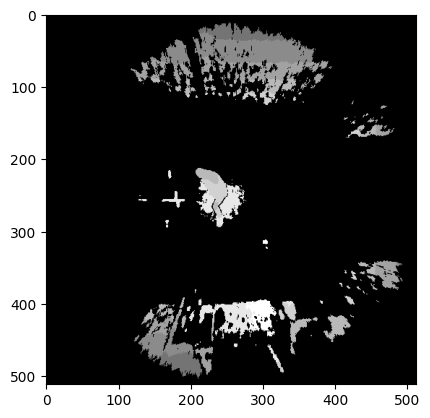

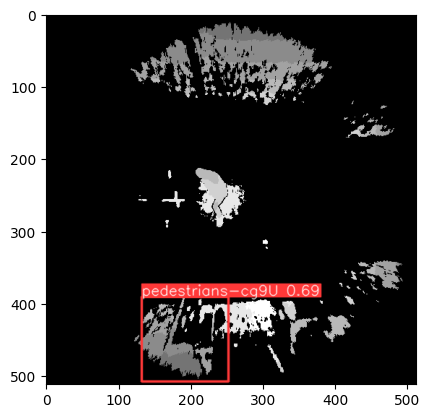


0: 640x640 1 pedestrians-cg9U, 8.6ms
Speed: 3.1ms preprocess, 8.6ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


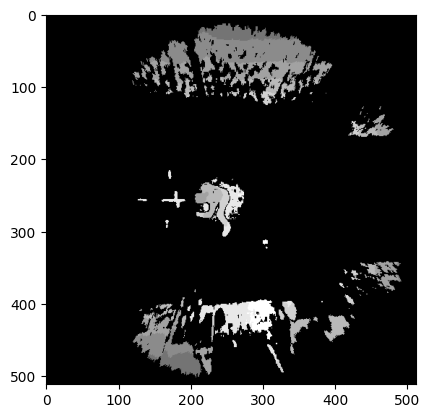

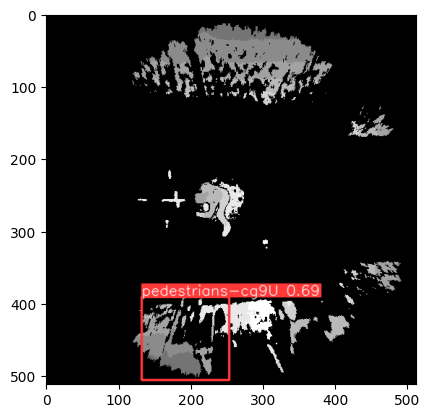


0: 640x640 (no detections), 9.2ms
Speed: 3.7ms preprocess, 9.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


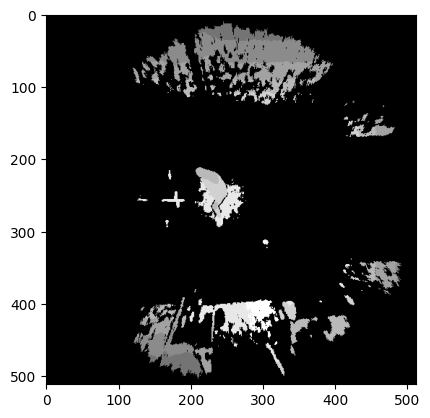


0: 640x640 (no detections), 11.9ms
Speed: 3.6ms preprocess, 11.9ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


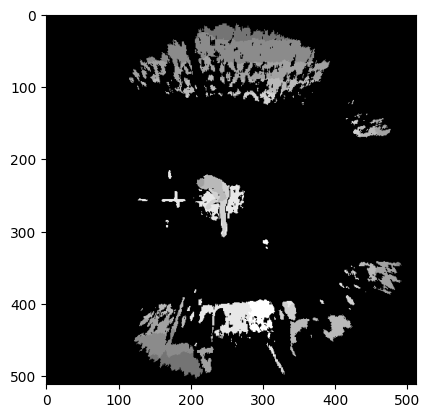


0: 640x640 (no detections), 10.4ms
Speed: 3.5ms preprocess, 10.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


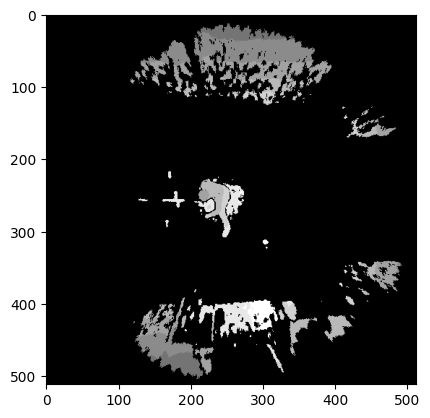


0: 640x640 (no detections), 9.6ms
Speed: 3.6ms preprocess, 9.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


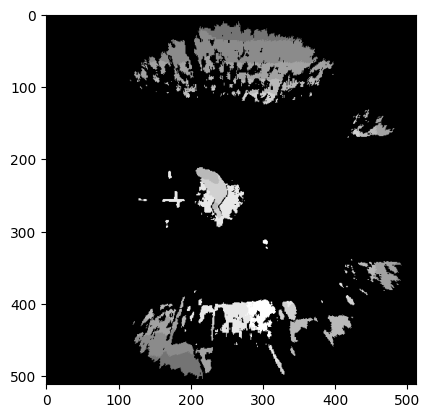


0: 640x640 1 pedestrians-cg9U, 8.6ms
Speed: 3.3ms preprocess, 8.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


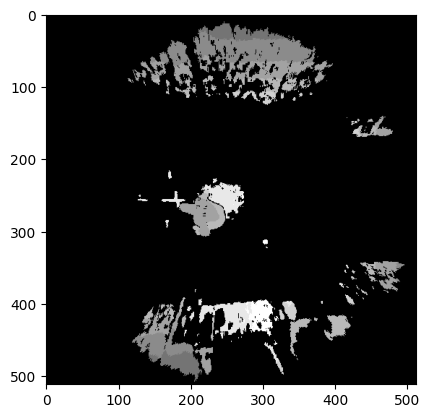

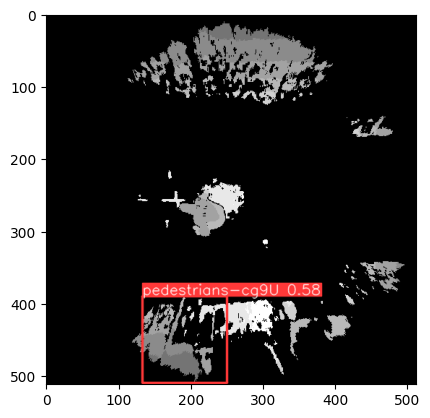


0: 640x640 (no detections), 10.4ms
Speed: 3.2ms preprocess, 10.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


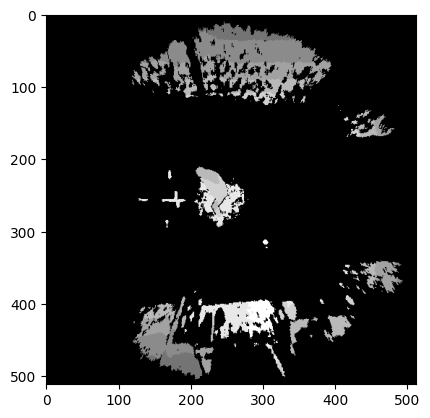


0: 640x640 1 pedestrians-cg9U, 10.0ms
Speed: 3.5ms preprocess, 10.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


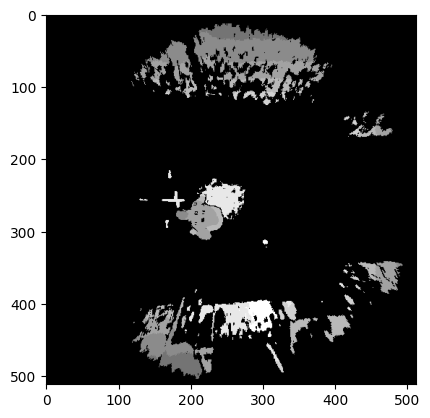

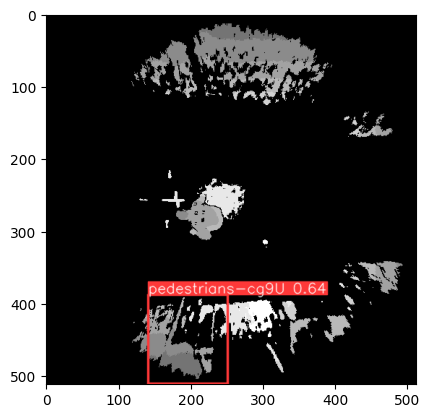


0: 640x640 1 pedestrians-cg9U, 11.2ms
Speed: 5.3ms preprocess, 11.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


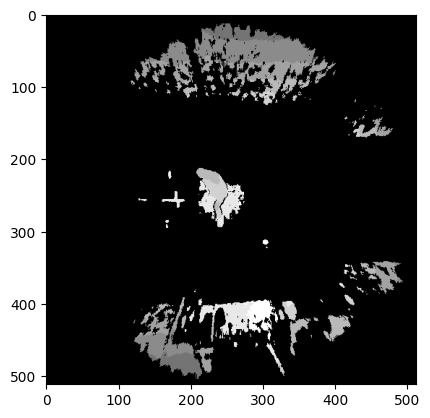

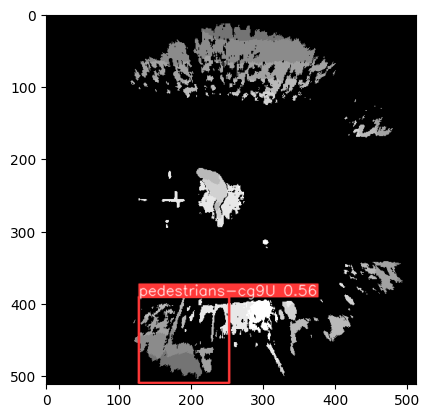


0: 640x640 1 pedestrians-cg9U, 10.1ms
Speed: 3.3ms preprocess, 10.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


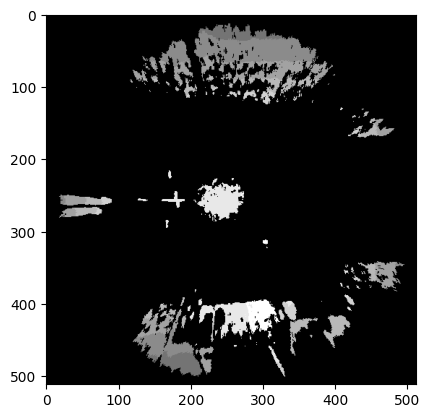

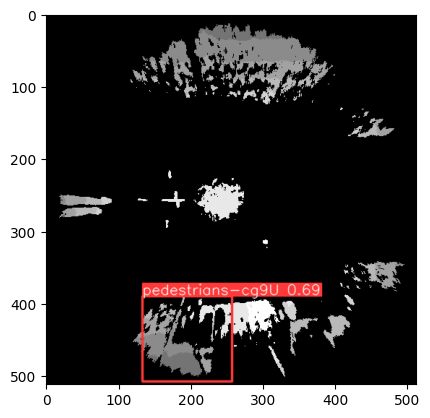


0: 640x640 (no detections), 11.0ms
Speed: 3.3ms preprocess, 11.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


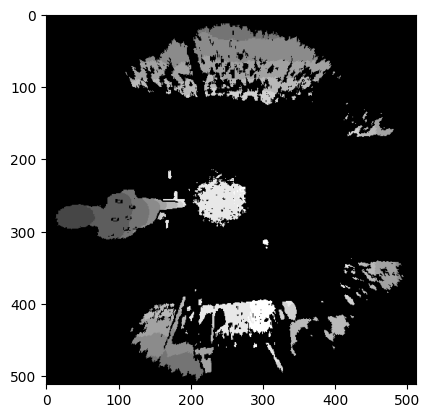


0: 640x640 1 pedestrians-cg9U, 11.3ms
Speed: 3.5ms preprocess, 11.3ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


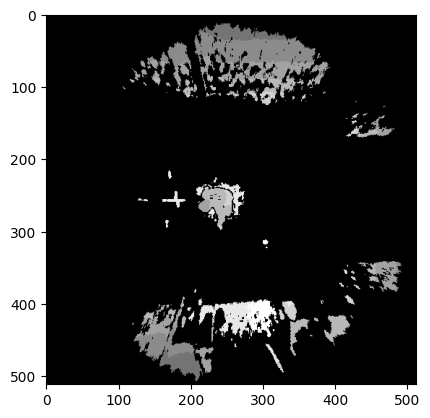

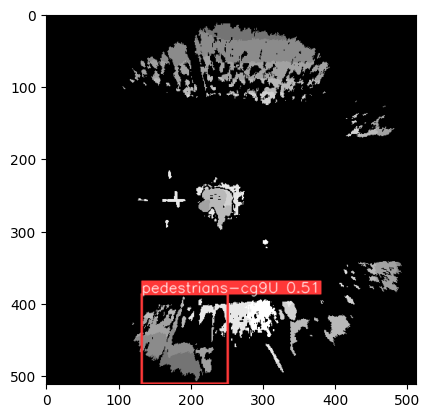


0: 640x640 1 pedestrians-cg9U, 17.4ms
Speed: 3.4ms preprocess, 17.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


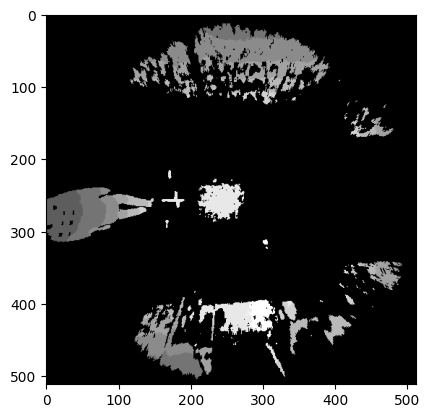

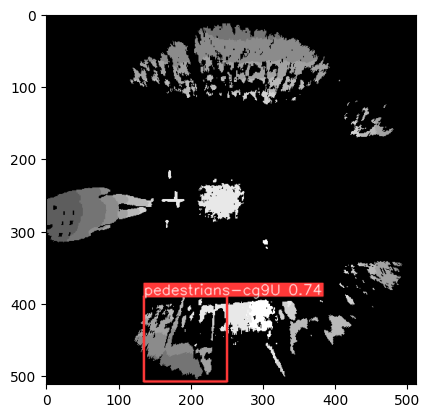


0: 640x640 1 pedestrians-cg9U, 19.1ms
Speed: 5.6ms preprocess, 19.1ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


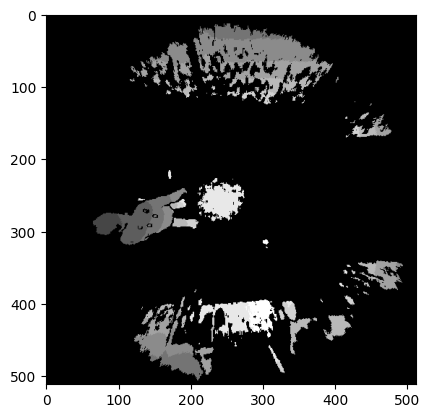

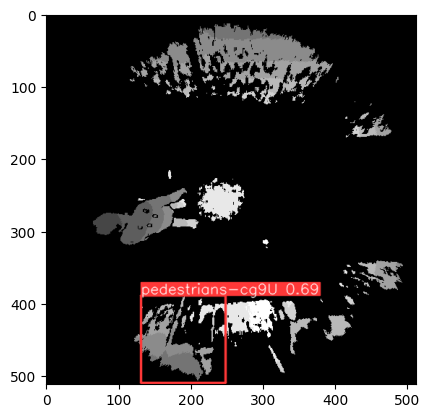


0: 640x640 2 pedestrians-cg9Us, 17.4ms
Speed: 3.2ms preprocess, 17.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


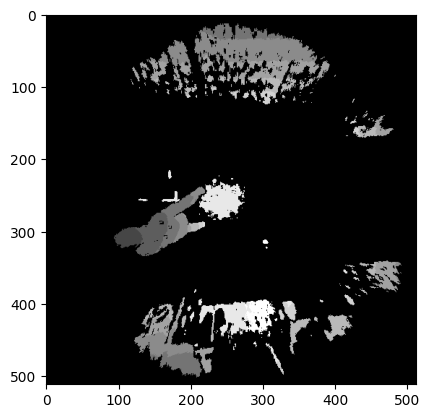

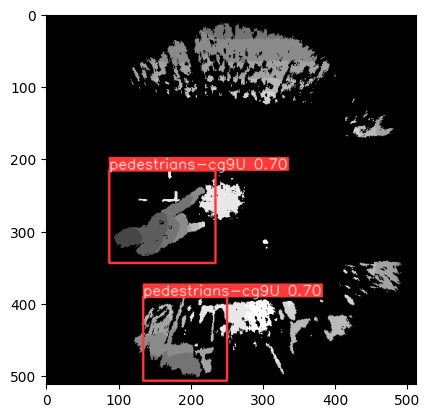


0: 640x640 (no detections), 9.3ms
Speed: 5.6ms preprocess, 9.3ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


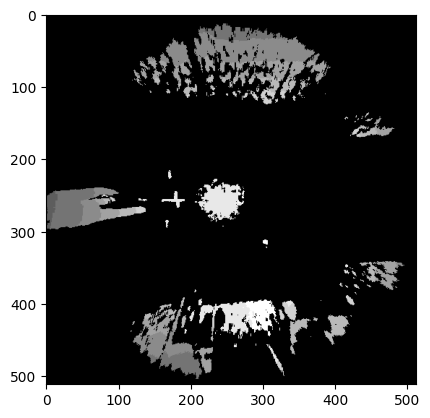


0: 640x640 1 pedestrians-cg9U, 13.3ms
Speed: 4.5ms preprocess, 13.3ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


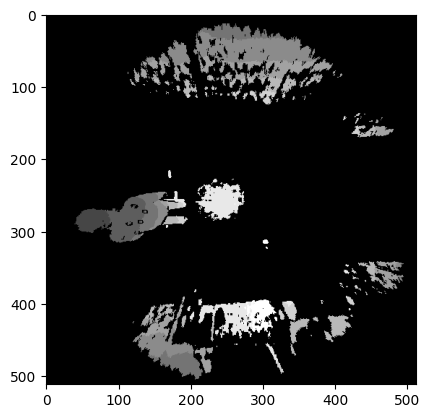

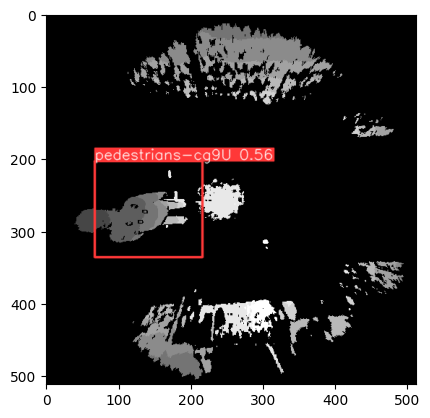


0: 640x640 1 pedestrians-cg9U, 10.5ms
Speed: 3.3ms preprocess, 10.5ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


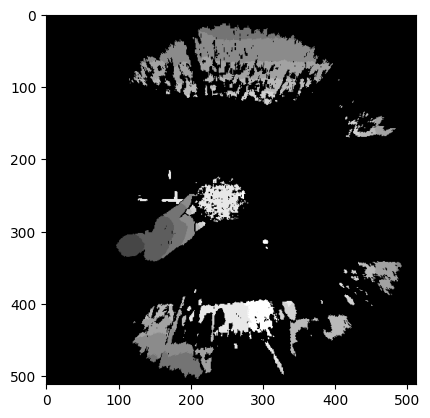

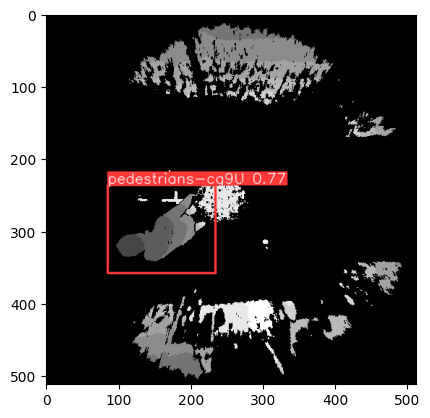


0: 640x640 1 pedestrians-cg9U, 10.5ms
Speed: 3.3ms preprocess, 10.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


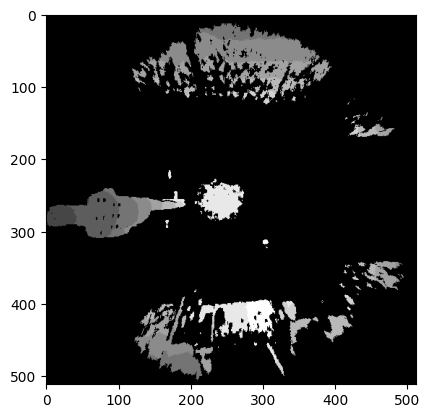

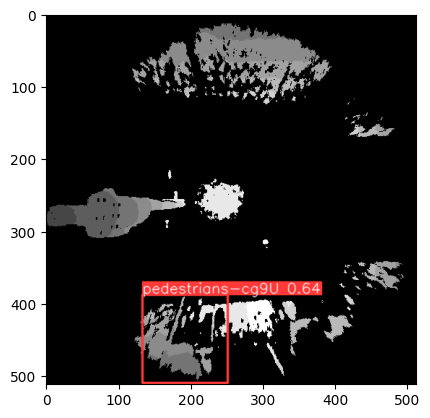


0: 640x640 1 pedestrians-cg9U, 14.4ms
Speed: 3.2ms preprocess, 14.4ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


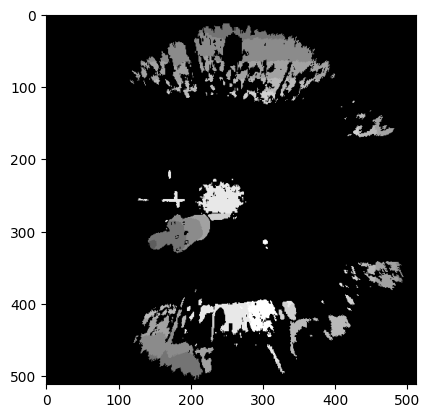

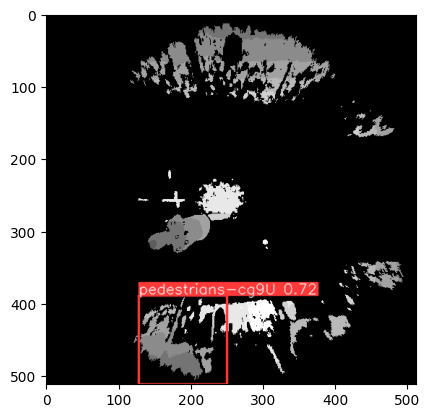


0: 640x640 1 pedestrians-cg9U, 11.1ms
Speed: 3.3ms preprocess, 11.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


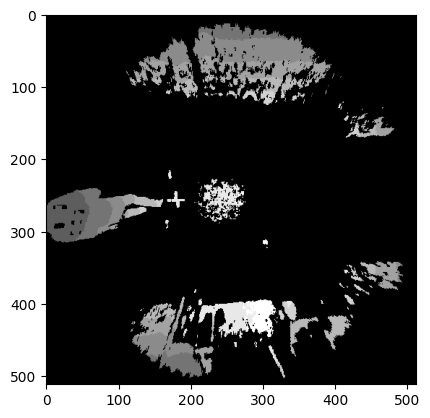

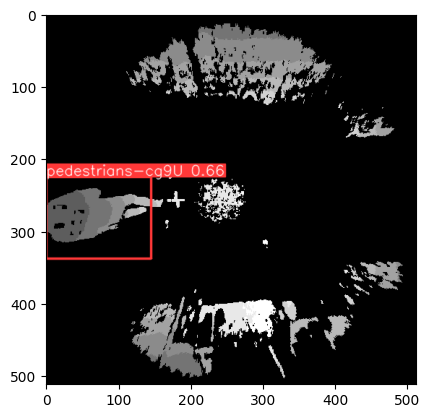


0: 640x640 1 pedestrians-cg9U, 12.2ms
Speed: 3.6ms preprocess, 12.2ms inference, 3.5ms postprocess per image at shape (1, 3, 640, 640)


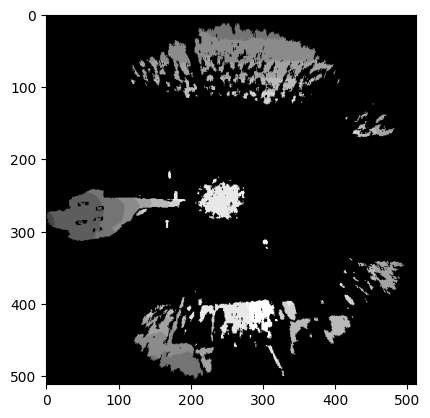

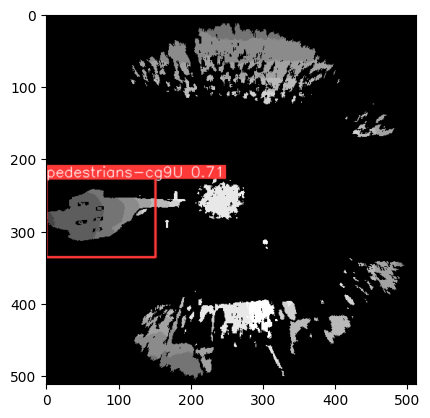


0: 640x640 (no detections), 15.5ms
Speed: 3.5ms preprocess, 15.5ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


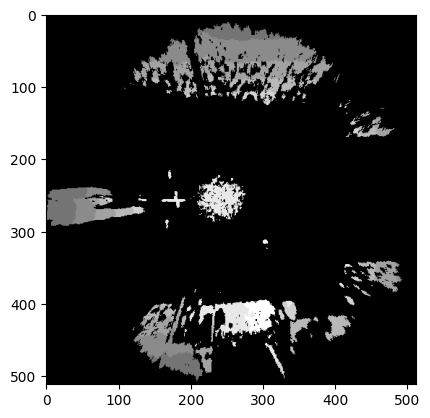


0: 640x640 2 pedestrians-cg9Us, 8.5ms
Speed: 3.6ms preprocess, 8.5ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


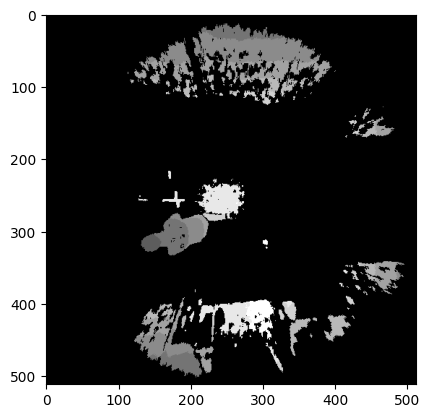

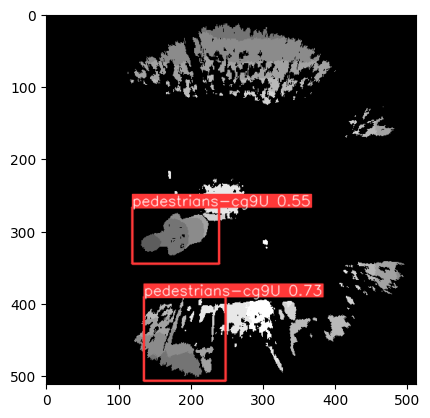


0: 640x640 1 pedestrians-cg9U, 9.6ms
Speed: 3.5ms preprocess, 9.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


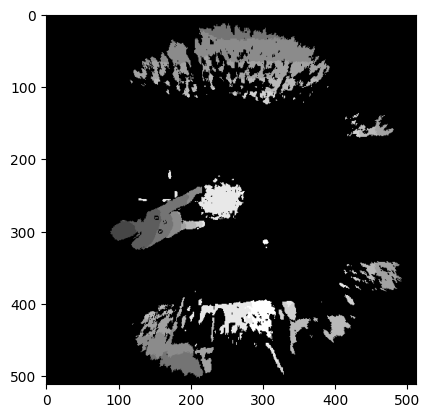

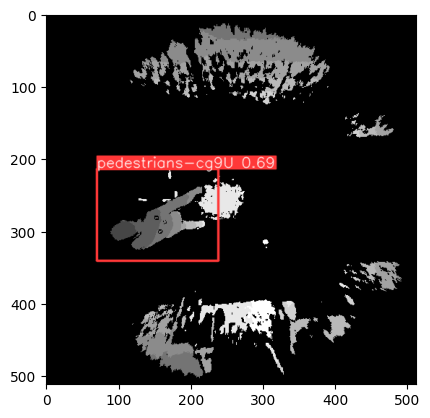


0: 640x640 (no detections), 9.2ms
Speed: 3.6ms preprocess, 9.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


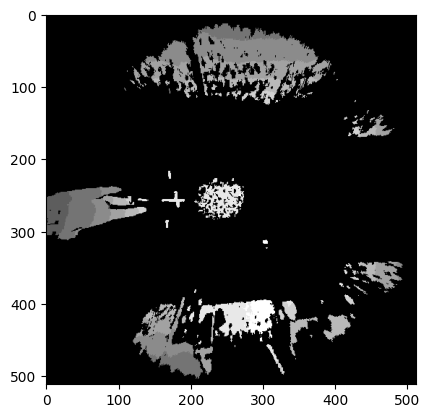


0: 640x640 1 pedestrians-cg9U, 9.0ms
Speed: 3.6ms preprocess, 9.0ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


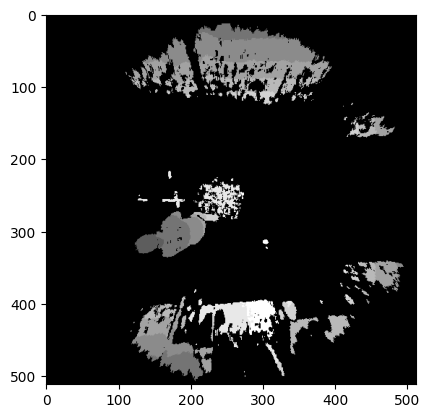

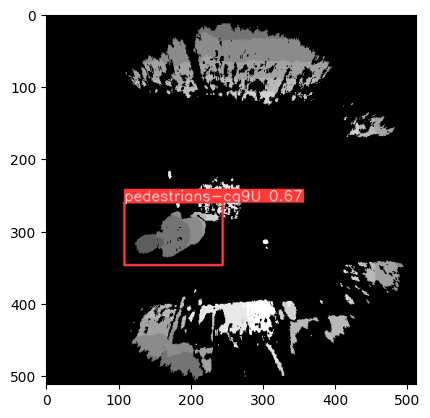


0: 640x640 (no detections), 8.5ms
Speed: 3.4ms preprocess, 8.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


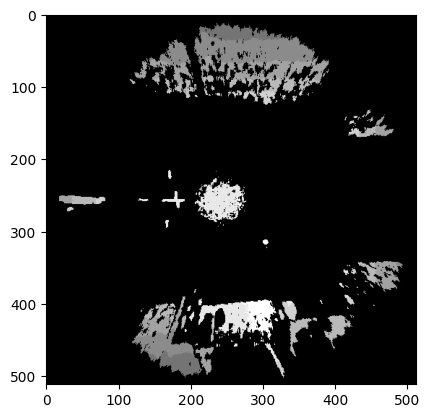


0: 640x640 (no detections), 9.0ms
Speed: 3.5ms preprocess, 9.0ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


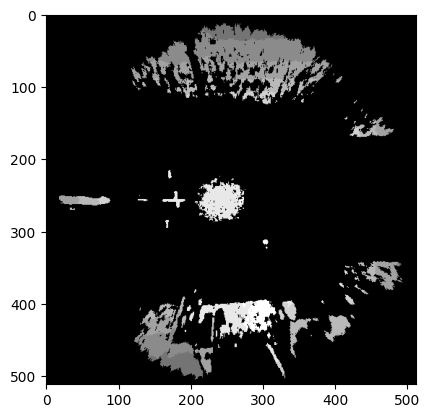


0: 640x640 (no detections), 9.2ms
Speed: 4.3ms preprocess, 9.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


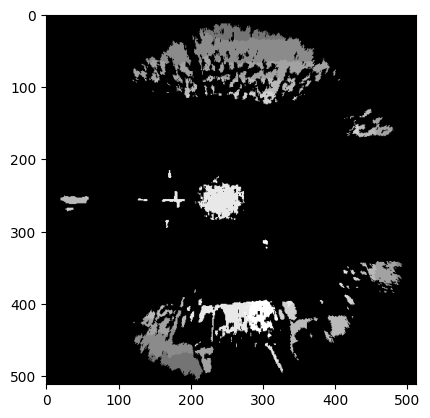


0: 640x640 (no detections), 10.3ms
Speed: 3.3ms preprocess, 10.3ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


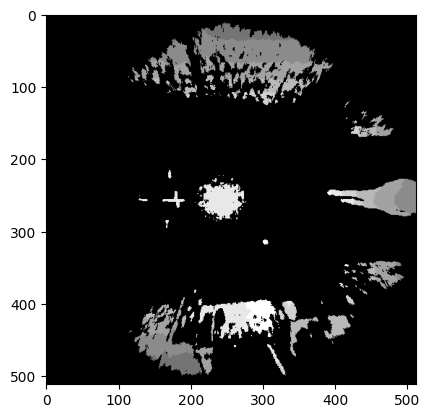


0: 640x640 1 pedestrians-cg9U, 9.1ms
Speed: 3.8ms preprocess, 9.1ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


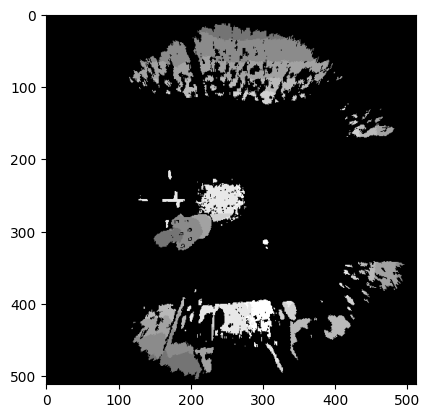

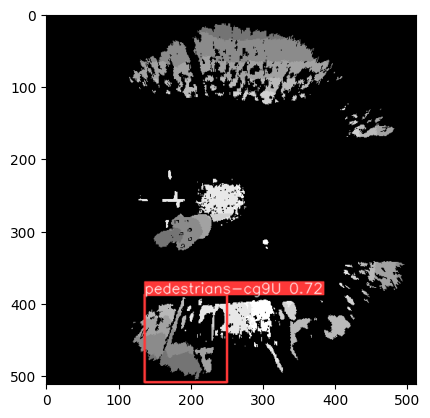


0: 640x640 1 pedestrians-cg9U, 8.7ms
Speed: 6.2ms preprocess, 8.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


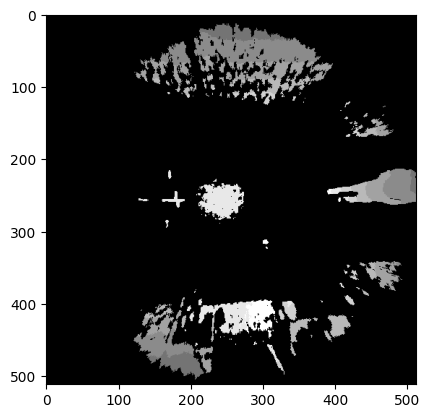

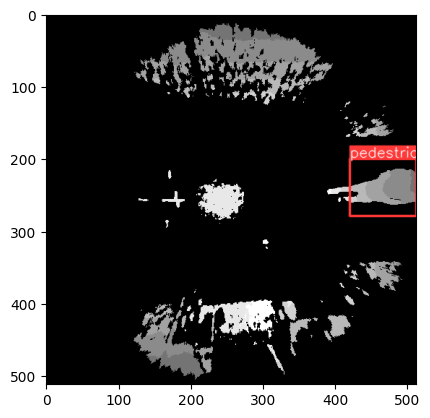


0: 640x640 (no detections), 15.4ms
Speed: 3.5ms preprocess, 15.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


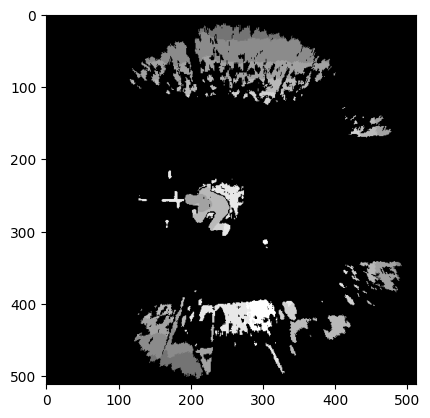


0: 640x640 (no detections), 9.2ms
Speed: 4.0ms preprocess, 9.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


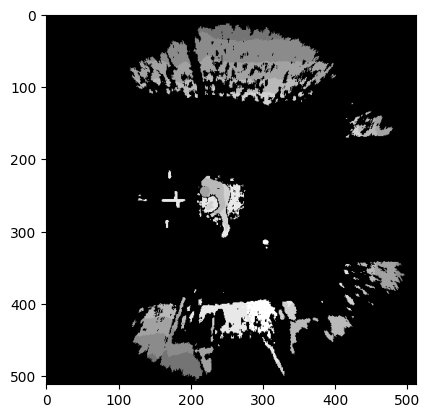


0: 640x640 1 pedestrians-cg9U, 8.5ms
Speed: 5.5ms preprocess, 8.5ms inference, 4.1ms postprocess per image at shape (1, 3, 640, 640)


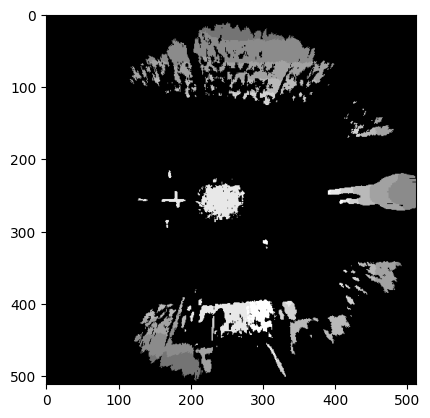

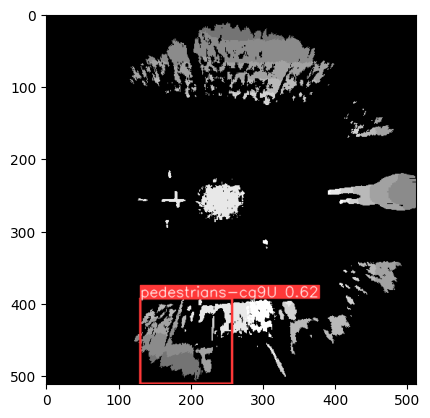


0: 640x640 (no detections), 10.4ms
Speed: 3.3ms preprocess, 10.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


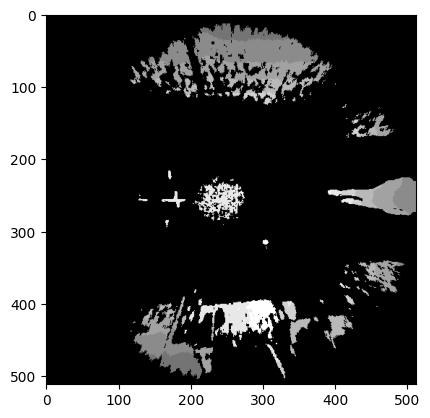


0: 640x640 (no detections), 10.8ms
Speed: 3.2ms preprocess, 10.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


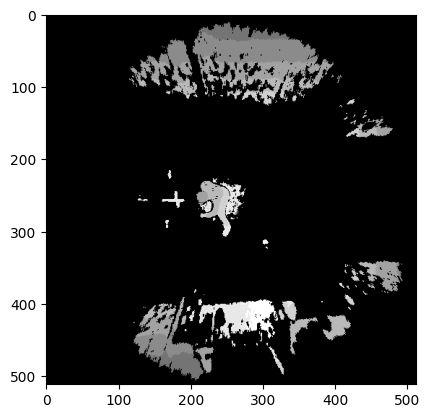


0: 640x640 (no detections), 12.2ms
Speed: 6.9ms preprocess, 12.2ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


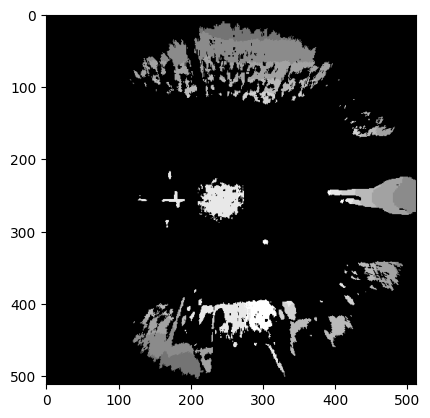


0: 640x640 (no detections), 11.4ms
Speed: 3.5ms preprocess, 11.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


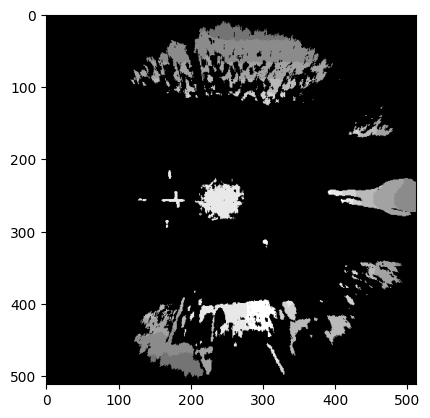


0: 640x640 2 pedestrians-cg9Us, 10.6ms
Speed: 3.3ms preprocess, 10.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


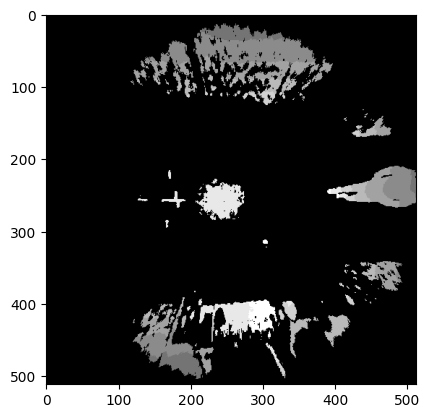

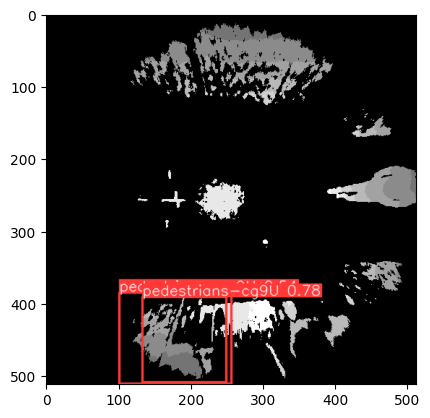


0: 640x640 (no detections), 10.6ms
Speed: 3.5ms preprocess, 10.6ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


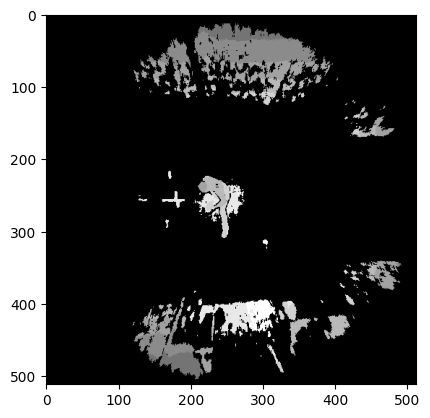


0: 640x640 (no detections), 8.3ms
Speed: 5.5ms preprocess, 8.3ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


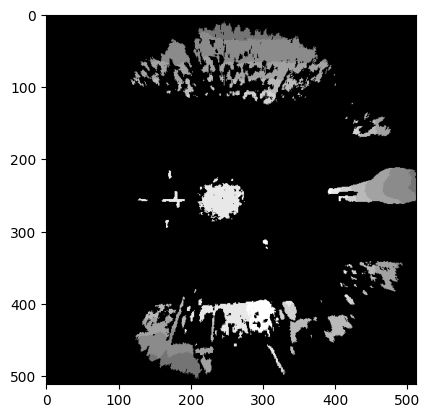


0: 640x640 (no detections), 14.8ms
Speed: 3.5ms preprocess, 14.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


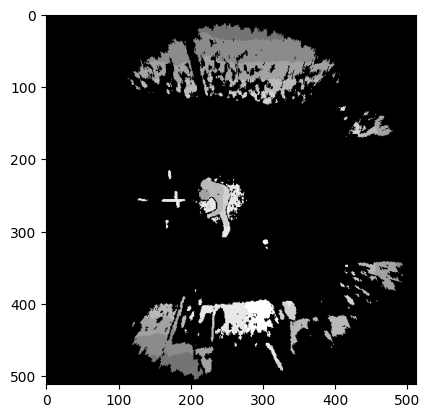


0: 640x640 (no detections), 10.6ms
Speed: 3.3ms preprocess, 10.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


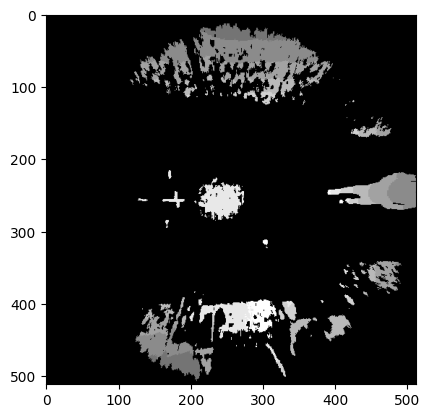


0: 640x640 (no detections), 9.9ms
Speed: 3.2ms preprocess, 9.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


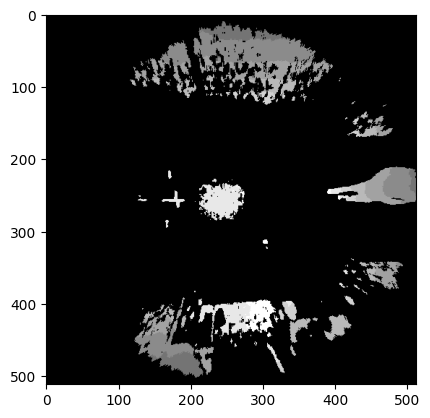


0: 640x640 (no detections), 11.8ms
Speed: 3.5ms preprocess, 11.8ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


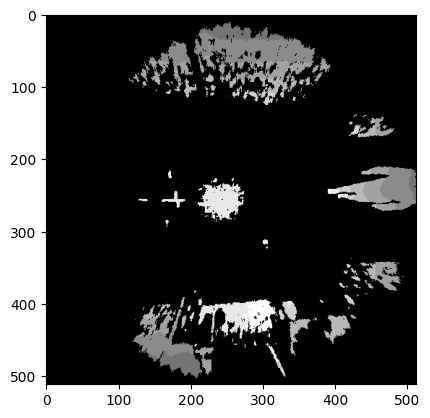


0: 640x640 (no detections), 10.7ms
Speed: 3.6ms preprocess, 10.7ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


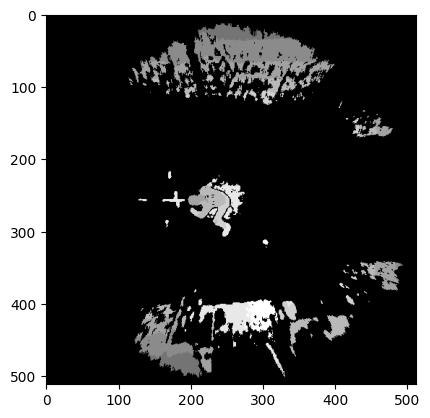


0: 640x640 1 pedestrians-cg9U, 9.7ms
Speed: 3.3ms preprocess, 9.7ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


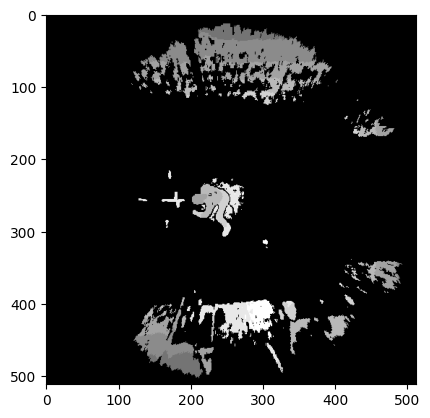

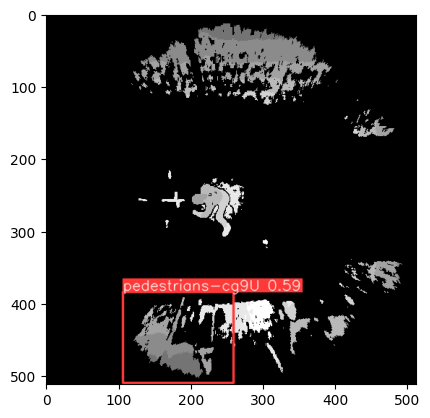


0: 640x640 1 pedestrians-cg9U, 10.6ms
Speed: 3.4ms preprocess, 10.6ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


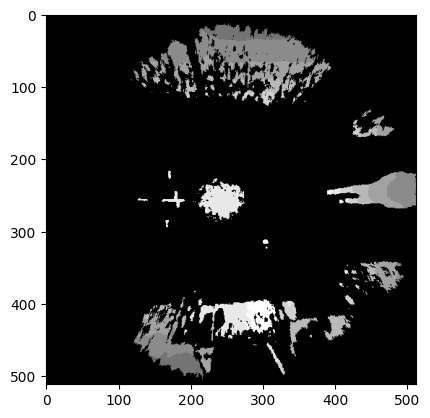

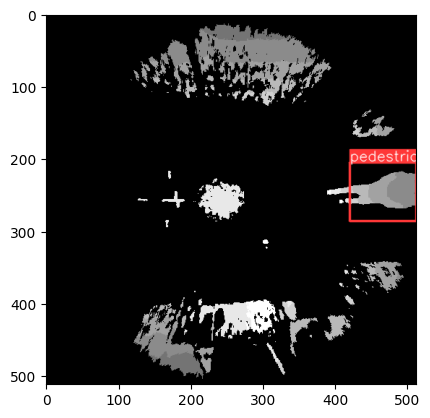


0: 640x640 (no detections), 12.3ms
Speed: 3.2ms preprocess, 12.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)


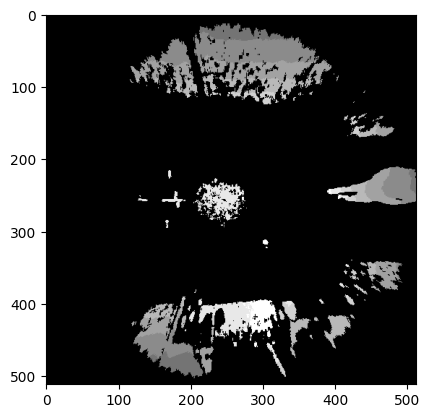


0: 640x640 1 pedestrians-cg9U, 12.9ms
Speed: 6.1ms preprocess, 12.9ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


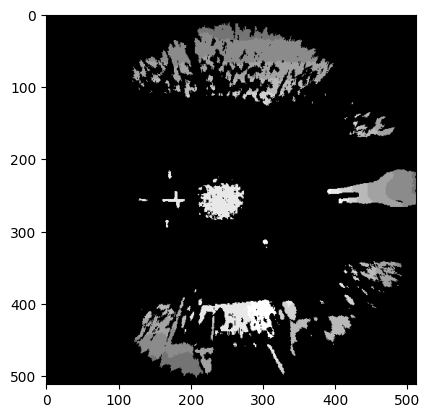

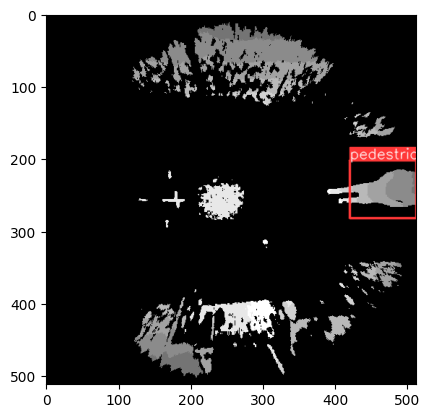


0: 640x640 1 pedestrians-cg9U, 17.0ms
Speed: 3.3ms preprocess, 17.0ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


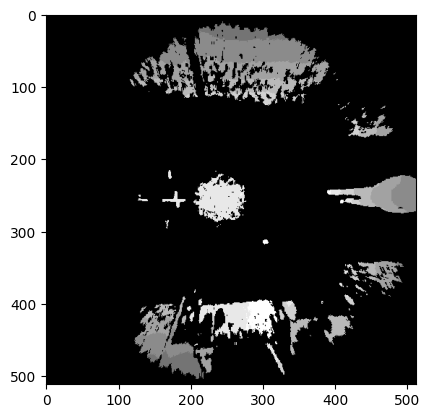

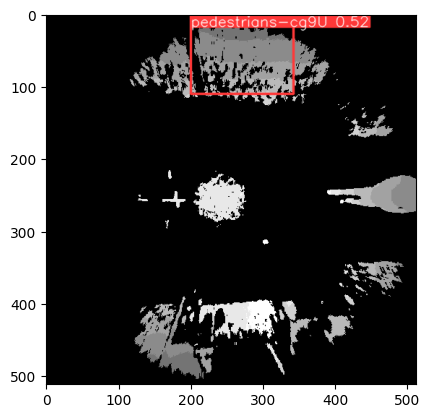


0: 640x640 (no detections), 11.7ms
Speed: 3.4ms preprocess, 11.7ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


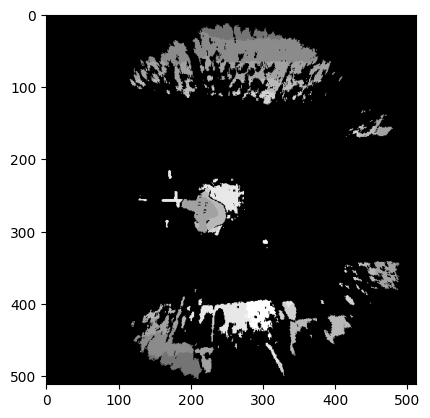


0: 640x640 (no detections), 9.0ms
Speed: 3.3ms preprocess, 9.0ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


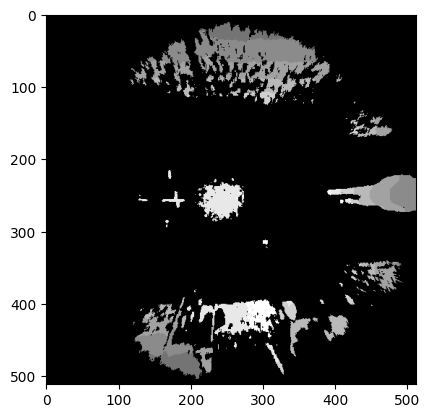


0: 640x640 1 pedestrians-cg9U, 8.9ms
Speed: 4.1ms preprocess, 8.9ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


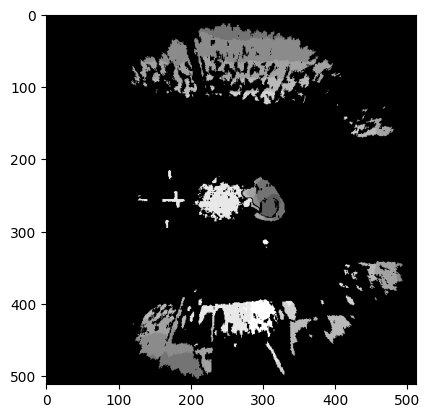

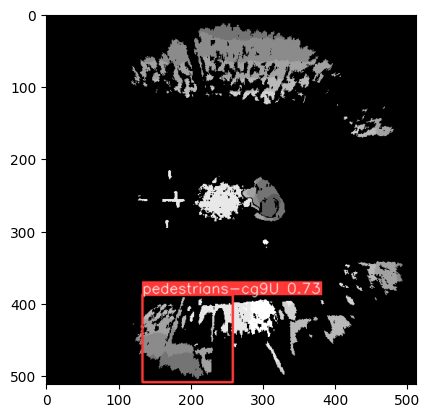


0: 640x640 1 pedestrians-cg9U, 11.2ms
Speed: 3.4ms preprocess, 11.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


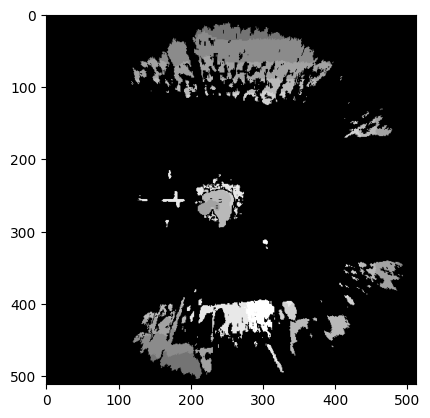

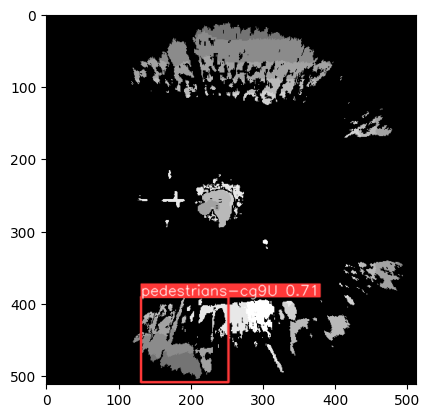


0: 640x640 (no detections), 9.4ms
Speed: 3.4ms preprocess, 9.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


KeyboardInterrupt: 

In [ ]:
import glob

# Load ToF image
images_normalized = []

# Julie Path
for filename in glob.glob('/content/drive/MyDrive/PerceptionAI/data/test_1/*.png'):
    # Load and normalize the image
    frame = cv2.imread(filename)
    img_normalized = cv2.normalize(frame, None, 0, 255, cv2.NORM_MINMAX, dtype=cv2.CV_8U)
    images_normalized.append(img_normalized)

# Perform prediction on each normalized image
for img_normalized in images_normalized:
    # Placeholder for the actual prediction logic, adjust this according to your YOLO model's usage
    results = results.predict(img_normalized, conf=0.5)

    # Display the normalized image
    plt.imshow(cv2.cvtColor(img_normalized, cv2.COLOR_BGR2RGB))
    plt.show()

    # Display the results of the prediction (if there are any)
    if len(results) > 0:
        for r in results:
            res_plotted = results[0].plot()
            box = r.boxes.cpu()
            box_sz = box.xyxy.numpy()
            if box_sz.size != 0:
                plt.imshow(cv2.cvtColor(res_plotted, cv2.COLOR_BGR2RGB))
                plt.show()
                break

Autres essais

In [ ]:
import os

# Chemin du répertoire contenant les images
images_directory = '/content/drive/MyDrive/PerceptionAI/data/test_1/'

# Liste de tous les fichiers dans le répertoire
image_files = [f for f in os.listdir(images_directory) if os.path.isfile(os.path.join(images_directory, f))]

# Tri des fichiers pour garantir l'ordre d'acquisition
image_files.sort()

# On lit chaque image du répertoire
for image_file in image_files:
    image_path = os.path.join(images_directory, image_file)
    frame = cv2.imread(image_path)

    # Vous pouvez ajouter ici le changement de taille de l'image si nécessaire

    results = model.predict(frame, conf=0.5)  # prédiction sur une image

    if len(results) > 0:
        for r in results:
            res_plotted = results[0].plot()
            box = r.boxes.cpu()
            box_sz = box.xyxy.numpy()
            if box_sz.size != 0:
                cv2_imshow(res_plotted)
                break

    c = cv2.waitKey(1)
    if c == 27:
        break


0: 640x640 (no detections), 28.9ms
Speed: 7.8ms preprocess, 28.9ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 18.8ms
Speed: 6.3ms preprocess, 18.8ms inference, 2.9ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 35.3ms
Speed: 10.1ms preprocess, 35.3ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 39.3ms
Speed: 3.6ms preprocess, 39.3ms inference, 0.9ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 28.5ms
Speed: 3.5ms preprocess, 28.5ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 25.2ms
Speed: 10.4ms preprocess, 25.2ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 20.4ms
Speed: 11.4ms preprocess, 20.4ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 (no detections), 30.4ms
Speed: 3.6ms preprocess, 30.4m